In [1]:
# reload packages
%load_ext autoreload
%autoreload 2`

### Choose GPU

In [2]:
%env CUDA_DEVICE_ORDER=PCI_BUS_ID
%env CUDA_VISIBLE_DEVICES=1

env: CUDA_DEVICE_ORDER=PCI_BUS_ID
env: CUDA_VISIBLE_DEVICES=1


In [3]:
import tensorflow as tf
gpu_devices = tf.config.experimental.list_physical_devices('GPU')
if len(gpu_devices)>0:
    tf.config.experimental.set_memory_growth(gpu_devices[0], True)
print(gpu_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
tf.keras.backend.clear_session()

### dataset information

In [5]:
from datetime import datetime

dataset = "mnist"
dims = (28, 28, 1)
umap_prop = 1.0
num_classes = 10
PROJECTION_DIMS = 1024
labels_per_class = 1  # 'full'
datestring = datetime.now().strftime("%Y_%m_%d_%H_%M_%S_%f")
datestring = (
    str(dataset)
    + "_"
    + str(umap_prop)
    + "_"
    + str(PROJECTION_DIMS)
    + "_"
    + str(labels_per_class)
    + "____"
    + datestring
    + '__linear-umap-euclidean'
)
print(datestring)

mnist_1.0_1024_1____2020_08_07_23_09_37_333552__linear-umap-euclidean


### Load packages

In [6]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
from IPython import display
import pandas as pd
import umap
import copy
import os, tempfile

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


### Load dataset

In [7]:
from tfumap.load_datasets import load_MNIST, mask_labels

In [8]:
X_train, X_test, X_valid, Y_train, Y_test, Y_valid = load_MNIST(flatten=False)
X_train.shape

(50000, 28, 28, 1)

In [9]:
if labels_per_class == "full":
    X_labeled = X_train
    Y_masked = Y_labeled = Y_train
else:
    X_labeled, Y_labeled, Y_masked = mask_labels(
        X_train, Y_train, labels_per_class=labels_per_class
    )

### Build umap graph

In [10]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [11]:
n_neighbors = 15  # default = 15
umap_graph = build_fuzzy_simplicial_set(
    X_train.reshape((len(X_train), np.product(np.shape(X_train)[1:]))),
    y=Y_masked,
    n_neighbors=n_neighbors,
)

### Build data iterators

In [12]:
from tfumap.umap import compute_cross_entropy, get_graph_elements
from tfumap.semisupervised import create_edge_iterator, create_validation_iterator, create_classification_iterator

In [13]:
n_epochs = 200
graph, epochs_per_sample, head, tail, weight, n_vertices = get_graph_elements(
            umap_graph, n_epochs
)
batch_size = np.min([n_vertices, 1000])
batch_size

1000

In [14]:
# make sure batch size is no bigger than the number of labels per class
labeled_batch_size = batch_size if batch_size < len(Y_labeled) else len(Y_labeled)
labeled_iter = create_classification_iterator(X_labeled, Y_labeled, batch_size=batch_size)
print(labeled_batch_size)

10


In [15]:
max_sample_repeats_per_epoch = 25
edge_iter, n_edges_per_epoch = create_edge_iterator(
    head,
    tail,
    weight,
    batch_size=batch_size,
    max_sample_repeats_per_epoch=max_sample_repeats_per_epoch,
)

In [16]:
data_valid, n_valid_samp = create_validation_iterator(X_valid, Y_valid, batch_size, repeat=True)

### Build network

In [17]:
encoder = tf.keras.Sequential()
encoder.add(tf.keras.layers.InputLayer(input_shape=dims))
encoder.add(tf.keras.layers.Conv2D(
    filters=32, kernel_size=3, strides=1, padding="same", activation="relu"
))
encoder.add(tf.keras.layers.Conv2D(
    filters=64, kernel_size=3, strides=1, padding="same", activation="relu"
))
encoder.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
encoder.add(tf.keras.layers.Dropout(0.25))
encoder.add(tf.keras.layers.Flatten())
encoder.add(tf.keras.layers.Dense(units=128, activation="relu"))
encoder.add(tf.keras.layers.Dropout(0.25))

In [18]:
classifier = tf.keras.Sequential()
classifier.add(tf.keras.layers.InputLayer(input_shape=128))
classifier.add(tf.keras.layers.Dense(units=128, activation="relu"))
classifier.add(tf.keras.layers.Dense(units=128, activation="relu"))
classifier.add(tf.keras.layers.Dense(num_classes, activation='softmax', name="predictions"))

In [19]:
encoder.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 28, 28, 32)        320       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 28, 28, 64)        18496     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 14, 14, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 14, 14, 64)        0         
_________________________________________________________________
flatten (Flatten)            (None, 12544)             0         
_________________________________________________________________
dense (Dense)                (None, 128)               1605760   
_________________________________________________________________
dropout_1 (Dropout)          (None, 128)               0

### Create UMAP object

In [20]:
from tfumap.semisupervised_model import PUMAP, compute_classifier_loss

In [21]:
def compute_umap_loss(
    batch_to,
    batch_from,
    encoder,
    _a,
    _b,
    negative_sample_rate=5,
    repulsion_strength=1,
):
    """
        compute the cross entropy loss for learning embeddings

        Parameters
        ----------
        batch_to : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (to)
        batch_from : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (from)

        Returns
        -------
        ce_loss : tf.float
            cross entropy loss for UMAP
        embedding_to : tf.float
            embeddings for verticies (to)
        embedding_from : tf.float
            embeddings for verticies (from)
        """

    # encode
    embedding_to = encoder(batch_to)
    embedding_from = encoder(batch_from)

    # get negative samples
    embedding_neg_to = tf.repeat(embedding_to, negative_sample_rate, axis=0)
    repeat_neg = tf.repeat(embedding_from, negative_sample_rate, axis=0)
    embedding_neg_from = tf.gather(
        repeat_neg, tf.random.shuffle(tf.range(tf.shape(repeat_neg)[0]))
    )

    #  distances between samples
    distance_embedding = tf.concat(
        [
            tf.norm(embedding_to - embedding_from, axis=1),
            tf.norm(embedding_neg_to - embedding_neg_from, axis=1),
        ],
        axis=0,
    )

    # convert probabilities to distances
    probabilities_distance = convert_distance_to_probability(distance_embedding, _a, _b)

    # treat positive samples as p=1, and negative samples as p=0
    probabilities_graph = tf.concat(
        [tf.ones(embedding_to.shape[0]), tf.zeros(embedding_neg_to.shape[0])], axis=0,
    )

    # cross entropy loss
    (attraction_loss, repellant_loss, ce_loss) = compute_cross_entropy(
        probabilities_graph,
        probabilities_distance,
        repulsion_strength=repulsion_strength,
    )

    return (
        attraction_loss,
        repellant_loss,
        ce_loss,
    )


In [22]:
import tensorflow as tf
from tfumap.umap import compute_cross_entropy, convert_distance_to_probability
from tfumap.semisupervised import (
    find_a_b,
    #compute_umap_loss,
    # compute_classifier_loss,
    batch_data,
)
import numpy as np
import os, tempfile
from tqdm.autonotebook import tqdm
from datetime import datetime


@tf.function
def compute_classifier_loss(X, y, encoder, classifier, sparse_ce, acc_func):
    """ compute the cross entropy loss for classification
        """
    d = classifier(encoder(X))
    loss = sparse_ce(y, d)
    acc = acc_func(y, d)
    #acc = tf.keras.metrics.sparse_categorical_accuracy(y, d)
    return loss, acc


class PUMAP(tf.keras.Model):
    def __init__(
        self,
        encoder,
        classifier,
        tensorboard_logdir=None,  # directory for tensorboard log
        min_dist=0.1,
        negative_sample_rate=5.0,
        optimizer=tf.keras.optimizers.SGD(0.1),
        repulsion_strength=1.0,
        # ** kwargs,
    ):
        super(PUMAP, self).__init__()
        # self.__dict__.update(kwargs)

        # subnetworks
        self.encoder = encoder
        self.classifier = classifier


        # optimizer for cross entropy minimization
        self.optimizer = optimizer
        self.repulsion_strength = repulsion_strength
        self.negative_sample_rate = negative_sample_rate

        # get a,b for current min_dist
        self._a, self._b = find_a_b(min_dist)

        # create summary writer to log loss information during training
        if tensorboard_logdir is None:
            self.tensorboard_logdir = os.path.join(
                tempfile.gettempdir(),
                "tensorboard",
                datetime.now().strftime("%Y%m%d-%H%M%S"),
            )
        else:
            self.tensorboard_logdir = tensorboard_logdir
        self.summary_writer_train = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/train"
        )
        self.summary_writer_valid = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/valid"
        )

        # sparse categorical cross entropy
        self.sparse_ce = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
        self.class_acc = tf.keras.metrics.SparseCategoricalAccuracy()
        self.class_acc_val = tf.keras.metrics.SparseCategoricalAccuracy()

        # self.create_summary_metrics()

    @tf.function
    def train(self, batch_to, batch_from, X, y, umap_prop = 1.0, save_loss=False):
        """ One training step 
        Input are points and weights for positive and negative 
        samples for training. 
            
        """
        if umap_prop > 0:
            with tf.GradientTape() as tape:

                (attraction_loss, repellant_loss, umap_loss) = compute_umap_loss(
                    batch_to,
                    batch_from,
                    self.encoder,
                    self._a,
                    self._b,
                    self.negative_sample_rate,
                    self.repulsion_strength,
                )
            
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = (
                    tf.reduce_mean(classifier_loss)
                    + tf.reduce_mean(umap_loss) * umap_prop
                )

            train_vars = (
                self.encoder.trainable_variables
                + self.classifier.trainable_variables
            )
        else:  # ignore running costly UMAP computations if not training on UMAP loss
            with tf.GradientTape() as tape:
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = classifier_loss
            train_vars = (
                self.encoder.trainable_variables + self.classifier.trainable_variables
            )
            attraction_loss = repellant_loss = umap_loss = 0

        # compute gradient for umap
        grad = tape.gradient(loss, train_vars)

        # gradients are cliped in UMAP implementation. Any effect here?
        grad = [tf.clip_by_value(grad, -4.0, 4.0) for grad in grad]

        self.optimizer.apply_gradients(zip(grad, train_vars))

        return (
            attraction_loss,
            repellant_loss,
            tf.reduce_mean(umap_loss),
            classifier_loss,
            classifier_acc,
        )

    @tf.function
    def write_losses(
        self,
        step,
        classifier_acc,
        classifier_loss,
        umap_loss,
        classifier_loss_val,
        classifier_acc_val,
    ):
        # write train loss
        with self.summary_writer_train.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss, step=step,
            )
            tf.summary.scalar(
                "umap_loss", umap_loss, step=step,
            )
            self.summary_writer_train.flush()
        # write valid loss
        with self.summary_writer_valid.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc_val, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss_val, step=step,
            )
            self.summary_writer_valid.flush()



In [23]:
### Initialize model
model = PUMAP(
    min_dist = 0.0,
    negative_sample_rate = 5, # how many negative samples per positive
    optimizer=tf.keras.optimizers.Adam(1e-3), # cross-entropy optimizer
    encoder=encoder,
    classifier=classifier,    
)

### plotting results

In [24]:
def model_data(X, batch_size, model):
    """ embed a set of points in X to Z
    """
    n_batch = int(np.ceil(len(X) / batch_size))
    return np.vstack(
        [
                model(np.array(X[(i) * batch_size : (i + 1) * batch_size, :]))
            for i in tqdm(range(n_batch), leave=False)
        ]
    )

In [25]:
from tfumap.umap import retrieve_tensors
from sklearn.decomposition import PCA
import seaborn as sns
from umap import UMAP 

def plot_umap_classif_results(
    model,
    X_valid,
    Y_valid,
    X_train,
    X_labeled,
    Y_labeled,
    batch_size,
    dralg = PCA, #umap
    cmap="coolwarm",
    cmap2="bwr",
):
    # get loss dataframe from tensorboard
    try:
        loss_df = retrieve_tensors(model.tensorboard_logdir)
        losses_exist = True
    except ValueError as e:
        print(e)
        losses_exist = False

    pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

    # embed data
    enc_valid = model_data(X_valid, batch_size, model.encoder)
    class_valid = model_data(enc_valid, batch_size, pred_model)
    pred_valid = model_data(enc_valid, batch_size, model.classifier)

    enc_lab = model_data(X_labeled, batch_size, model.encoder)
    class_lab = model_data(enc_lab, batch_size, pred_model)
    pred_lab = model_data(enc_lab, batch_size, model.classifier)

    # get classifications and correctness
    classifications_valid = np.argmax(pred_valid, axis=1)
    correctness_valid = classifications_valid == Y_valid

    classifications_lab = np.argmax(pred_lab, axis=1)
    correctness_lab = classifications_lab == np.array(Y_labeled)

    confidence_lab  = np.max(pred_lab, axis=1)
    confidence_valid = np.max(pred_valid, axis=1)

    thresh = 0.0 #0.8
    mask_valid = confidence_valid > thresh
    mask_lab = confidence_lab > thresh

    # embed into 2D 
    dr = dralg()
    enc_valid_2 = dr.fit_transform(enc_valid[mask_valid])
    enc_lab_2 = dr.transform(enc_lab[mask_lab])



    dr = dralg()
    class_valid_2 = dr.fit_transform(class_valid[mask_valid])
    class_lab_2 = dr.transform(class_lab[mask_lab])
    
    fig, axs = plt.subplots(ncols=4, nrows=2, figsize=(14, 6), gridspec_kw = {'wspace':0, 'hspace':0})
    for row, (z_val, z_lab, z_title) in enumerate([
        [enc_valid_2, enc_lab_2, 'encoder'], 
        [class_valid_2, class_lab_2, 'last_layer_classifier'], 

    ]):
        for col, (y_valid, y_labeled, label_name) in enumerate([
            [Y_valid, Y_labeled, 'ground_truth'],
            [classifications_valid, classifications_lab, 'predictions'],
            [correctness_valid, correctness_lab, 'correctness'],
            [confidence_valid, confidence_lab, 'confidence'],
        ]):
            ax = axs[row, col]
            #ax.axis('off')
            if col == 0:
                ax.set_ylabel(z_title)
            if row == 0:
                ax.set_title(label_name)
            #ax.set_title(z_title + '_' + label_name)
            ax.scatter(
                z_val[:, 0],
                z_val[:, 1],
                c=y_valid[mask_valid],
                cmap=cmap if label_name not in ["correctness", "confidence"]  else 'viridis',  # "tab10"
                s=2,
                alpha=0.25,
                rasterized=True,
            )
            if False:
                ax.scatter(
                    z_lab[:, 0],
                    z_lab[:, 1],
                    c=y_labeled[mask_lab],
                    cmap=cmap if label_name not in ["correctness", "confidence"] else 'viridis',  # "tab10"
                    s=20,
                    alpha=0.25,
                    rasterized=True,
                )
            ax.set_xticks([])
            ax.set_yticks([])
        
    plt.show()
    
    fig, axs = plt.subplots(ncols=3, figsize=(14,2))
    if losses_exist:
        ax = axs[0]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "umap_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.legend(loc="upper right")
        ax.set_xscale("log")
        ax.set_title("UMAP loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[1]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="upper right")
        # ax.set_yscale("log")
        ax.set_title("Classif loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[2]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_acc"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="lower right")
        ax.set_title("Classif acc", fontsize=24)
        ax.set_ylabel("Acc")
    plt.show()

No objects to concatenate


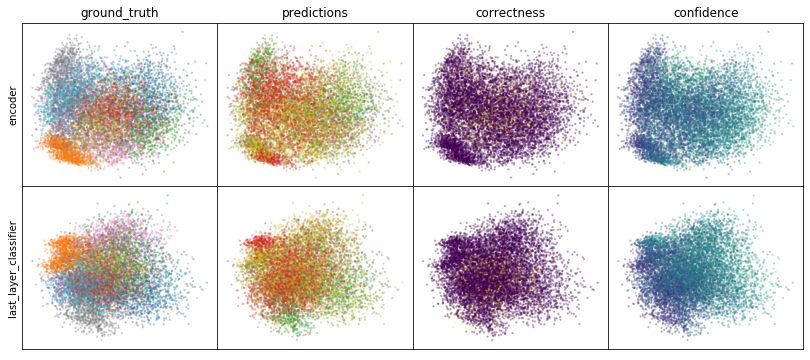

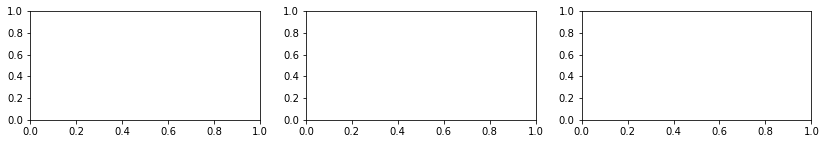

In [26]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=PCA, cmap='tab10', cmap2='tab10')

### Train model

In [27]:
N_EPOCHS = 50
n_neighbors=15
batch_size = 256 # 500
max_sample_repeats_per_epoch = 25
max_save_delta = 0.005

In [28]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [29]:
from tfumap.paths import MODEL_DIR

In [30]:
# where to save checkpoints
cpt_path = MODEL_DIR / 'semisupervised' / dataset / datestring

In [31]:
BATCHES_PER_EPOCH = int(n_edges_per_epoch / batch_size)

In [32]:
patience = 10000 # wait this many batches without improvement before early stopping
min_delta = 0.0001 # threshold for what counts as an improvement
best_acc = 0 # the best current accuracy score
best_saved_acc = 0 # best accuracy on valid data that has been checkpointed
best_saved_batch = 0 # batch number for last good batch
max_reinitialize_delta = .01 # minimum loss in accuracy resulting in reinitialized weights
plot_frequency = 1000 # how frequently to plot
max_reloads = 10 # how often can we reload weights?
batch = 0; epoch = 0
batches_since_last_reload = 0

In [33]:
epochs_without_improvement = 0
max_epochs_without_improvement = 5 # allow the network 
reload_tolerance = 100 # allow the network at least reload_tolerance batches before reloading last weights

In [34]:
n_reloads = 0

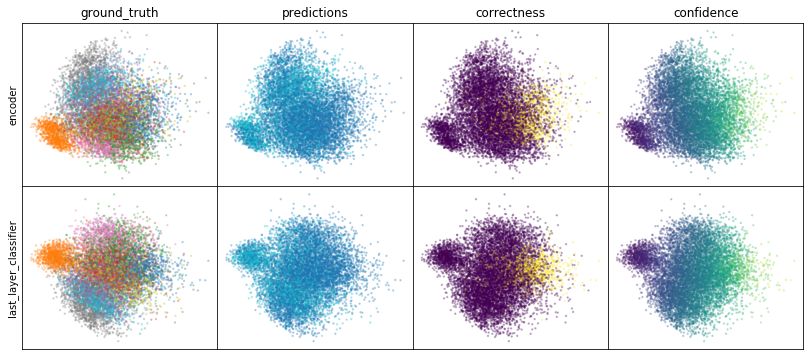

W0807 23:10:43.391296 140558110111488 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:118: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:132: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0807 23:10:43.448327 140558110111488 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:148: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0807 23:10:43.503694 140558110111488 legend.py:1282] No handles with labels found to put in legend.


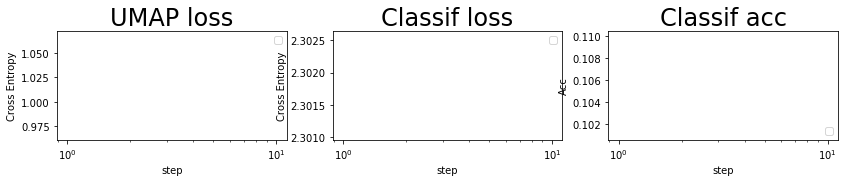

batch: 0 | train acc: 0.101 | val acc: 0.11
saving weights | batch = 100 | acc = 49.877
saving weights | batch = 131 | acc = 50.392
saving weights | batch = 142 | acc = 50.894
saving weights | batch = 153 | acc = 51.451
saving weights | batch = 164 | acc = 51.976
saving weights | batch = 175 | acc = 52.513
saving weights | batch = 188 | acc = 53.081
saving weights | batch = 199 | acc = 53.586
saving weights | batch = 213 | acc = 54.106
saving weights | batch = 228 | acc = 54.63
saving weights | batch = 244 | acc = 55.152
saving weights | batch = 261 | acc = 55.668
saving weights | batch = 279 | acc = 56.211
saving weights | batch = 299 | acc = 56.748
saving weights | batch = 321 | acc = 57.258
saving weights | batch = 343 | acc = 57.763
saving weights | batch = 365 | acc = 58.279
saving weights | batch = 389 | acc = 58.795
saving weights | batch = 414 | acc = 59.303
saving weights | batch = 439 | acc = 59.805
saving weights | batch = 467 | acc = 60.314
saving weights | batch = 494 | ac

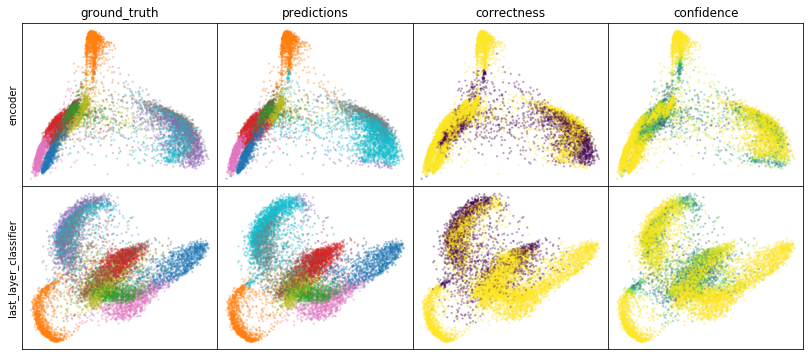

W0807 23:15:11.103346 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:15:11.162558 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:15:11.222657 140558110111488 legend.py:1282] No handles with labels found to put in legend.


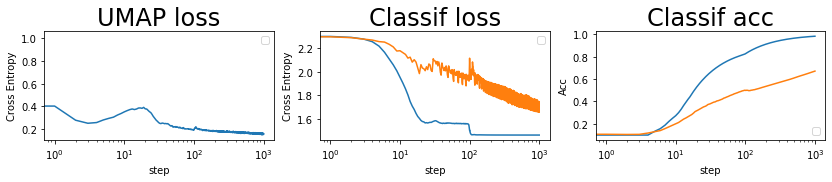

batch: 1000 | train acc: 0.9824 | val acc: 0.671
saving weights | batch = 1034 | acc = 67.39
saving weights | batch = 1094 | acc = 67.891
saving weights | batch = 1159 | acc = 68.396
saving weights | batch = 1229 | acc = 68.905
saving weights | batch = 1299 | acc = 69.405
saving weights | batch = 1374 | acc = 69.907
saving weights | batch = 1454 | acc = 70.409
saving weights | batch = 1538 | acc = 70.91
saving weights | batch = 1628 | acc = 71.414
saving weights | batch = 1726 | acc = 71.914
saving weights | batch = 1829 | acc = 72.415
saving weights | batch = 1937 | acc = 72.915


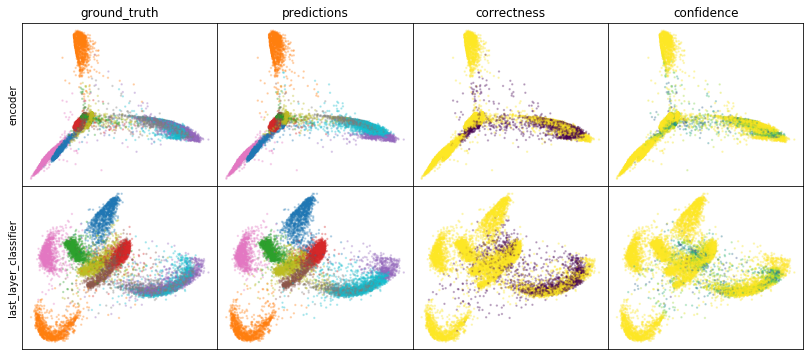

W0807 23:19:36.487211 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:19:36.552174 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:19:36.613528 140558110111488 legend.py:1282] No handles with labels found to put in legend.


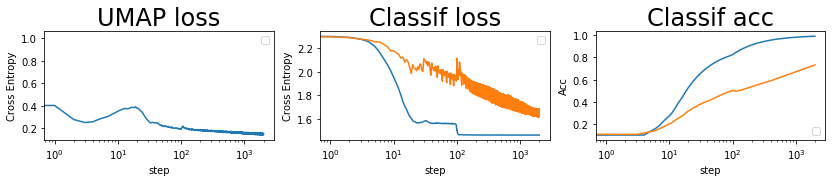

batch: 2000 | train acc: 0.9912 | val acc: 0.7318
saving weights | batch = 2056 | acc = 73.416
saving weights | batch = 2185 | acc = 73.92
saving weights | batch = 2325 | acc = 74.422
saving weights | batch = 2474 | acc = 74.922
saving weights | batch = 2641 | acc = 75.422
saving weights | batch = 2821 | acc = 75.924


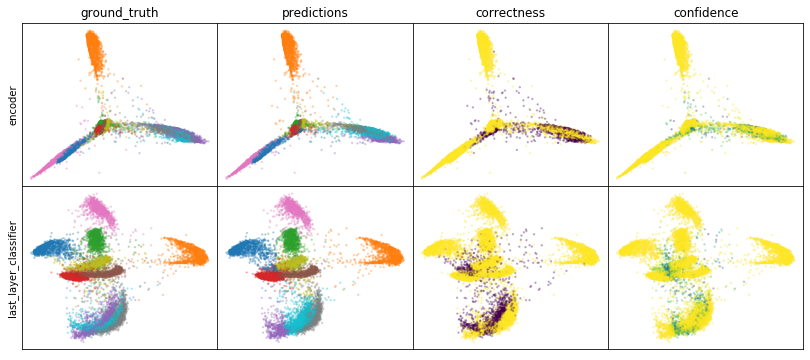

W0807 23:24:01.322089 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:24:01.387804 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:24:01.459490 140558110111488 legend.py:1282] No handles with labels found to put in legend.


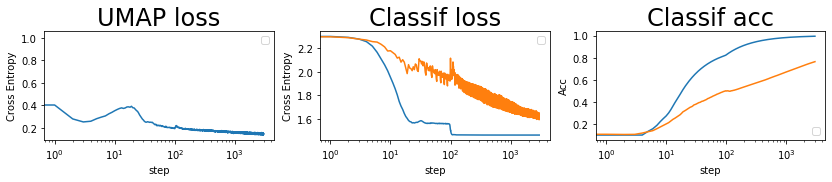

batch: 3000 | train acc: 0.9941 | val acc: 0.764
saving weights | batch = 3008 | acc = 76.425
saving weights | batch = 3206 | acc = 76.926
saving weights | batch = 3423 | acc = 77.428
saving weights | batch = 3664 | acc = 77.929
saving weights | batch = 3932 | acc = 78.429


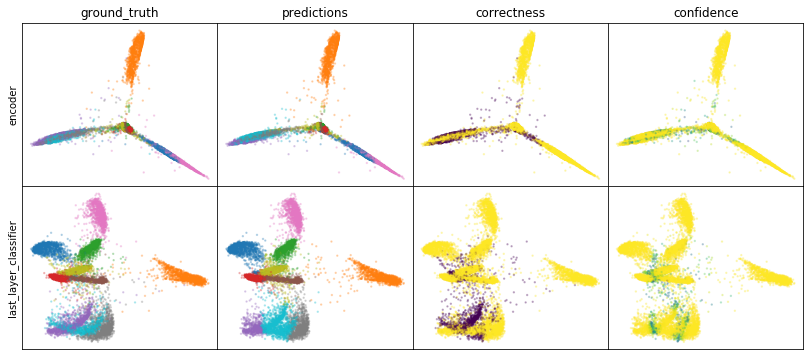

W0807 23:28:26.440628 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:28:26.507782 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:28:26.575334 140558110111488 legend.py:1282] No handles with labels found to put in legend.


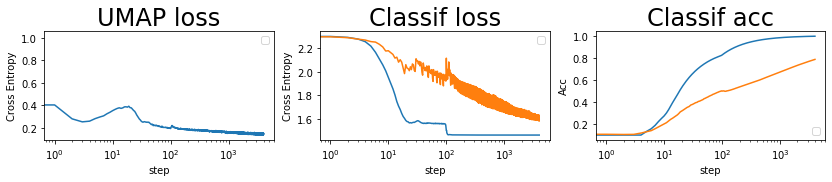

batch: 4000 | train acc: 0.9956 | val acc: 0.7856
saving weights | batch = 4202 | acc = 78.929
saving weights | batch = 4522 | acc = 79.43
saving weights | batch = 4882 | acc = 79.93


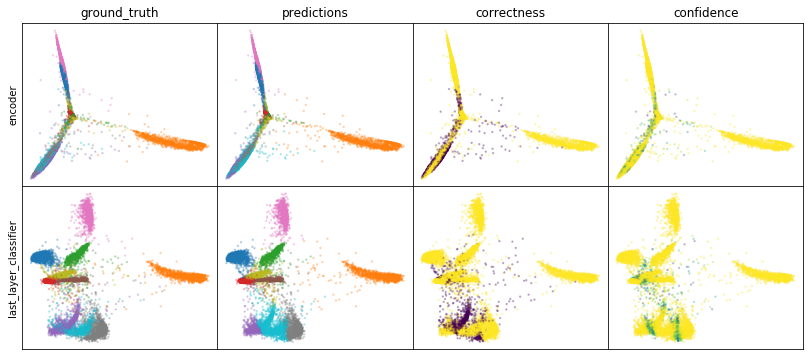

W0807 23:32:52.199257 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:32:52.269985 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:32:52.339809 140558110111488 legend.py:1282] No handles with labels found to put in legend.


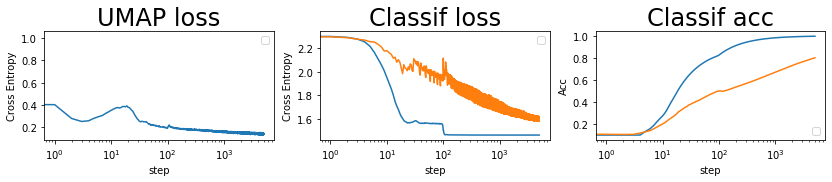

batch: 5000 | train acc: 0.9965 | val acc: 0.8008
saving weights | batch = 5272 | acc = 80.431
saving weights | batch = 5696 | acc = 80.932


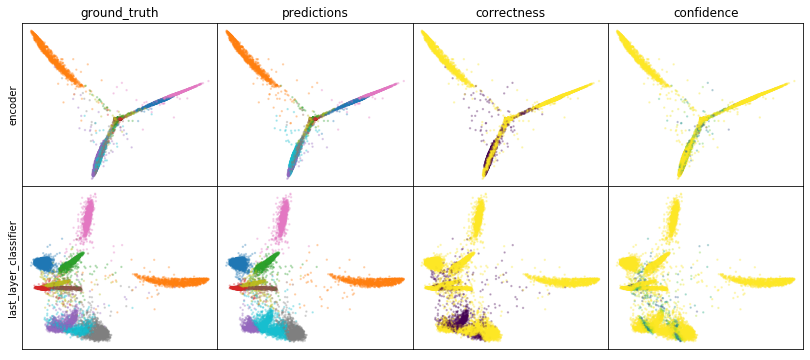

W0807 23:37:17.999269 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:37:18.073775 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:37:18.147171 140558110111488 legend.py:1282] No handles with labels found to put in legend.


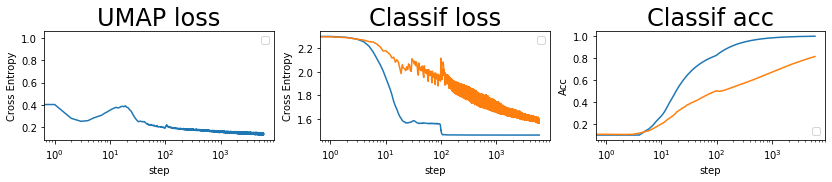

batch: 6000 | train acc: 0.9971 | val acc: 0.8128
saving weights | batch = 6143 | acc = 81.432
saving weights | batch = 6631 | acc = 81.933


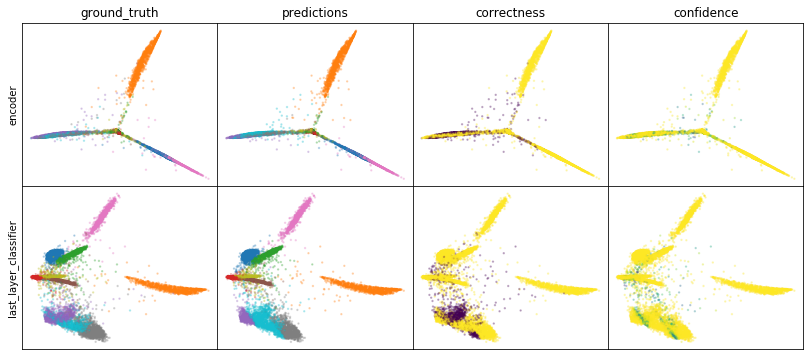

W0807 23:41:44.686861 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:41:44.763421 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:41:44.839980 140558110111488 legend.py:1282] No handles with labels found to put in legend.


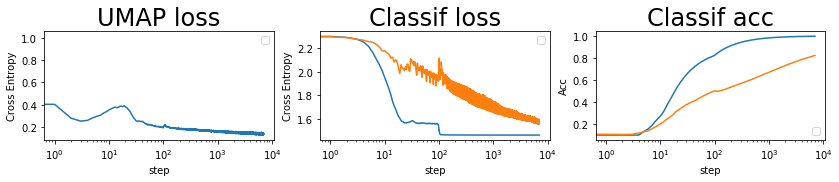

batch: 7000 | train acc: 0.9975 | val acc: 0.8229
saving weights | batch = 7161 | acc = 82.434
saving weights | batch = 7776 | acc = 82.934


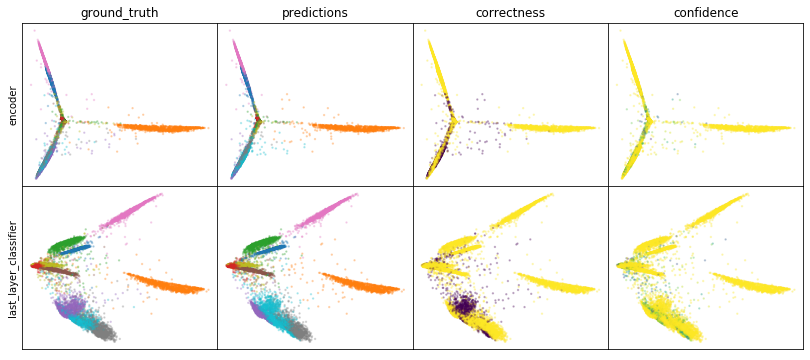

W0807 23:46:11.421202 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:46:11.499683 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:46:11.581802 140558110111488 legend.py:1282] No handles with labels found to put in legend.


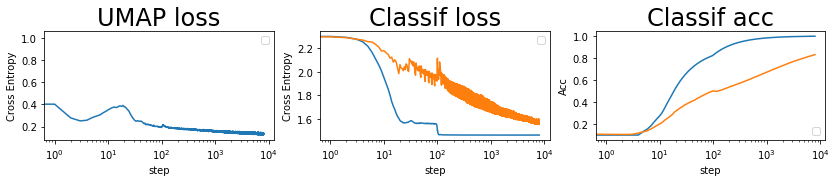

batch: 8000 | train acc: 0.9978 | val acc: 0.8309
saving weights | batch = 8479 | acc = 83.434


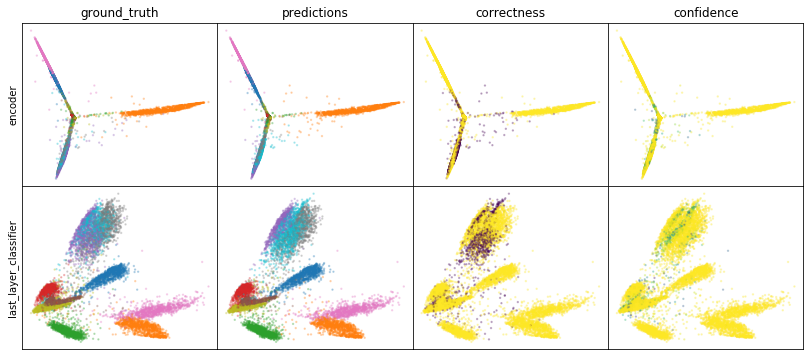

W0807 23:50:41.687691 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:50:41.767484 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:50:41.842088 140558110111488 legend.py:1282] No handles with labels found to put in legend.


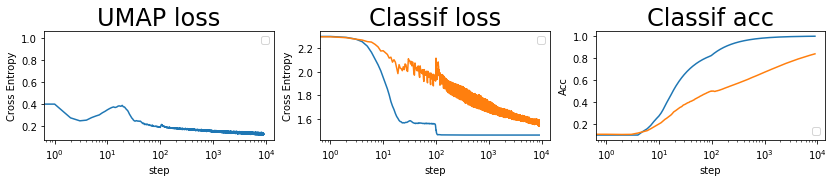

batch: 9000 | train acc: 0.998 | val acc: 0.8381
saving weights | batch = 9182 | acc = 83.934


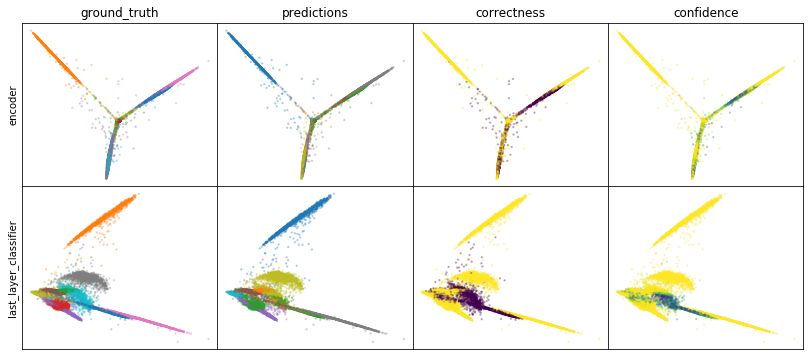

W0807 23:55:09.617599 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:55:09.701708 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:55:09.784800 140558110111488 legend.py:1282] No handles with labels found to put in legend.


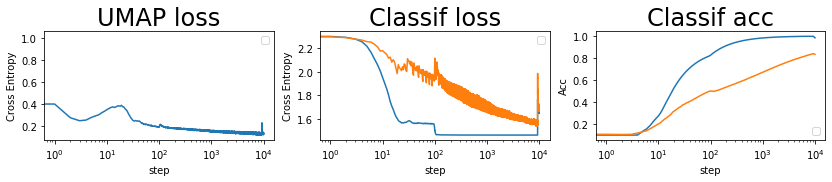

batch: 10000 | train acc: 0.9836 | val acc: 0.8335
batch 10734 | acc = 0.829 | learn rate = 0.0010000000474974513 | reloading weights from batch 9182 at acc 83 | n reloads = 0


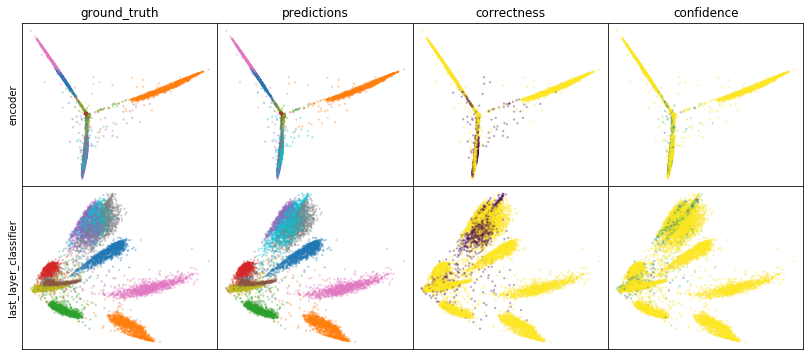

W0807 23:59:37.219792 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:59:37.307530 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0807 23:59:37.393422 140558110111488 legend.py:1282] No handles with labels found to put in legend.


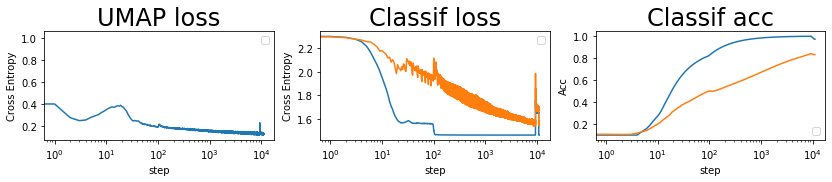

batch: 11000 | train acc: 0.9718 | val acc: 0.831


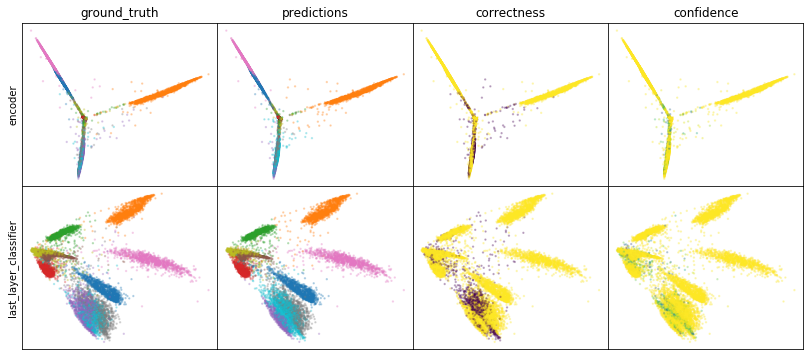

W0808 00:04:06.553104 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:04:06.642598 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:04:06.733517 140558110111488 legend.py:1282] No handles with labels found to put in legend.


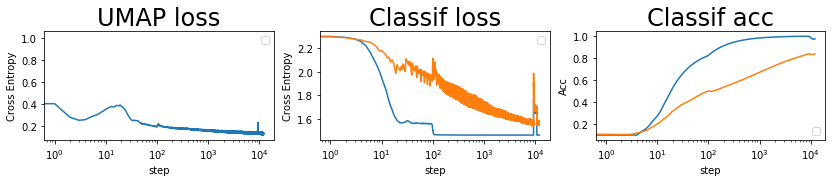

batch: 12000 | train acc: 0.9741 | val acc: 0.8369


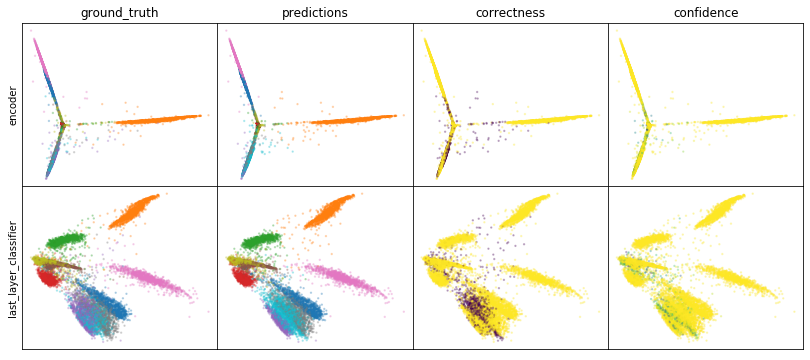

W0808 00:08:35.375141 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:08:35.467950 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:08:35.570015 140558110111488 legend.py:1282] No handles with labels found to put in legend.


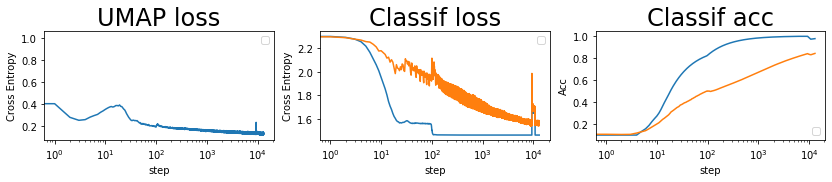

batch: 13000 | train acc: 0.9761 | val acc: 0.8418
saving weights | batch = 13562 | acc = 84.434


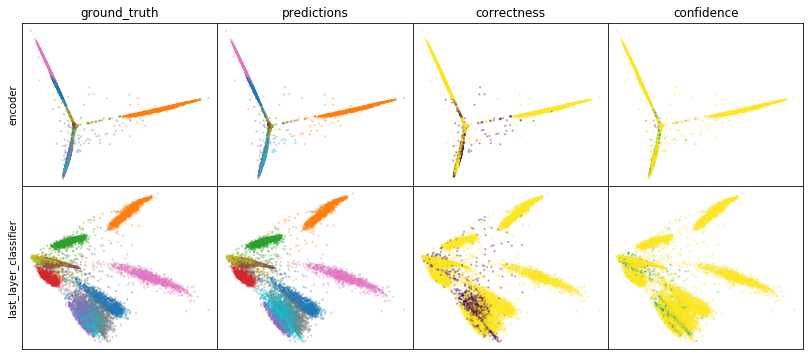

W0808 00:13:05.096437 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:13:05.195936 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:13:05.292892 140558110111488 legend.py:1282] No handles with labels found to put in legend.


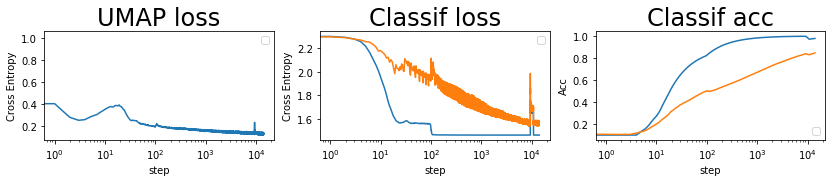

batch: 14000 | train acc: 0.9778 | val acc: 0.8461
saving weights | batch = 14844 | acc = 84.934


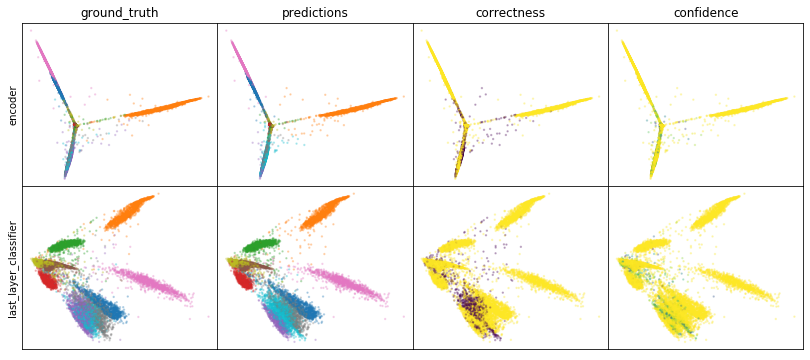

W0808 00:17:34.424405 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:17:34.525249 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:17:34.635926 140558110111488 legend.py:1282] No handles with labels found to put in legend.


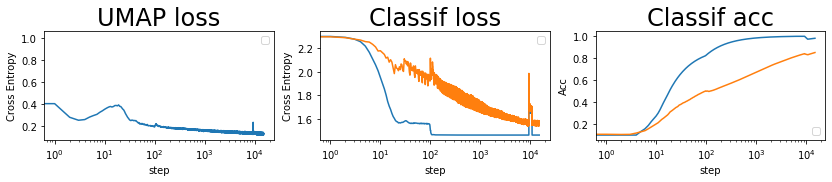

batch: 15000 | train acc: 0.9793 | val acc: 0.8499


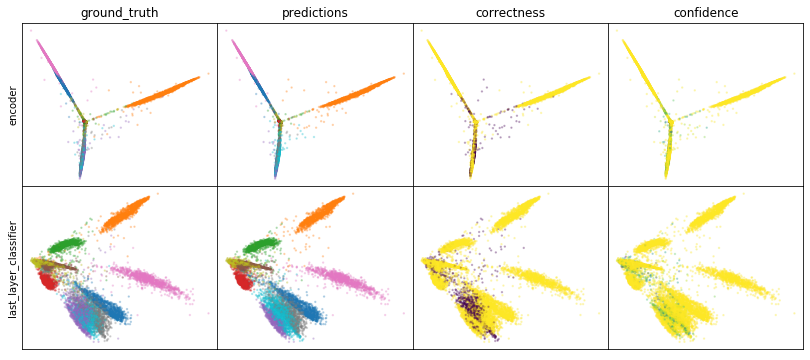

W0808 00:22:03.833516 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:22:03.944539 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:22:04.044395 140558110111488 legend.py:1282] No handles with labels found to put in legend.


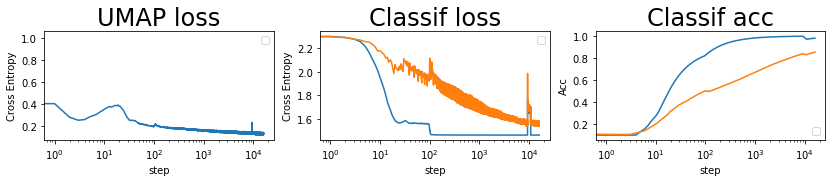

batch: 16000 | train acc: 0.9806 | val acc: 0.8533
saving weights | batch = 16349 | acc = 85.434


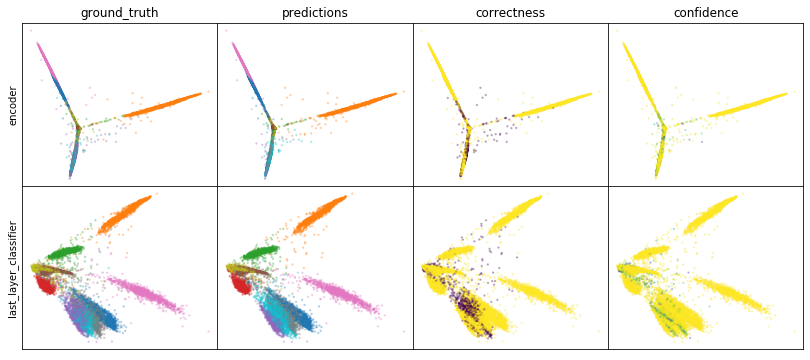

W0808 00:26:33.783086 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:26:33.882708 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:26:33.983427 140558110111488 legend.py:1282] No handles with labels found to put in legend.


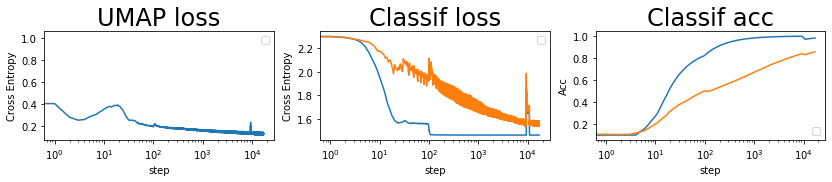

batch: 17000 | train acc: 0.9817 | val acc: 0.8562


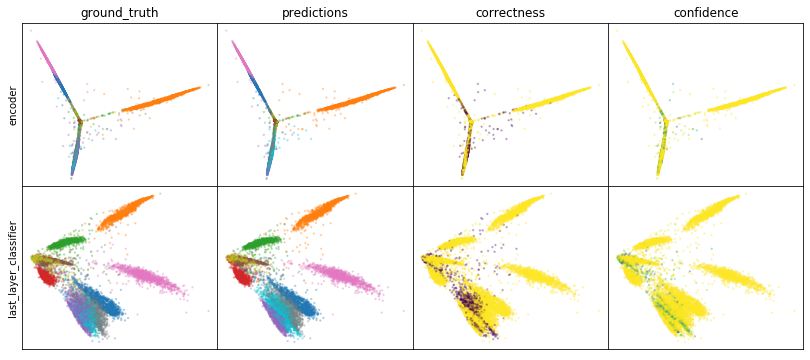

W0808 00:31:05.245174 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:31:05.349025 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:31:05.451960 140558110111488 legend.py:1282] No handles with labels found to put in legend.


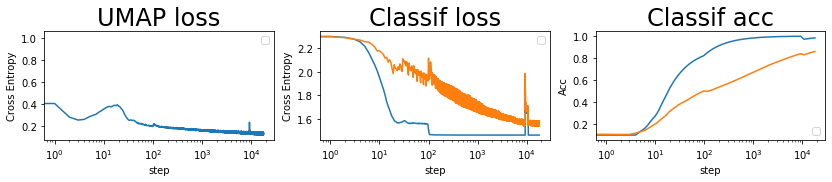

batch: 18000 | train acc: 0.9827 | val acc: 0.8589
saving weights | batch = 18185 | acc = 85.934


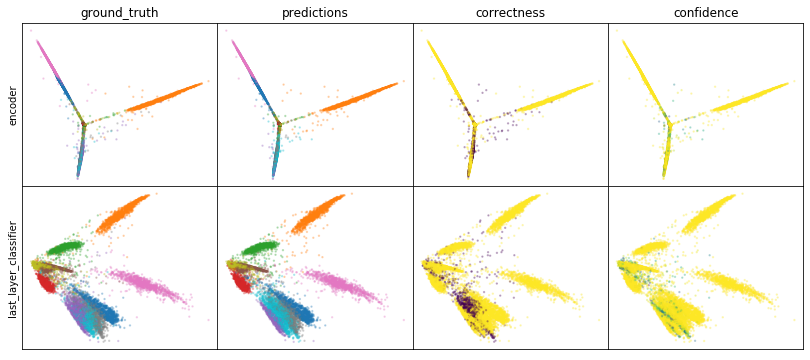

W0808 00:35:36.720917 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:35:36.828159 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:35:36.935859 140558110111488 legend.py:1282] No handles with labels found to put in legend.


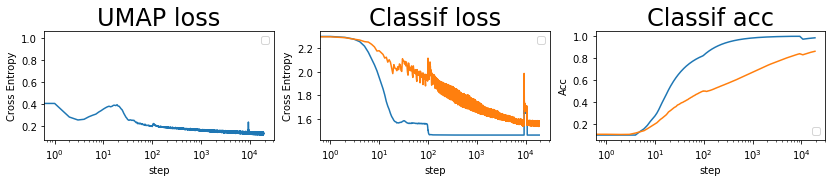

batch: 19000 | train acc: 0.9837 | val acc: 0.8613


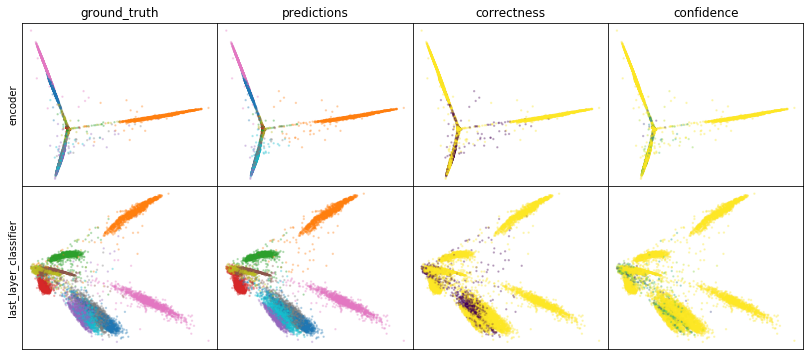

W0808 00:40:08.779440 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:40:08.889772 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:40:08.999314 140558110111488 legend.py:1282] No handles with labels found to put in legend.


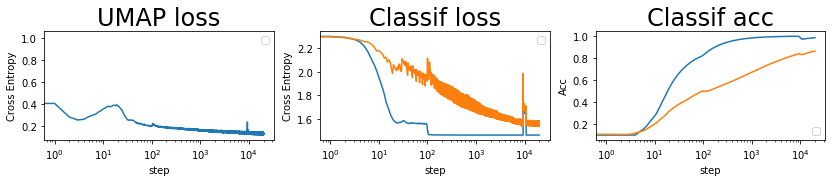

batch: 20000 | train acc: 0.9845 | val acc: 0.8635
saving weights | batch = 20431 | acc = 86.435


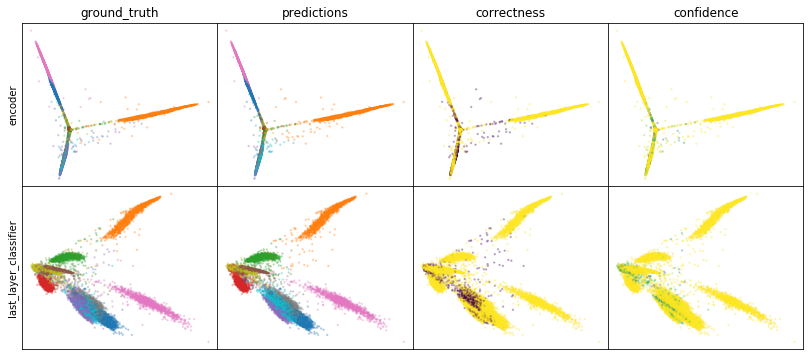

W0808 00:44:41.161049 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:44:41.270024 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:44:41.378074 140558110111488 legend.py:1282] No handles with labels found to put in legend.


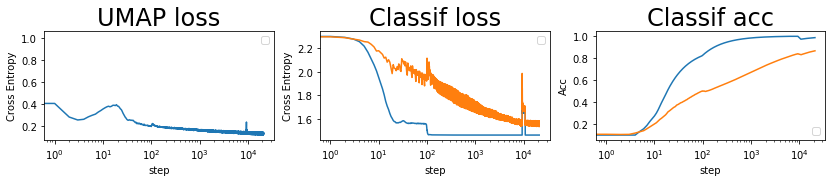

batch: 21000 | train acc: 0.9852 | val acc: 0.8655


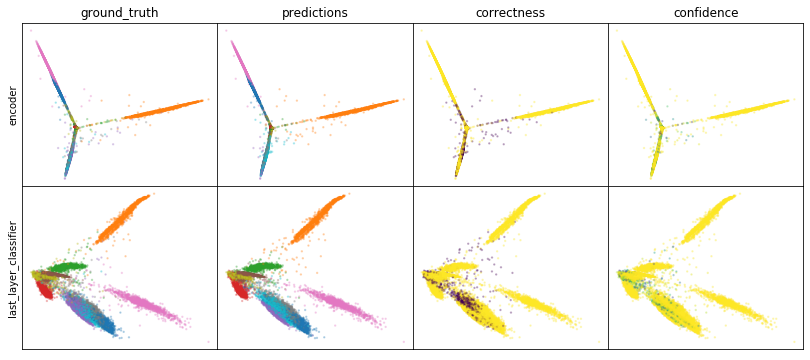

W0808 00:49:13.702706 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:49:13.814038 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:49:13.923370 140558110111488 legend.py:1282] No handles with labels found to put in legend.


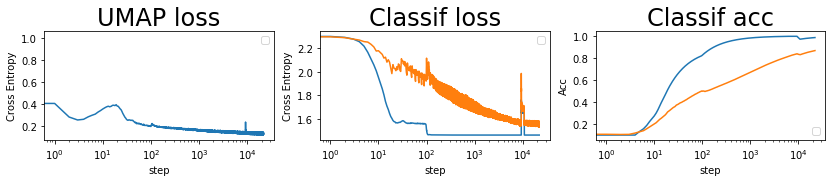

batch: 22000 | train acc: 0.9859 | val acc: 0.8676


saving weights | batch = 22912 | acc = 86.935


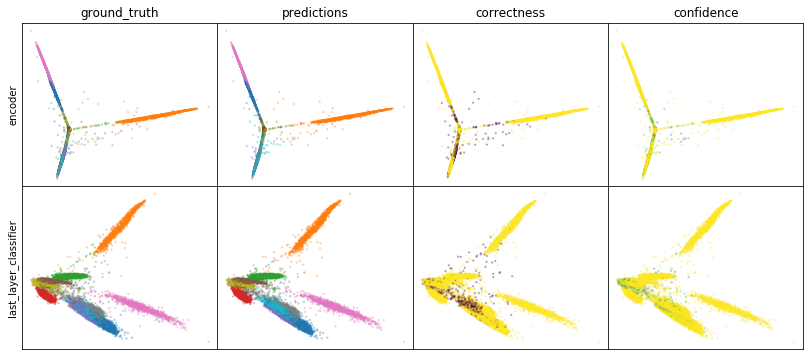

W0808 00:53:47.249720 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:53:47.366066 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:53:47.481409 140558110111488 legend.py:1282] No handles with labels found to put in legend.


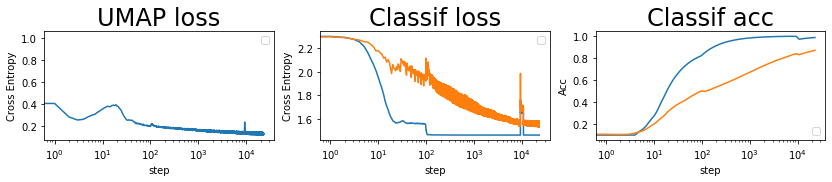

batch: 23000 | train acc: 0.9865 | val acc: 0.8695
batch 23593 | acc = 0.859 | learn rate = 0.0005000000237487257 | reloading weights from batch 22912 at acc 86 | n reloads = 1


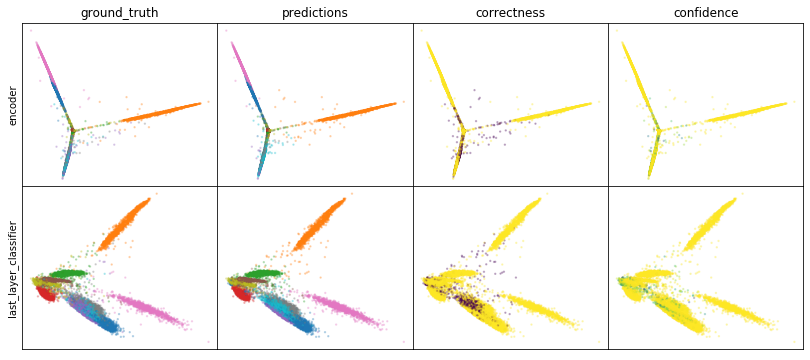

W0808 00:58:20.958601 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:58:21.085422 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 00:58:21.207552 140558110111488 legend.py:1282] No handles with labels found to put in legend.


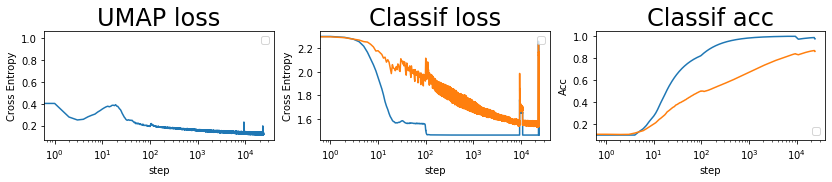

batch: 24000 | train acc: 0.9744 | val acc: 0.8602


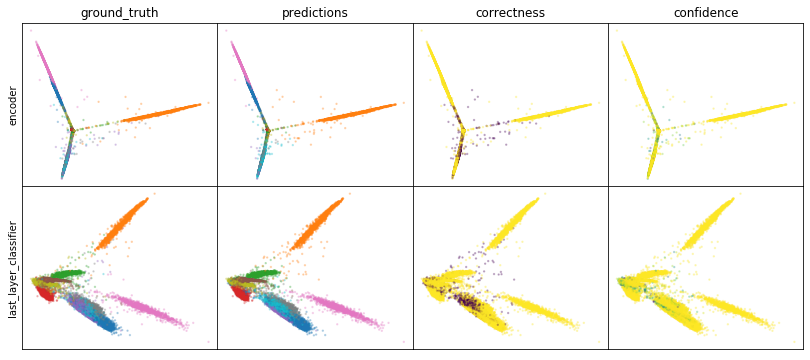

W0808 01:02:54.761866 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:02:54.886235 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:02:55.009767 140558110111488 legend.py:1282] No handles with labels found to put in legend.


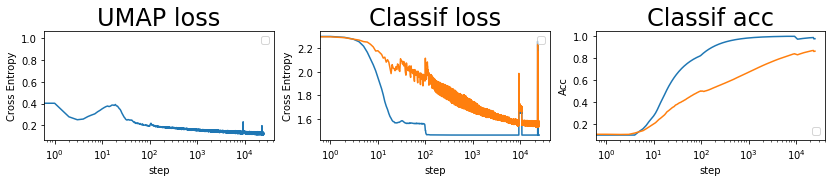

batch: 25000 | train acc: 0.9754 | val acc: 0.8622


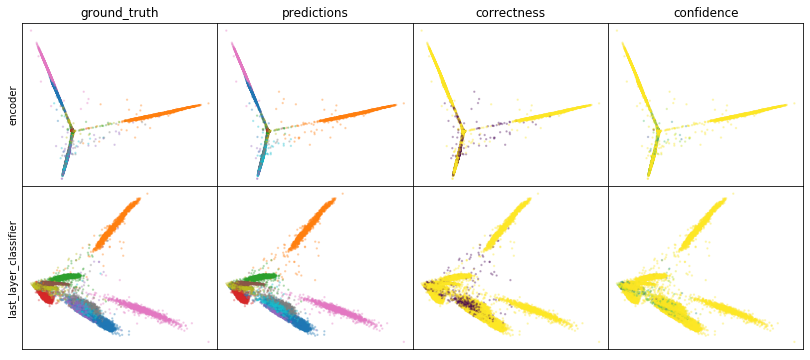

W0808 01:07:29.180529 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:07:29.312842 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:07:29.442092 140558110111488 legend.py:1282] No handles with labels found to put in legend.


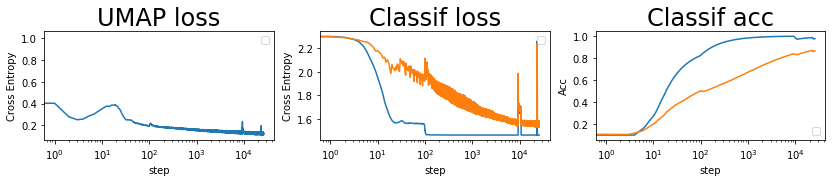

batch: 26000 | train acc: 0.9763 | val acc: 0.8639


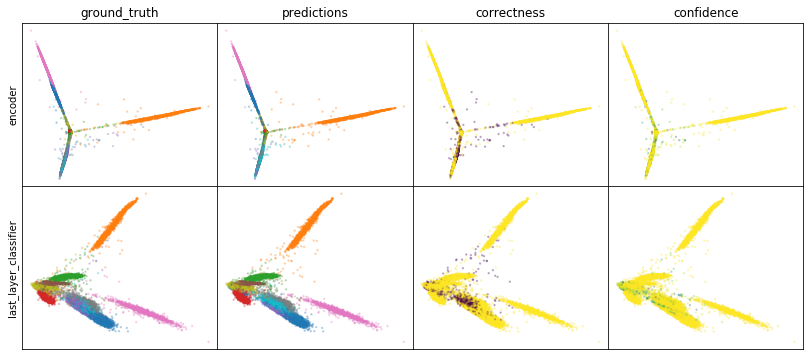

W0808 01:12:04.153824 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:12:04.288303 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:12:04.426398 140558110111488 legend.py:1282] No handles with labels found to put in legend.


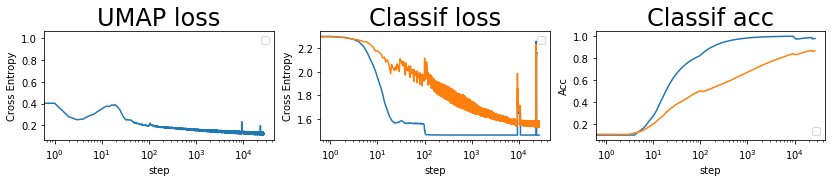

batch: 27000 | train acc: 0.9772 | val acc: 0.8657


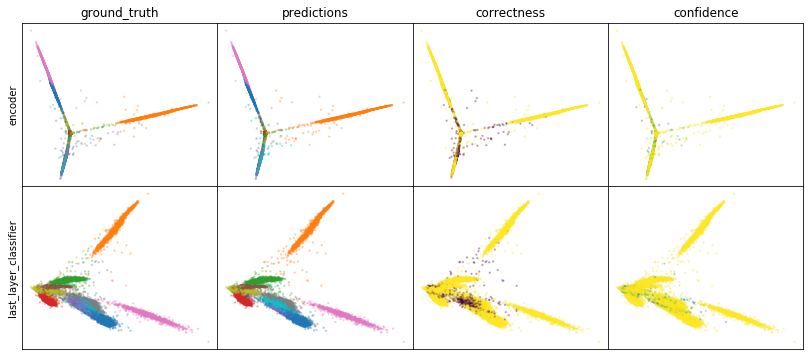

W0808 01:16:39.549395 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:16:39.681562 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:16:39.814482 140558110111488 legend.py:1282] No handles with labels found to put in legend.


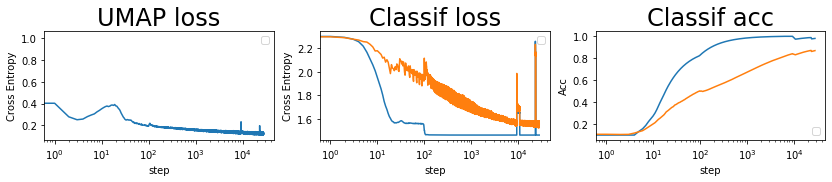

batch: 28000 | train acc: 0.978 | val acc: 0.8673


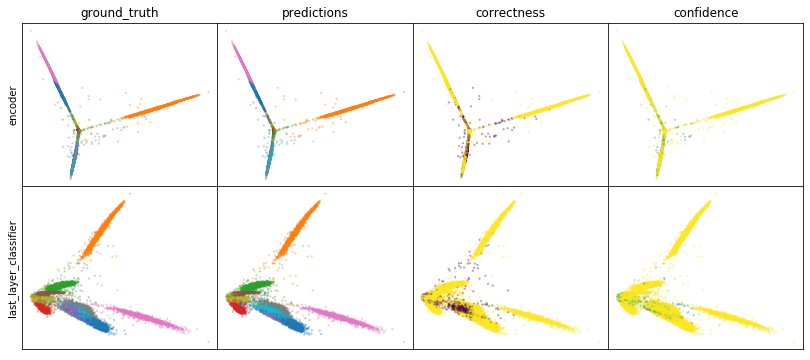

W0808 01:21:15.656477 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:21:15.795667 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:21:15.935845 140558110111488 legend.py:1282] No handles with labels found to put in legend.


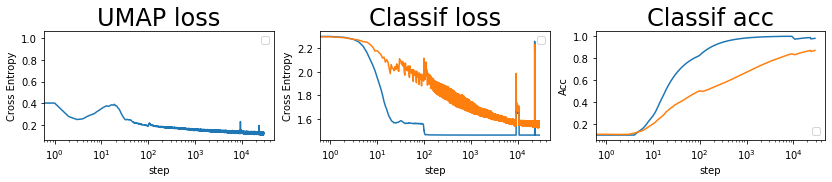

batch: 29000 | train acc: 0.9788 | val acc: 0.8688


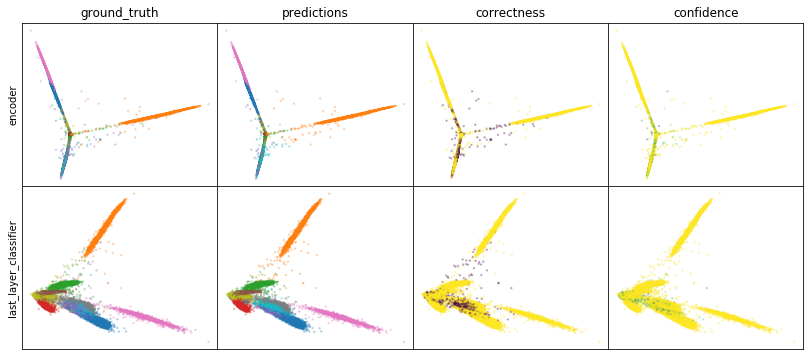

W0808 01:25:51.913718 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:25:52.059607 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:25:52.205643 140558110111488 legend.py:1282] No handles with labels found to put in legend.


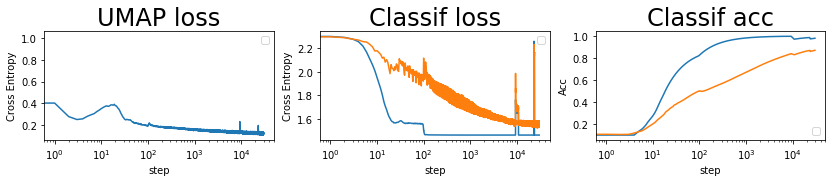

batch: 30000 | train acc: 0.9795 | val acc: 0.8703


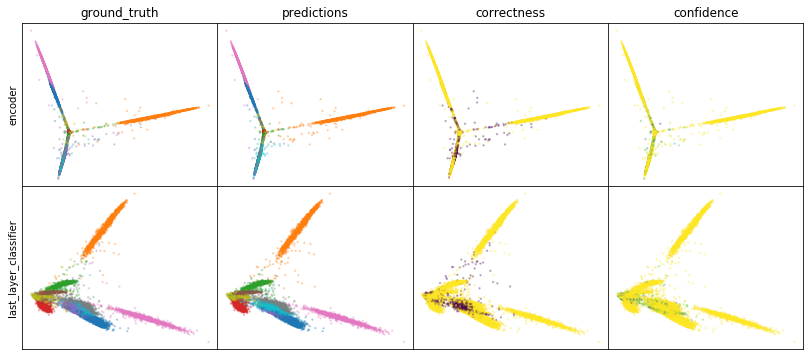

W0808 01:30:28.774490 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:30:28.919914 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:30:29.066574 140558110111488 legend.py:1282] No handles with labels found to put in legend.


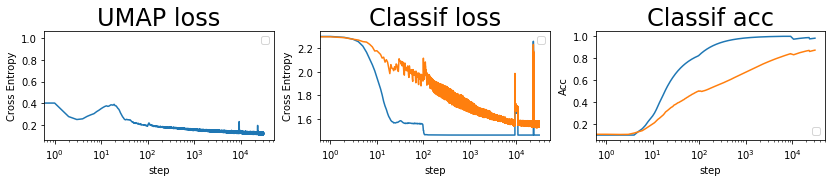

batch: 31000 | train acc: 0.9802 | val acc: 0.8716


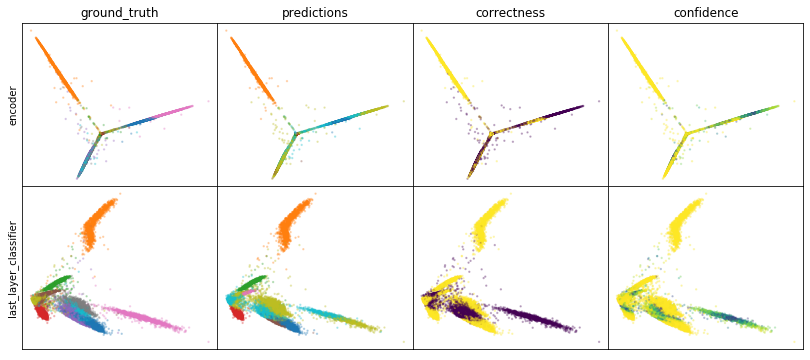

W0808 01:35:06.241713 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:35:06.404564 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:35:06.556895 140558110111488 legend.py:1282] No handles with labels found to put in legend.


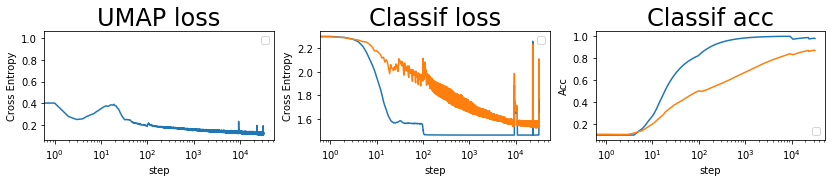

batch: 32000 | train acc: 0.977 | val acc: 0.8679


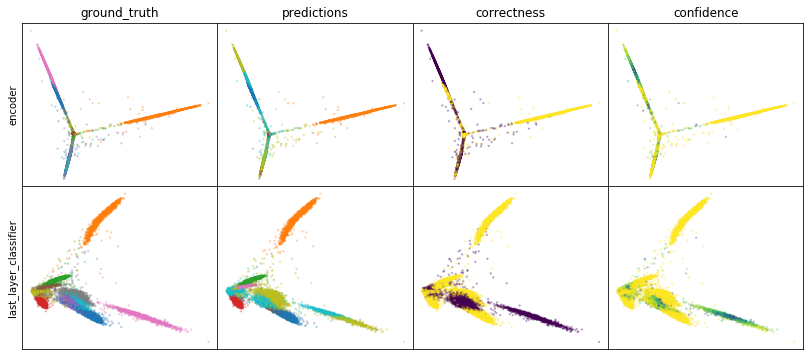

W0808 01:39:44.350994 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:39:44.498716 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:39:44.645964 140558110111488 legend.py:1282] No handles with labels found to put in legend.


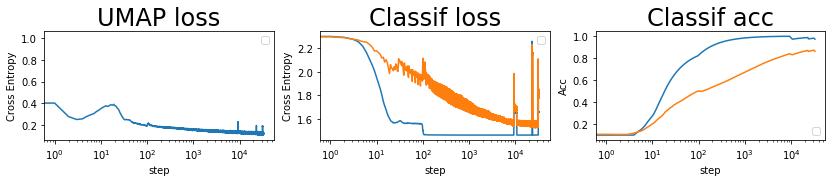

batch: 33000 | train acc: 0.9717 | val acc: 0.861
batch 33277 | acc = 0.859 | learn rate = 0.0002500000118743628 | reloading weights from batch 22912 at acc 86 | n reloads = 2


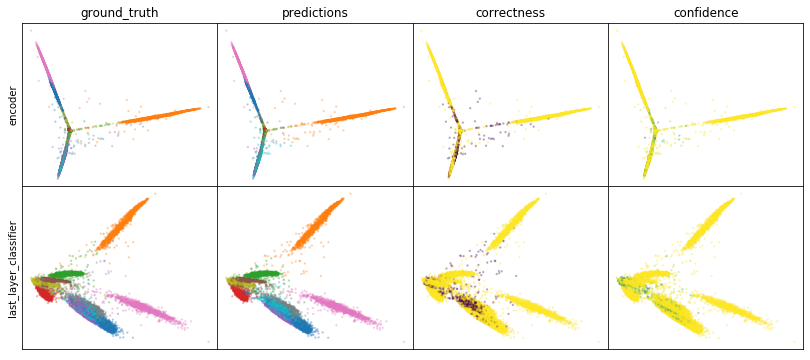

W0808 01:44:22.263065 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:44:22.422805 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:44:22.574466 140558110111488 legend.py:1282] No handles with labels found to put in legend.


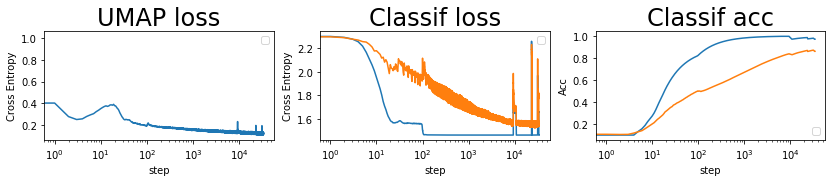

batch: 34000 | train acc: 0.9709 | val acc: 0.8604


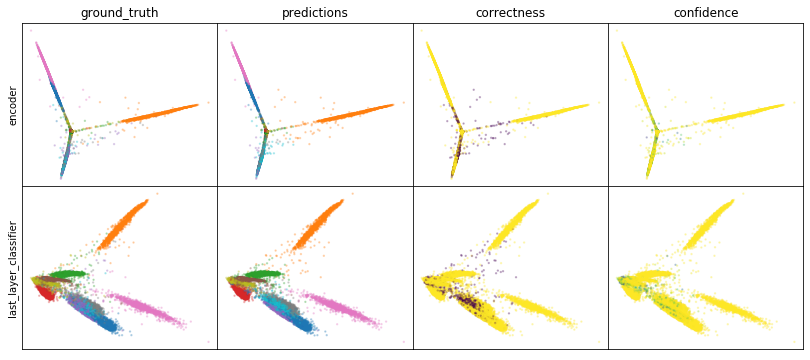

W0808 01:49:00.870136 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:49:01.019929 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:49:01.169658 140558110111488 legend.py:1282] No handles with labels found to put in legend.


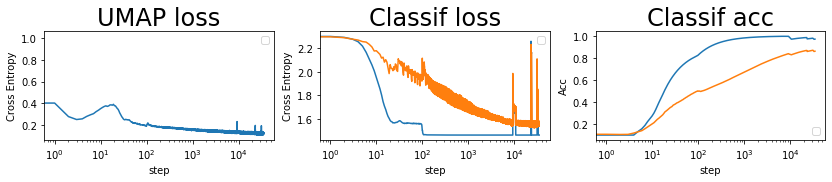

batch: 35000 | train acc: 0.9717 | val acc: 0.8618


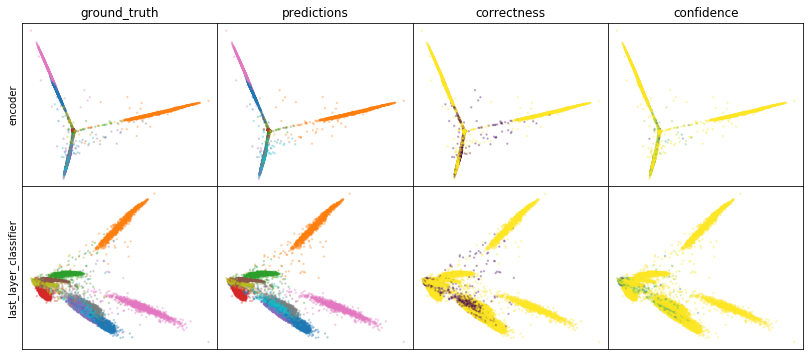

W0808 01:53:39.659439 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:53:39.815080 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:53:39.970809 140558110111488 legend.py:1282] No handles with labels found to put in legend.


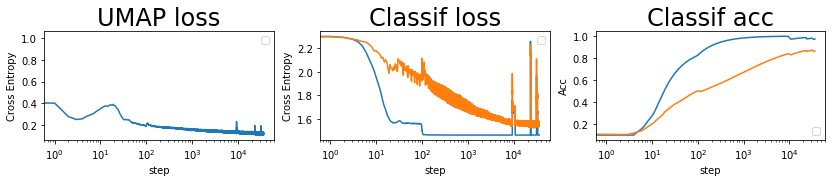

batch: 36000 | train acc: 0.9725 | val acc: 0.8632


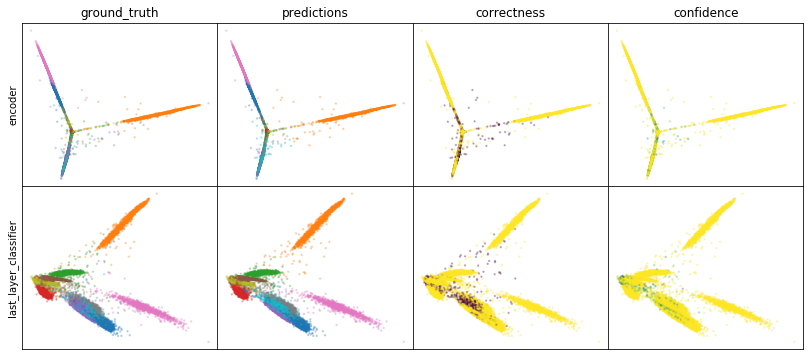

W0808 01:58:18.595734 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:58:18.750982 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 01:58:18.905660 140558110111488 legend.py:1282] No handles with labels found to put in legend.


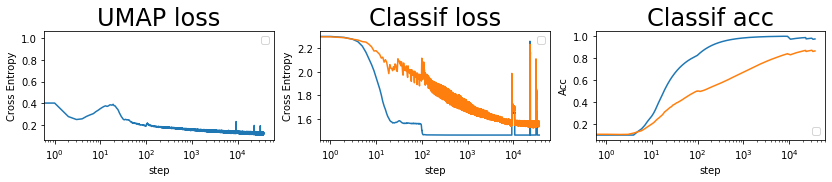

batch: 37000 | train acc: 0.9732 | val acc: 0.8645


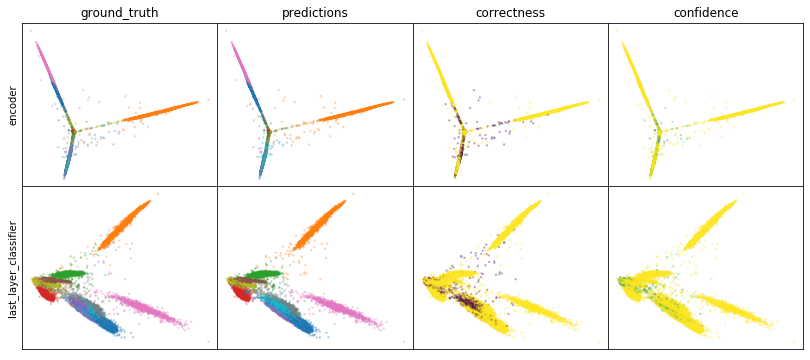

W0808 02:02:58.170689 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:02:58.328683 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:02:58.486218 140558110111488 legend.py:1282] No handles with labels found to put in legend.


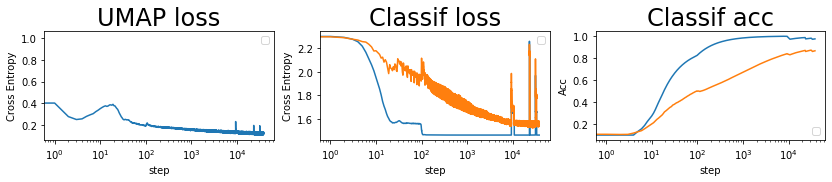

batch: 38000 | train acc: 0.9739 | val acc: 0.8657


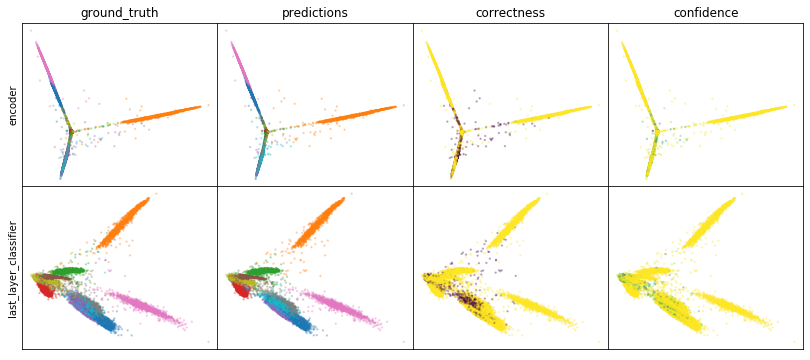

W0808 02:07:39.901468 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:07:40.065075 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:07:40.230067 140558110111488 legend.py:1282] No handles with labels found to put in legend.


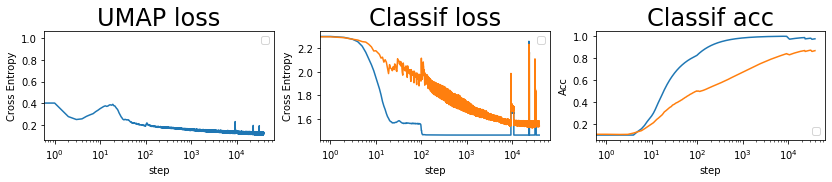

batch: 39000 | train acc: 0.9746 | val acc: 0.8669


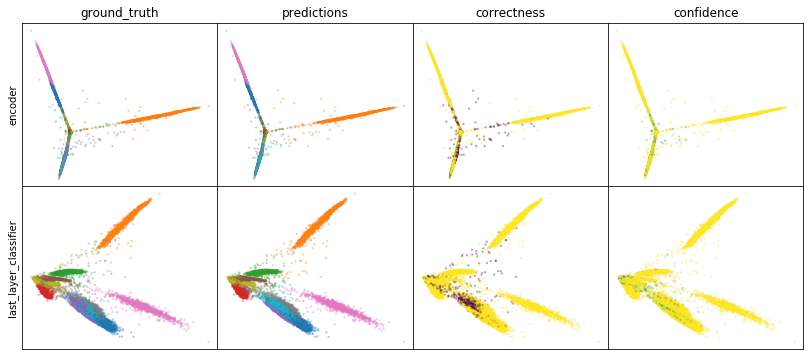

W0808 02:12:19.995422 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:12:20.159113 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:12:20.320621 140558110111488 legend.py:1282] No handles with labels found to put in legend.


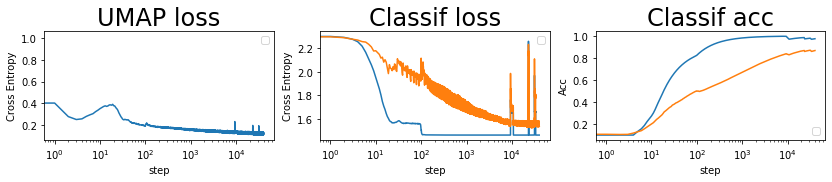

batch: 40000 | train acc: 0.9753 | val acc: 0.868


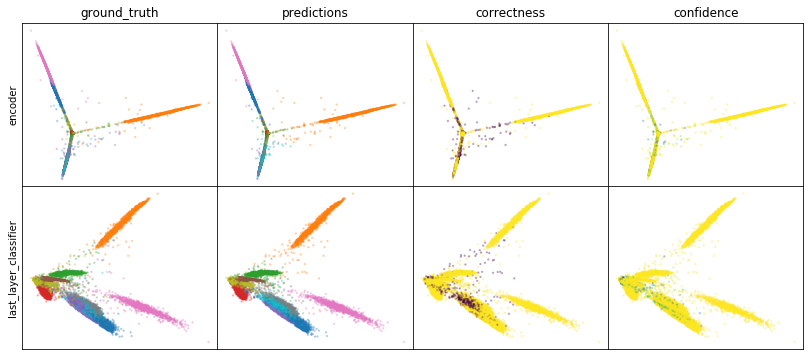

W0808 02:17:01.643878 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:17:01.808151 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:17:01.971592 140558110111488 legend.py:1282] No handles with labels found to put in legend.


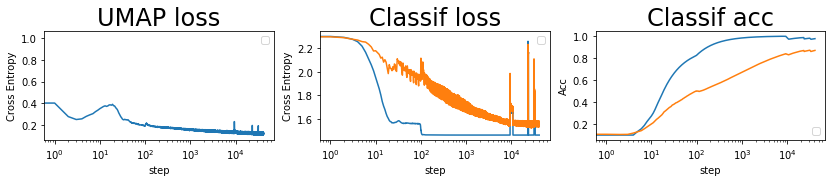

batch: 41000 | train acc: 0.9759 | val acc: 0.8691
leaving epoch because no improvement in 10000 batches


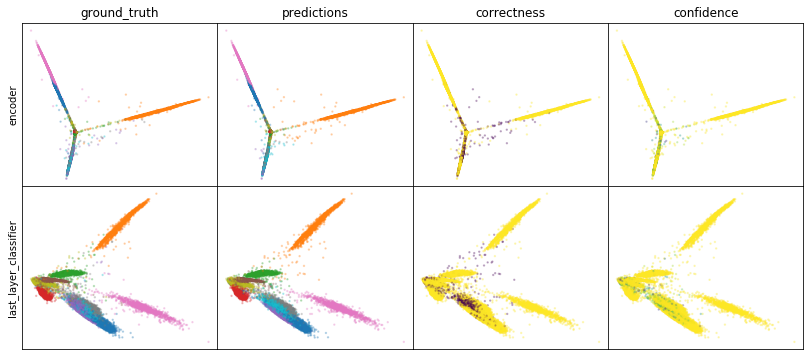

W0808 02:21:43.978511 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:21:44.155024 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:21:44.344314 140558110111488 legend.py:1282] No handles with labels found to put in legend.


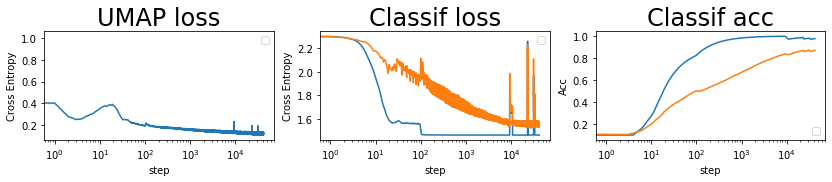

batch: 42000 | train acc: 0.9764 | val acc: 0.8702


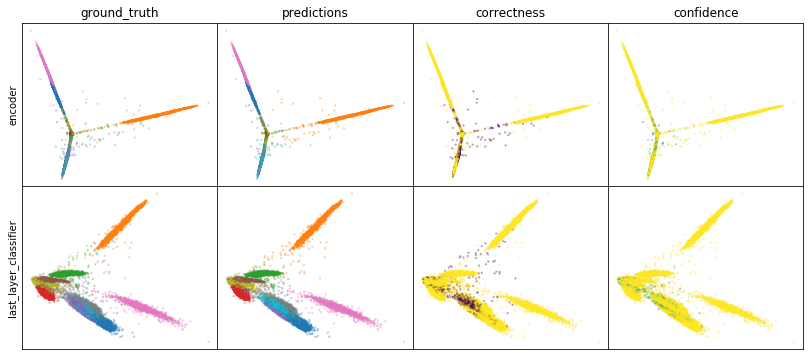

W0808 02:26:25.966044 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:26:26.144792 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:26:26.322518 140558110111488 legend.py:1282] No handles with labels found to put in legend.


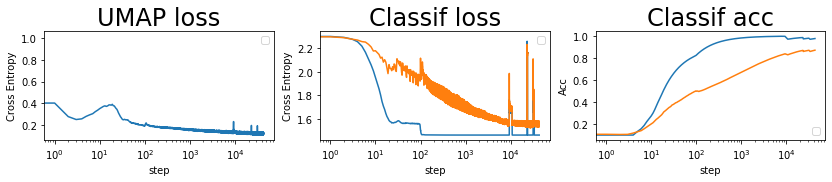

batch: 43000 | train acc: 0.977 | val acc: 0.8712


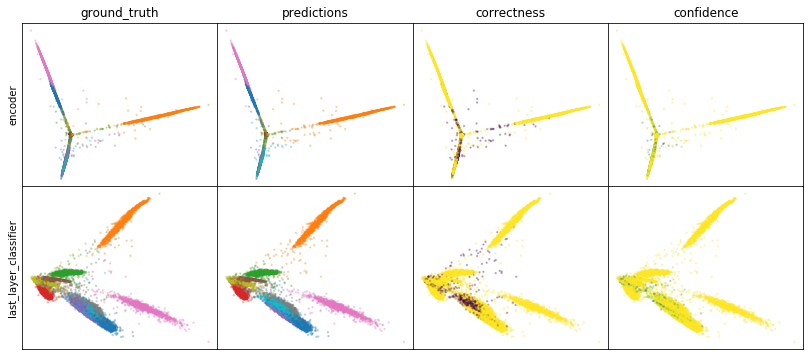

W0808 02:31:07.927637 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:31:08.105588 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:31:08.281276 140558110111488 legend.py:1282] No handles with labels found to put in legend.


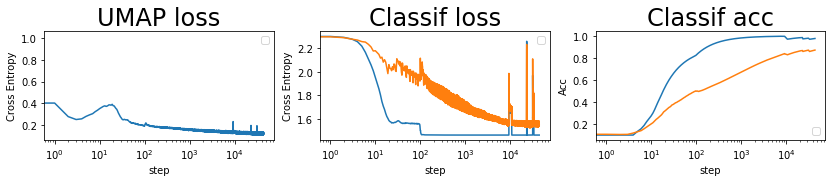

batch: 44000 | train acc: 0.9775 | val acc: 0.8721


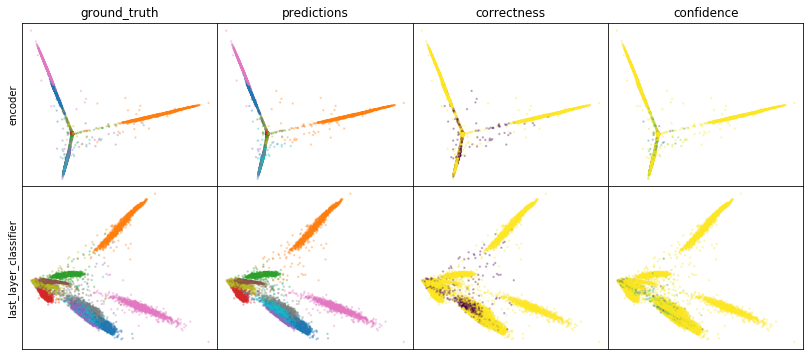

W0808 02:35:50.456185 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:35:50.640663 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:35:50.823719 140558110111488 legend.py:1282] No handles with labels found to put in legend.


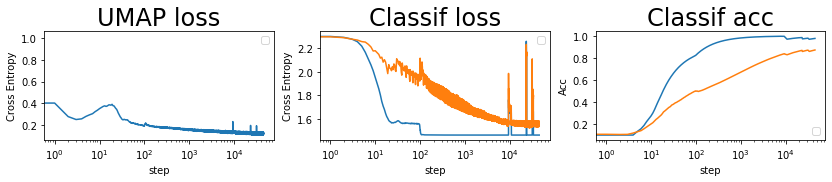

batch: 45000 | train acc: 0.978 | val acc: 0.873


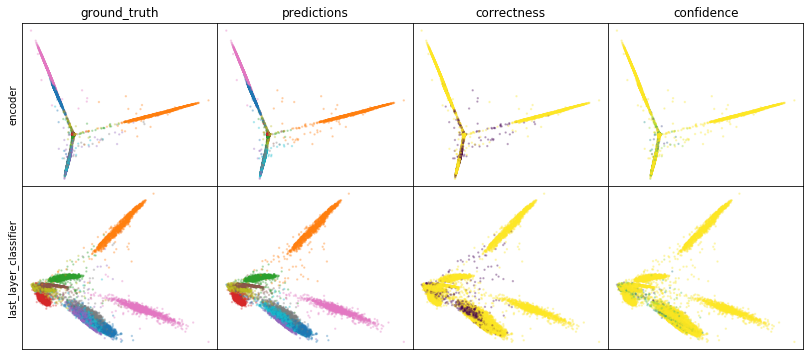

W0808 02:40:35.163503 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:40:35.343317 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:40:35.523616 140558110111488 legend.py:1282] No handles with labels found to put in legend.


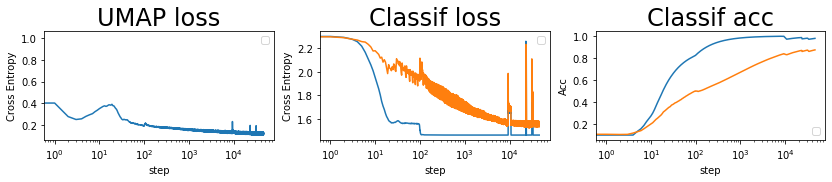

batch: 46000 | train acc: 0.9785 | val acc: 0.8739
saving weights | batch = 46545 | acc = 87.435


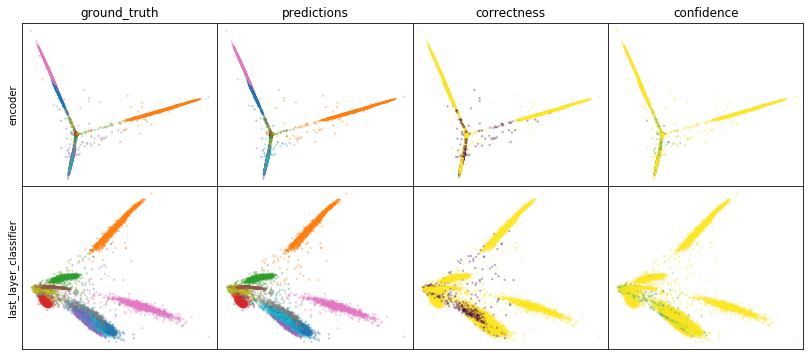

W0808 02:45:19.179140 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:45:19.361652 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:45:19.545817 140558110111488 legend.py:1282] No handles with labels found to put in legend.


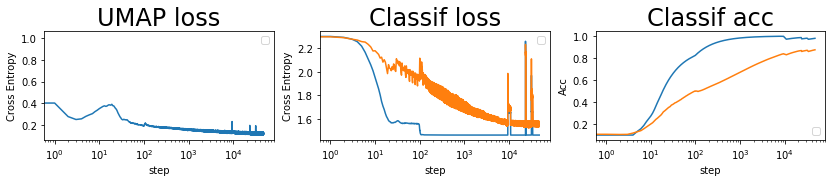

batch: 47000 | train acc: 0.9789 | val acc: 0.8747


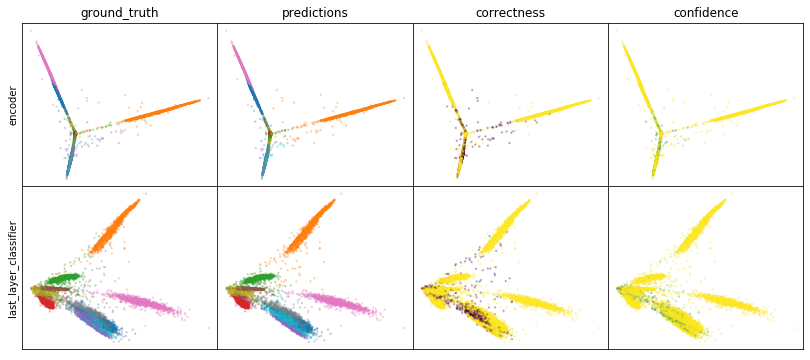

W0808 02:50:03.871101 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:50:04.055805 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:50:04.243241 140558110111488 legend.py:1282] No handles with labels found to put in legend.


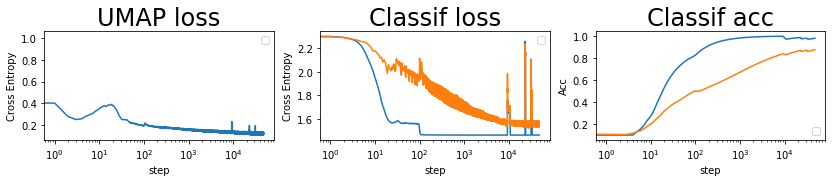

batch: 48000 | train acc: 0.9794 | val acc: 0.8755


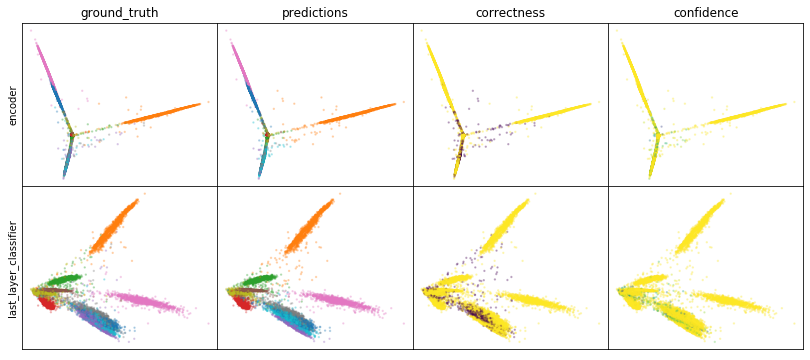

W0808 02:54:47.499850 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:54:47.684333 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:54:47.871639 140558110111488 legend.py:1282] No handles with labels found to put in legend.


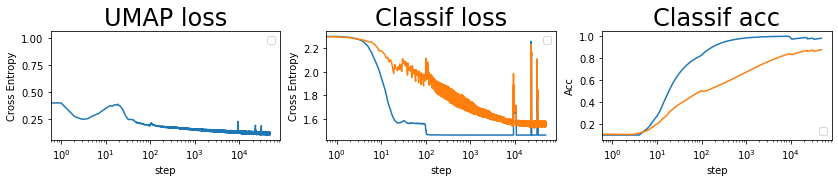

batch: 49000 | train acc: 0.9798 | val acc: 0.8763


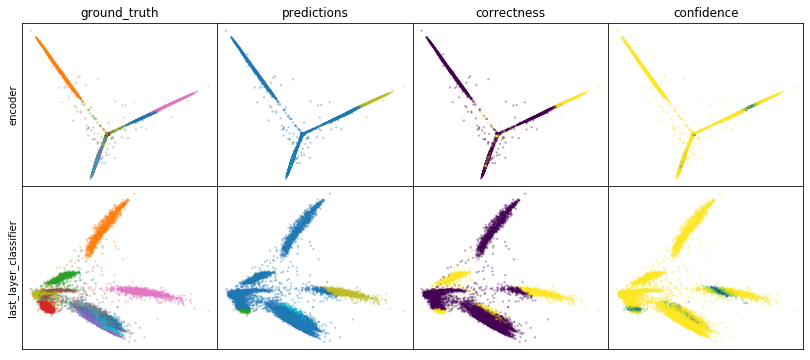

W0808 02:59:33.261535 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:59:33.457117 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 02:59:33.645786 140558110111488 legend.py:1282] No handles with labels found to put in legend.


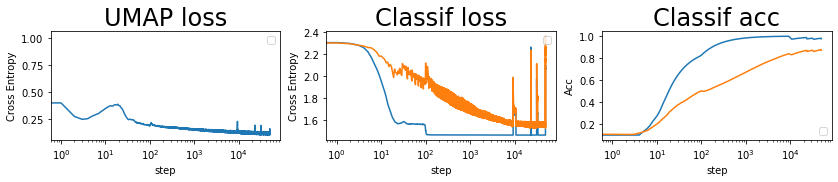

batch: 50000 | train acc: 0.9754 | val acc: 0.8716
batch 50601 | acc = 0.864 | learn rate = 0.0001250000059371814 | reloading weights from batch 46545 at acc 87 | n reloads = 3


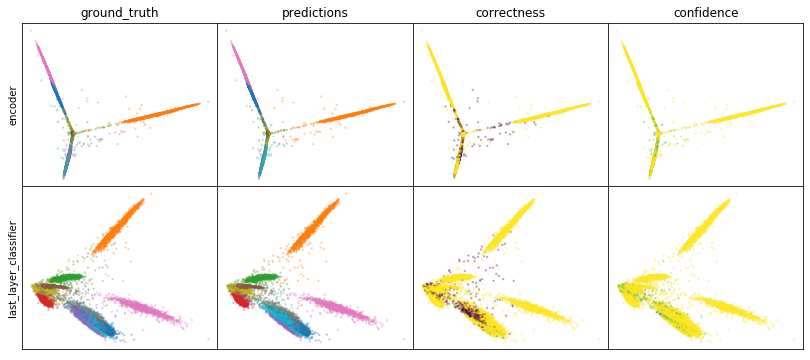

W0808 03:04:19.722155 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:04:19.916406 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:04:20.121793 140558110111488 legend.py:1282] No handles with labels found to put in legend.


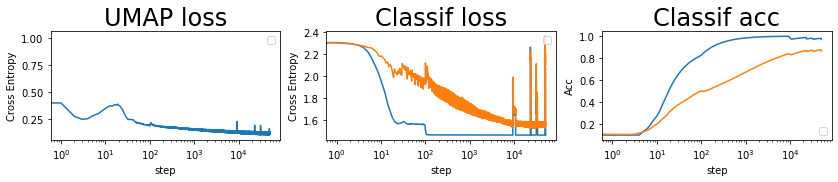

batch: 51000 | train acc: 0.9688 | val acc: 0.8647


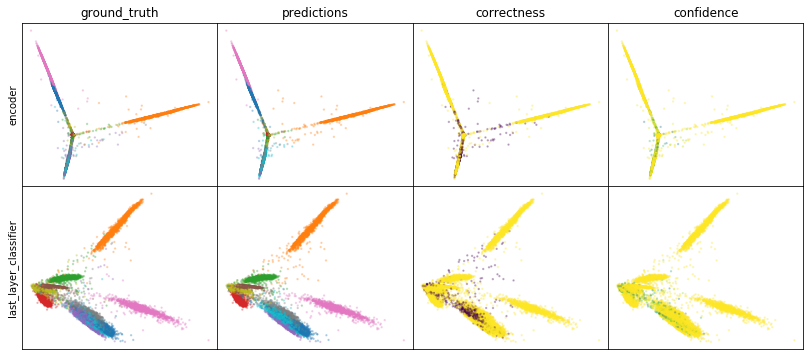

W0808 03:09:05.417345 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:09:05.639271 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:09:05.849669 140558110111488 legend.py:1282] No handles with labels found to put in legend.


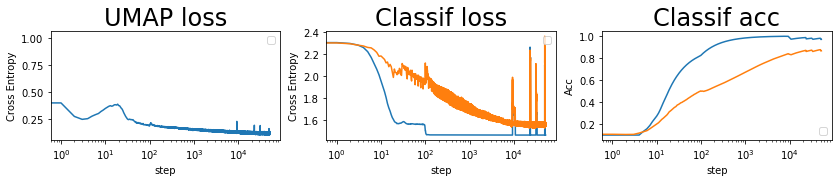

batch: 52000 | train acc: 0.9694 | val acc: 0.8656


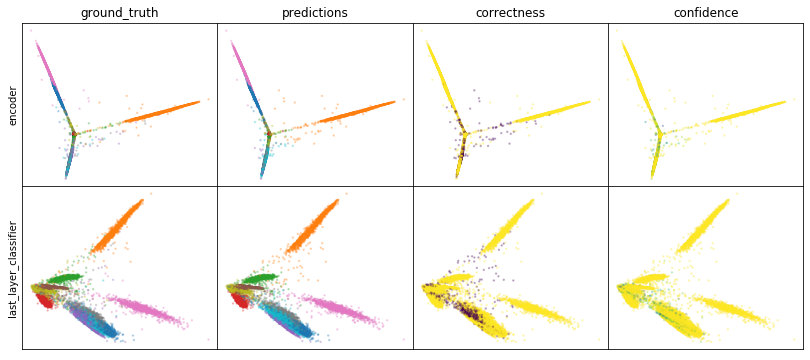

W0808 03:13:51.760372 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:13:51.977577 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:13:52.192825 140558110111488 legend.py:1282] No handles with labels found to put in legend.


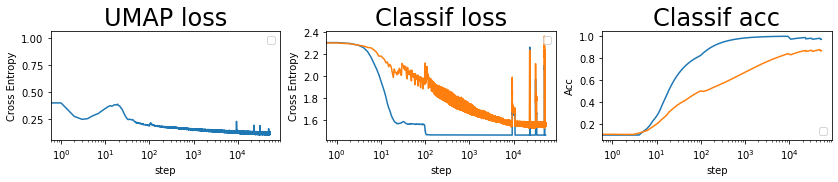

batch: 53000 | train acc: 0.97 | val acc: 0.8665


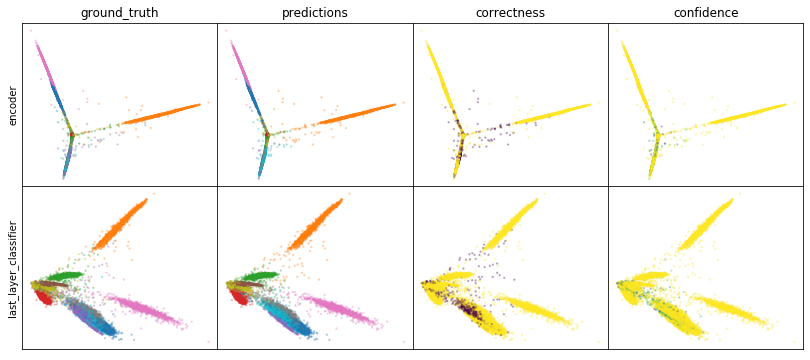

W0808 03:18:38.490371 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:18:38.707228 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:18:38.924798 140558110111488 legend.py:1282] No handles with labels found to put in legend.


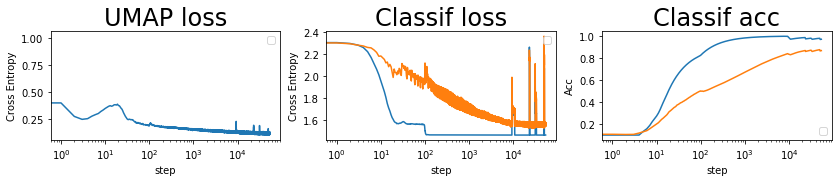

batch: 54000 | train acc: 0.9705 | val acc: 0.8673


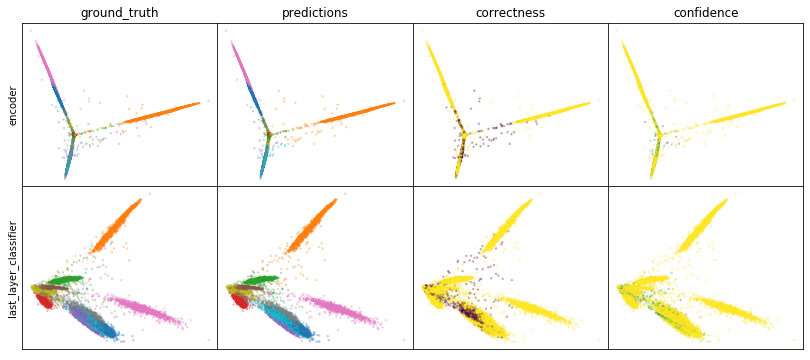

W0808 03:23:25.313914 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:23:25.529265 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:23:25.750192 140558110111488 legend.py:1282] No handles with labels found to put in legend.


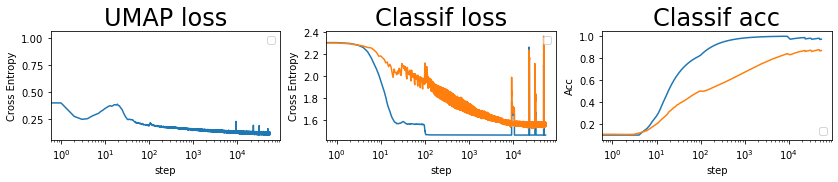

batch: 55000 | train acc: 0.9711 | val acc: 0.8681


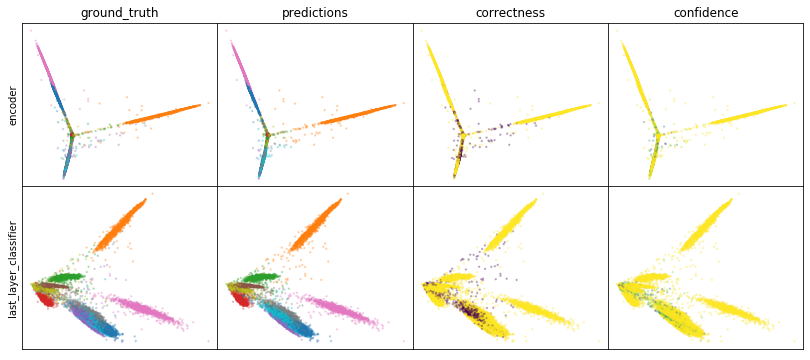

W0808 03:28:12.611547 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:28:12.831761 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:28:13.057057 140558110111488 legend.py:1282] No handles with labels found to put in legend.


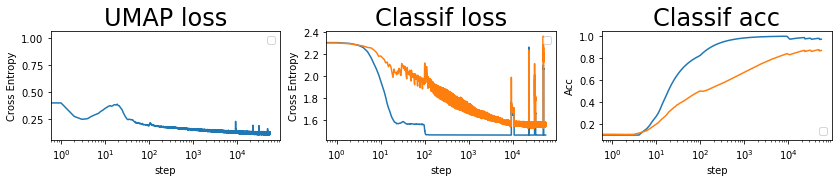

batch: 56000 | train acc: 0.9716 | val acc: 0.8689


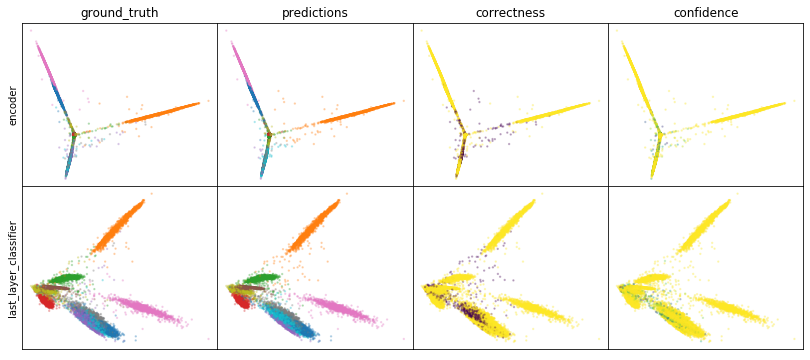

W0808 03:33:01.092705 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:33:01.328386 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:33:01.557059 140558110111488 legend.py:1282] No handles with labels found to put in legend.


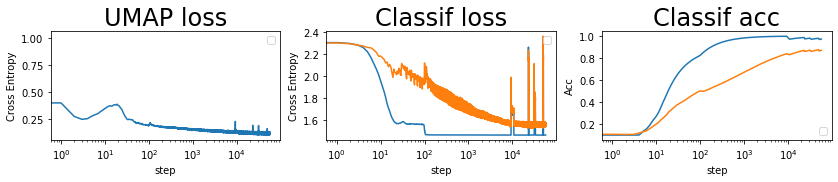

batch: 57000 | train acc: 0.9721 | val acc: 0.8696


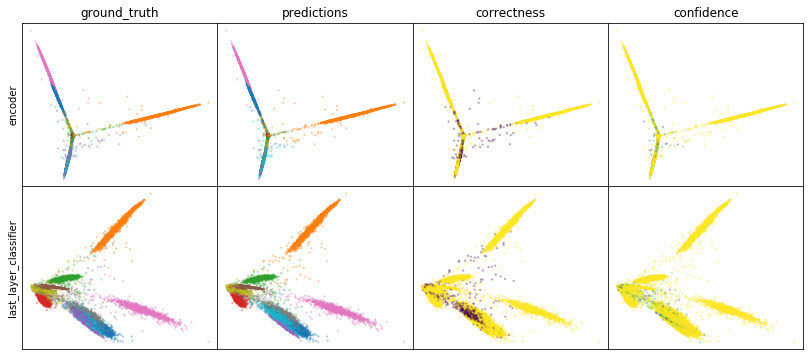

W0808 03:37:49.820118 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:37:50.038064 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:37:50.261405 140558110111488 legend.py:1282] No handles with labels found to put in legend.


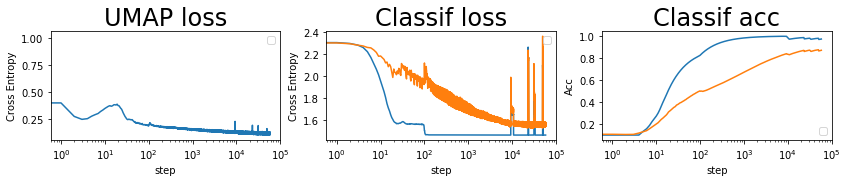

batch: 58000 | train acc: 0.9726 | val acc: 0.8703


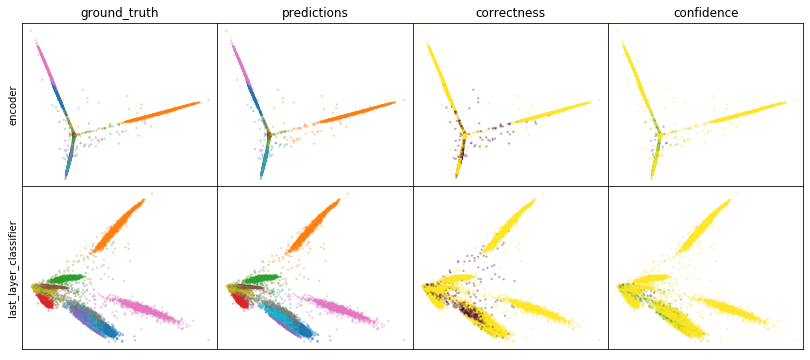

W0808 03:42:39.295850 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:42:39.516439 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:42:39.742559 140558110111488 legend.py:1282] No handles with labels found to put in legend.


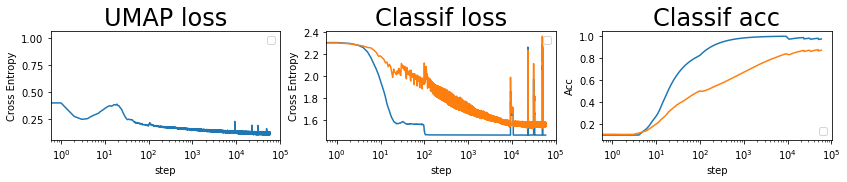

batch: 59000 | train acc: 0.973 | val acc: 0.871
leaving epoch because no improvement in 10000 batches


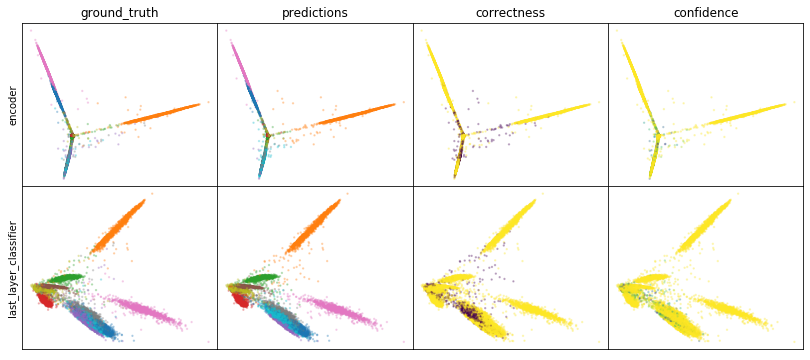

W0808 03:47:28.827412 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:47:29.056749 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:47:29.289029 140558110111488 legend.py:1282] No handles with labels found to put in legend.


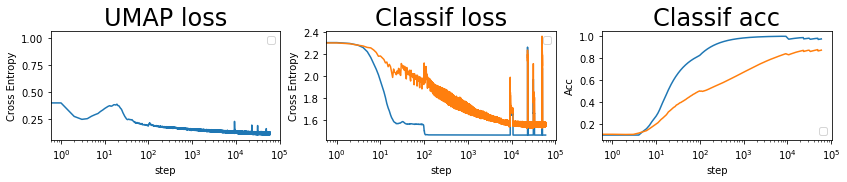

batch: 60000 | train acc: 0.9735 | val acc: 0.8716


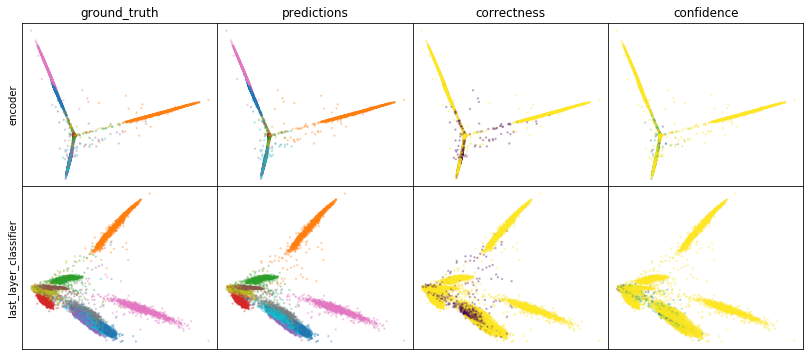

W0808 03:52:19.366372 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:52:19.597864 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:52:19.834677 140558110111488 legend.py:1282] No handles with labels found to put in legend.


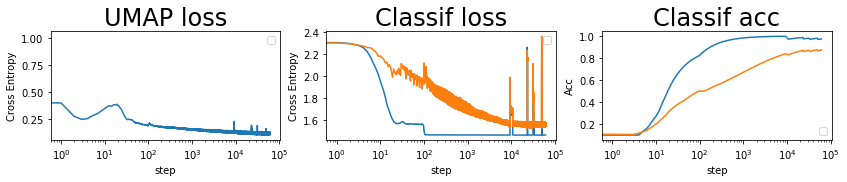

batch: 61000 | train acc: 0.9739 | val acc: 0.8723


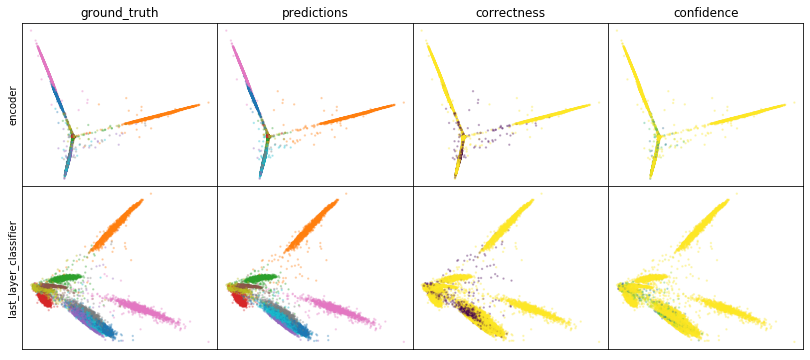

W0808 03:57:09.333305 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:57:09.577049 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 03:57:09.821083 140558110111488 legend.py:1282] No handles with labels found to put in legend.


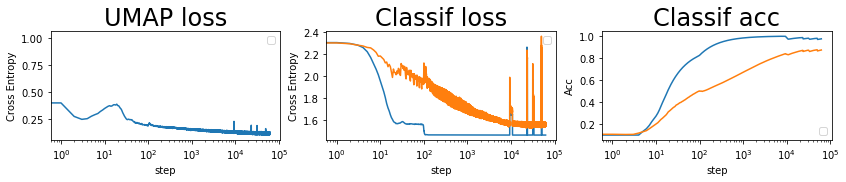

batch: 62000 | train acc: 0.9743 | val acc: 0.8728


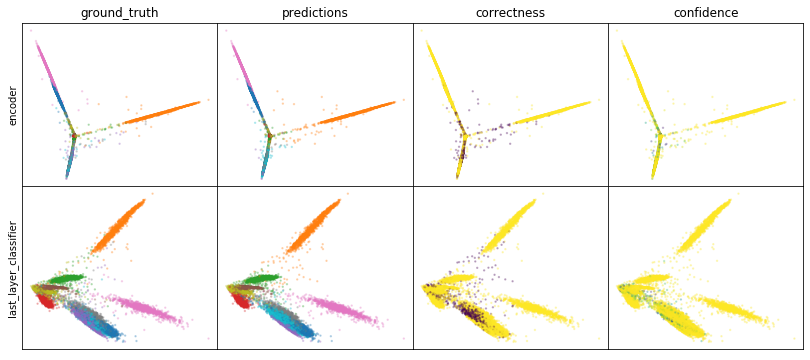

W0808 04:02:00.663305 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:02:00.899387 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:02:01.147043 140558110111488 legend.py:1282] No handles with labels found to put in legend.


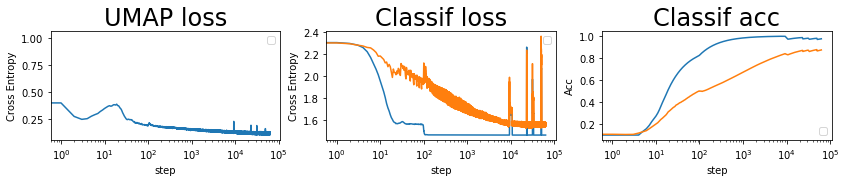

batch: 63000 | train acc: 0.9748 | val acc: 0.8734


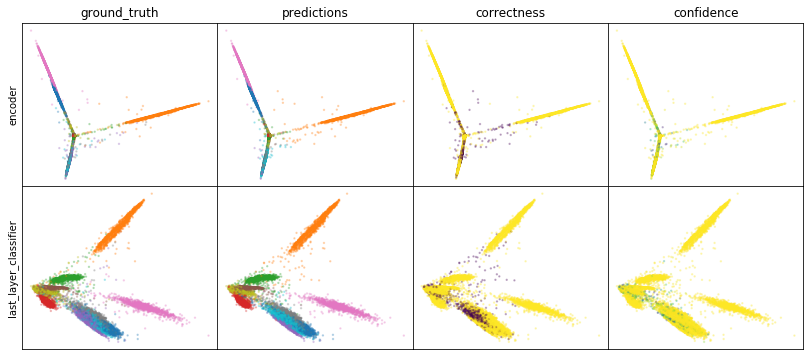

W0808 04:06:52.348868 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:06:52.581761 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:06:52.817636 140558110111488 legend.py:1282] No handles with labels found to put in legend.


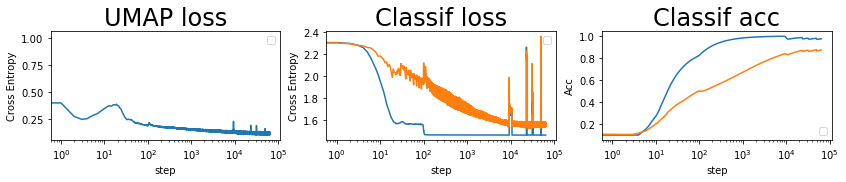

batch: 64000 | train acc: 0.9751 | val acc: 0.874


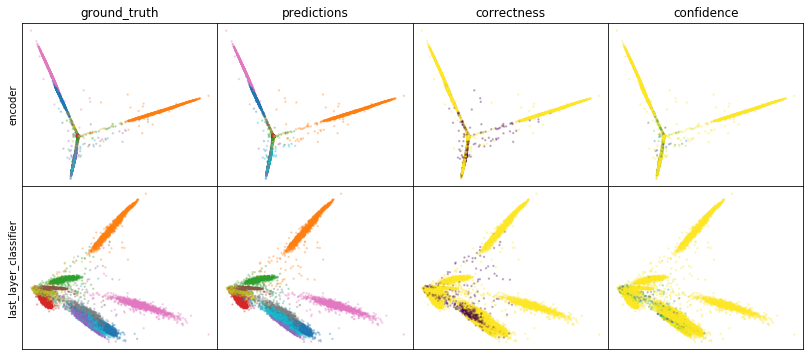

W0808 04:11:44.657357 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:11:44.902078 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:11:45.149776 140558110111488 legend.py:1282] No handles with labels found to put in legend.


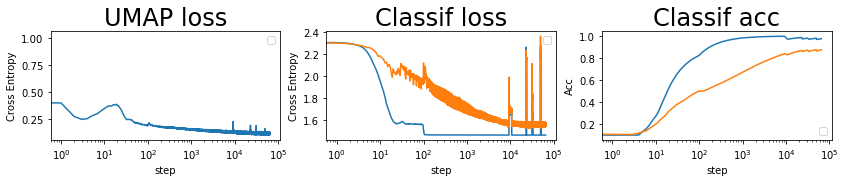

batch: 65000 | train acc: 0.9755 | val acc: 0.8745


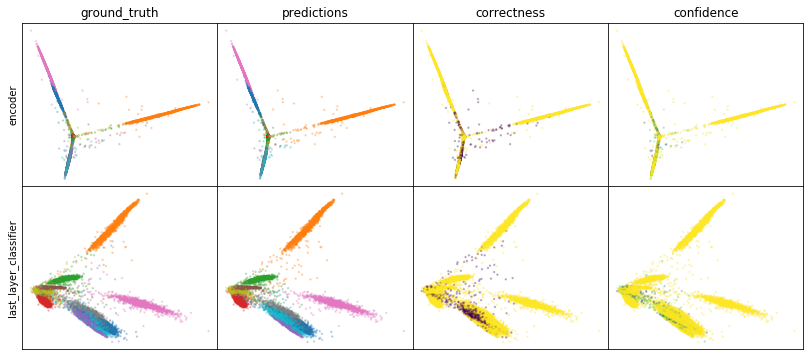

W0808 04:16:38.124134 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:16:38.366331 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:16:38.623843 140558110111488 legend.py:1282] No handles with labels found to put in legend.


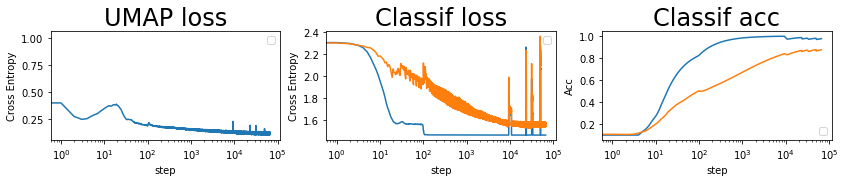

batch: 66000 | train acc: 0.9759 | val acc: 0.875


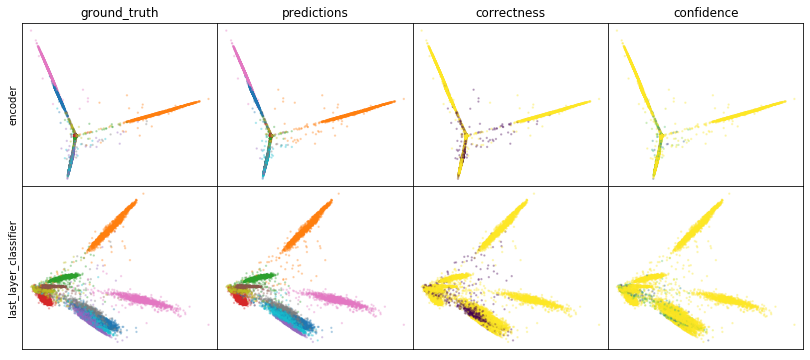

W0808 04:21:31.179939 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:21:31.427876 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:21:31.671859 140558110111488 legend.py:1282] No handles with labels found to put in legend.


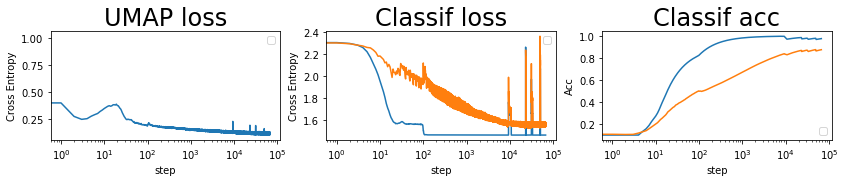

batch: 67000 | train acc: 0.9763 | val acc: 0.8755


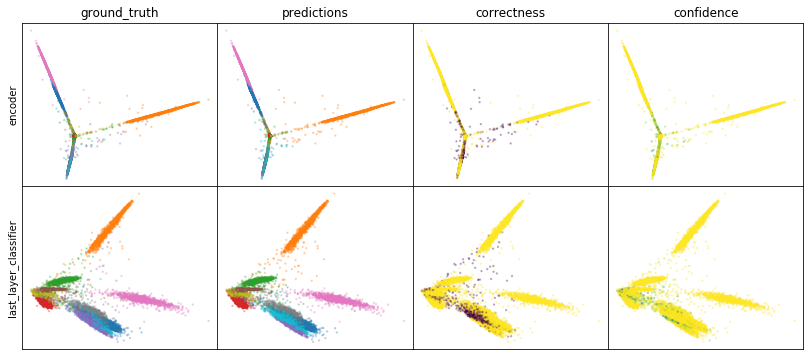

W0808 04:26:23.880984 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:26:24.120165 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:26:24.364641 140558110111488 legend.py:1282] No handles with labels found to put in legend.


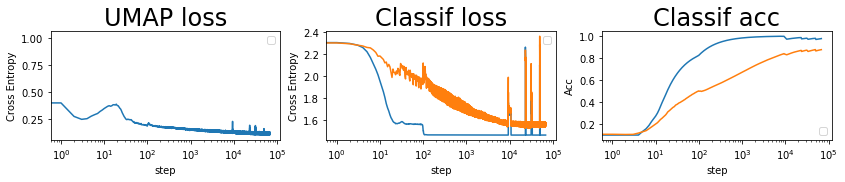

batch: 68000 | train acc: 0.9766 | val acc: 0.876


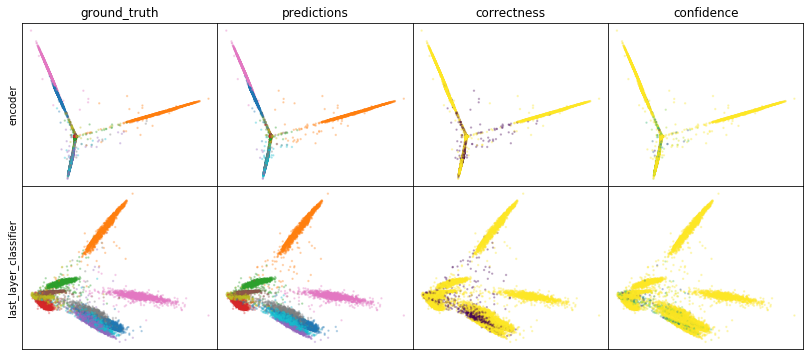

W0808 04:31:17.065647 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:31:17.311747 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:31:17.557737 140558110111488 legend.py:1282] No handles with labels found to put in legend.


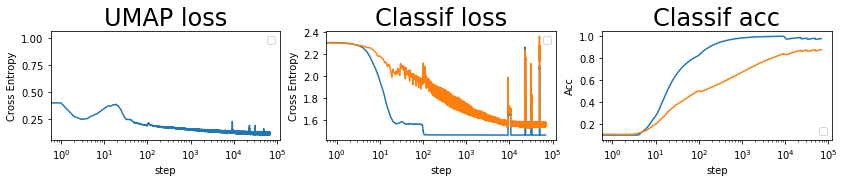

batch: 69000 | train acc: 0.9769 | val acc: 0.8765
leaving epoch because no improvement in 10000 batches


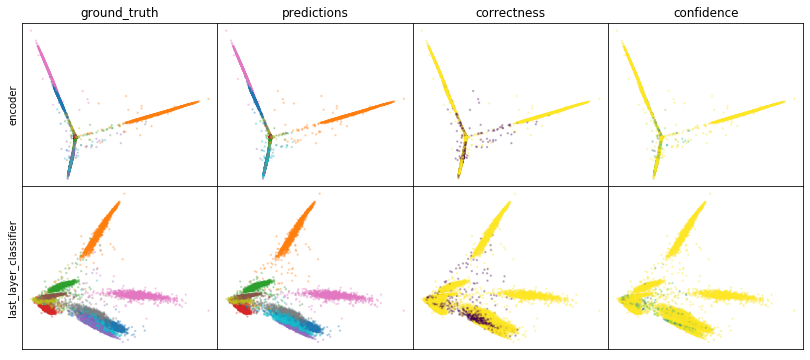

W0808 04:36:14.944140 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:36:15.210071 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:36:15.473370 140558110111488 legend.py:1282] No handles with labels found to put in legend.


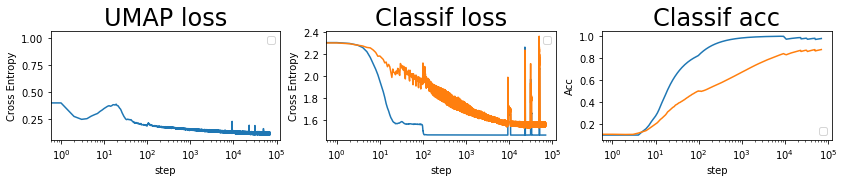

batch: 70000 | train acc: 0.9773 | val acc: 0.8769


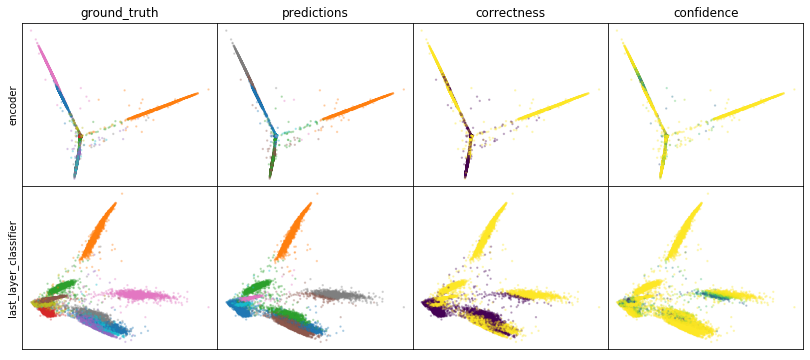

W0808 04:41:10.413242 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:41:10.672065 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:41:10.937982 140558110111488 legend.py:1282] No handles with labels found to put in legend.


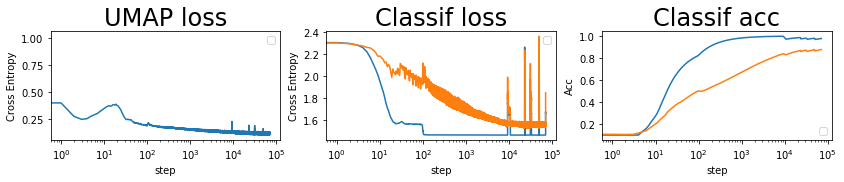

batch: 71000 | train acc: 0.9776 | val acc: 0.8774


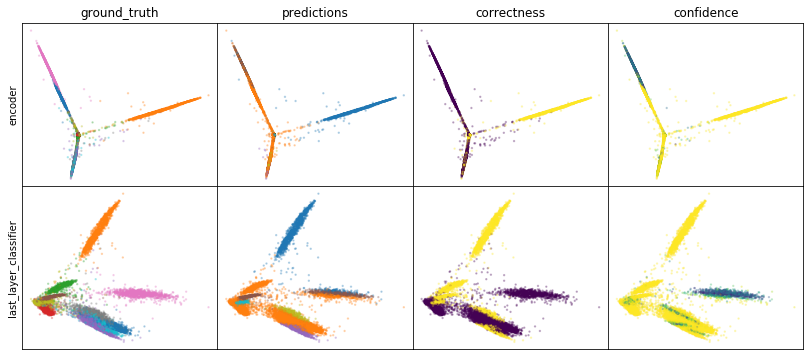

W0808 04:46:07.109793 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:46:07.370610 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:46:07.632240 140558110111488 legend.py:1282] No handles with labels found to put in legend.


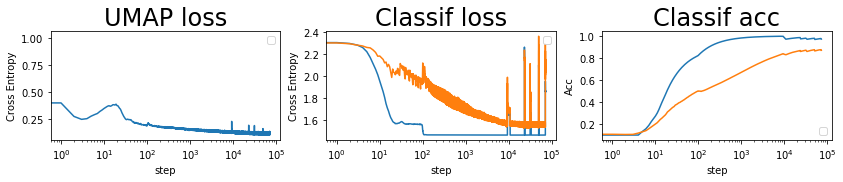

batch: 72000 | train acc: 0.9723 | val acc: 0.8703
batch 72924 | acc = 0.864 | learn rate = 6.25000029685907e-05 | reloading weights from batch 46545 at acc 87 | n reloads = 4


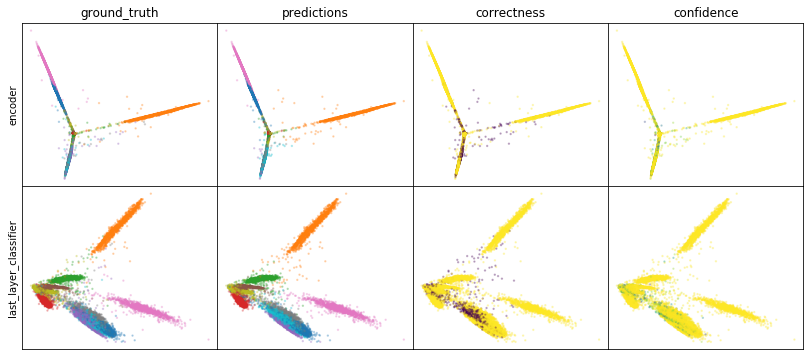

W0808 04:51:02.967164 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:51:03.223857 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:51:03.483677 140558110111488 legend.py:1282] No handles with labels found to put in legend.


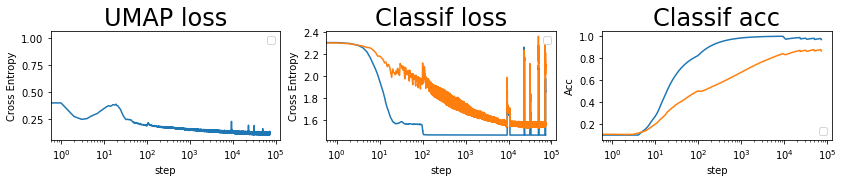

batch: 73000 | train acc: 0.9677 | val acc: 0.8644


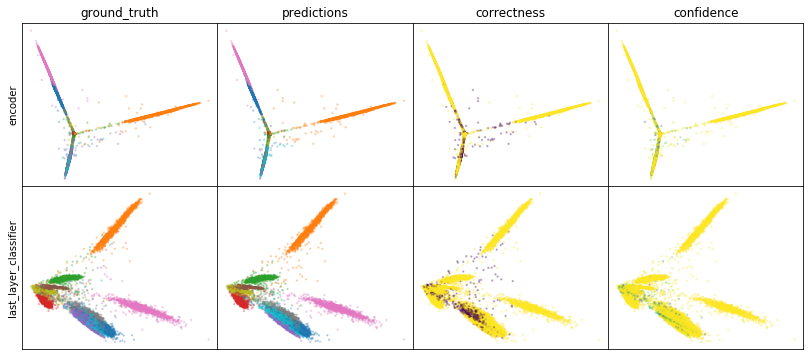

W0808 04:55:59.819096 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:56:00.077249 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 04:56:00.341171 140558110111488 legend.py:1282] No handles with labels found to put in legend.


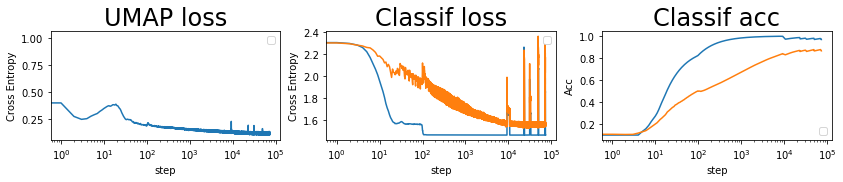

batch: 74000 | train acc: 0.9681 | val acc: 0.865


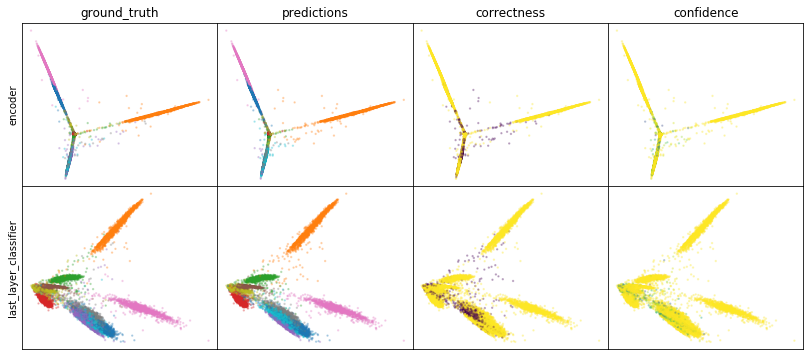

W0808 05:00:56.758677 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:00:57.025784 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:00:57.298289 140558110111488 legend.py:1282] No handles with labels found to put in legend.


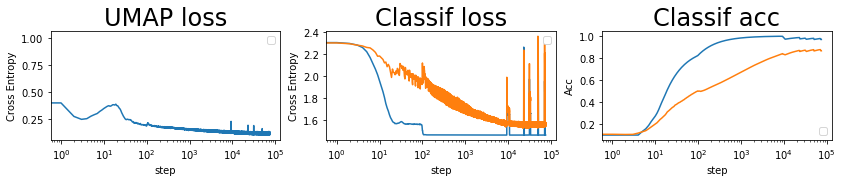

batch: 75000 | train acc: 0.9685 | val acc: 0.8656


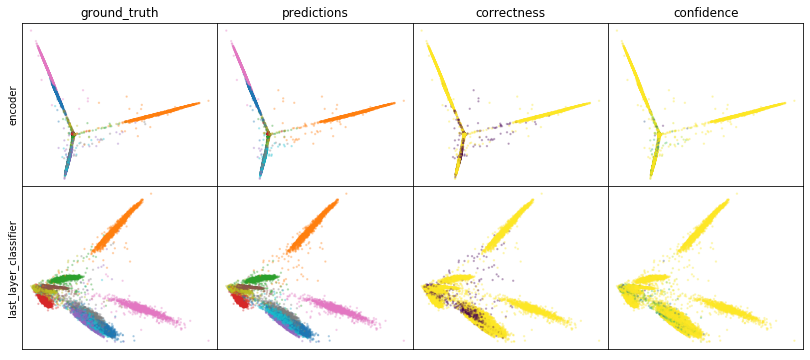

W0808 05:05:53.994451 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:05:54.274373 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:05:54.566087 140558110111488 legend.py:1282] No handles with labels found to put in legend.


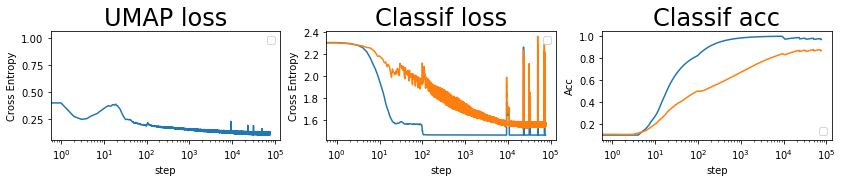

batch: 76000 | train acc: 0.9689 | val acc: 0.8662


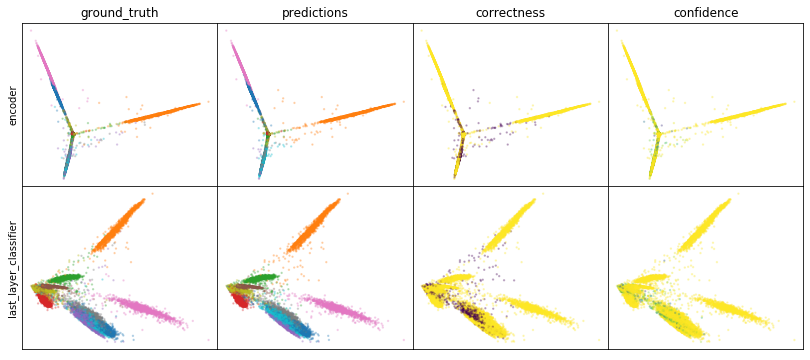

W0808 05:10:51.037683 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:10:51.306410 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:10:51.596337 140558110111488 legend.py:1282] No handles with labels found to put in legend.


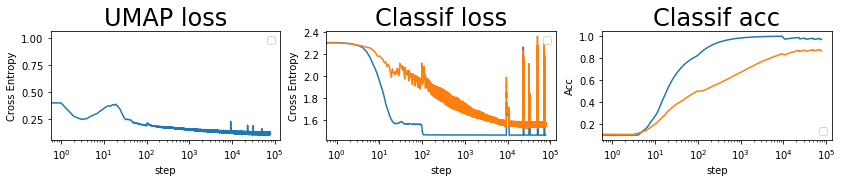

batch: 77000 | train acc: 0.9693 | val acc: 0.8668


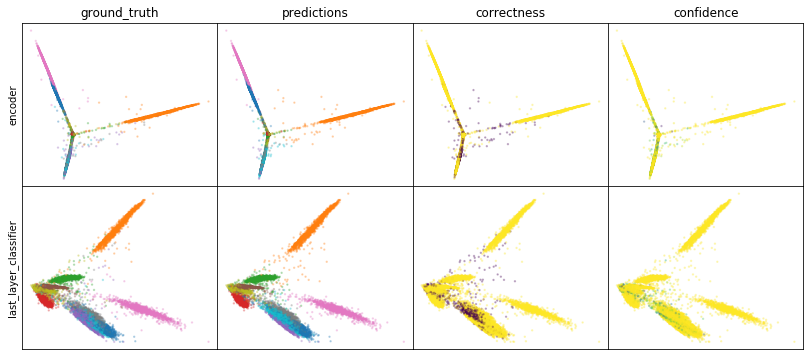

W0808 05:15:49.425328 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:15:49.708778 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:15:49.994174 140558110111488 legend.py:1282] No handles with labels found to put in legend.


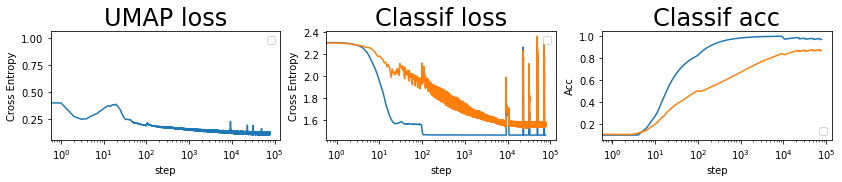

batch: 78000 | train acc: 0.9697 | val acc: 0.8674


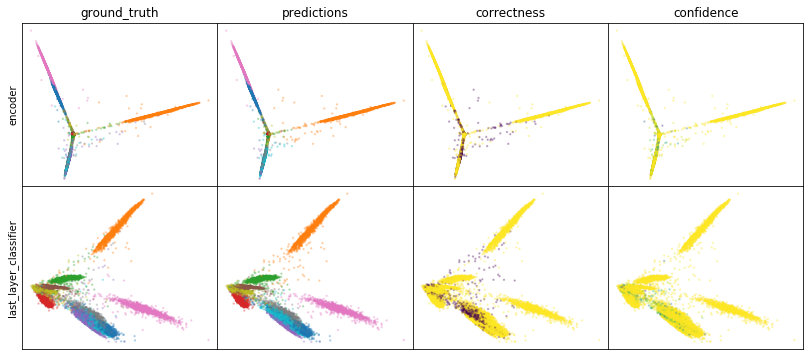

W0808 05:20:47.319425 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:20:47.590150 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:20:47.863381 140558110111488 legend.py:1282] No handles with labels found to put in legend.


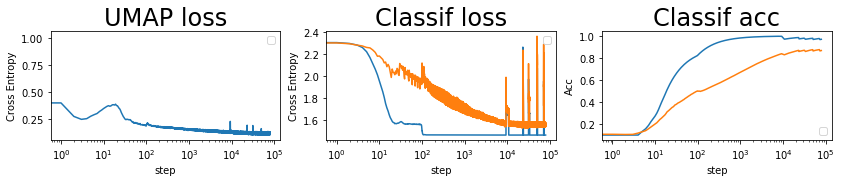

batch: 79000 | train acc: 0.9701 | val acc: 0.868


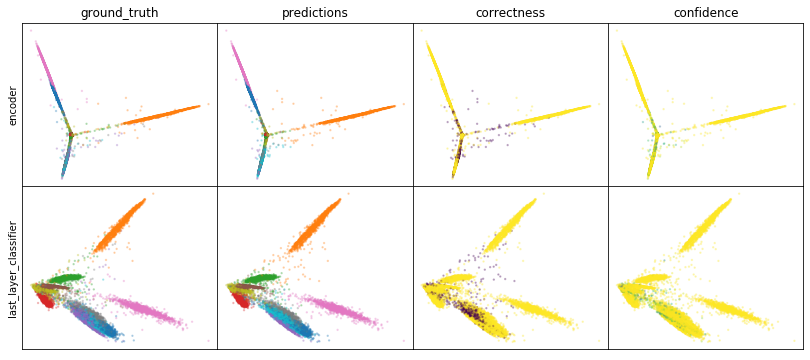

W0808 05:25:45.739475 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:25:46.041197 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:25:46.342623 140558110111488 legend.py:1282] No handles with labels found to put in legend.


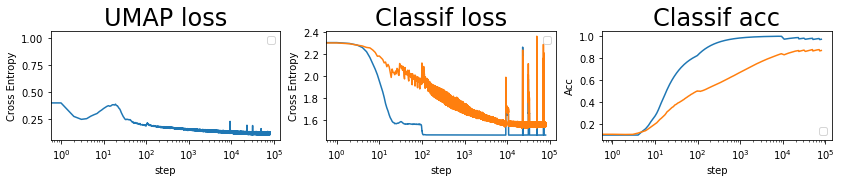

batch: 80000 | train acc: 0.9705 | val acc: 0.8685


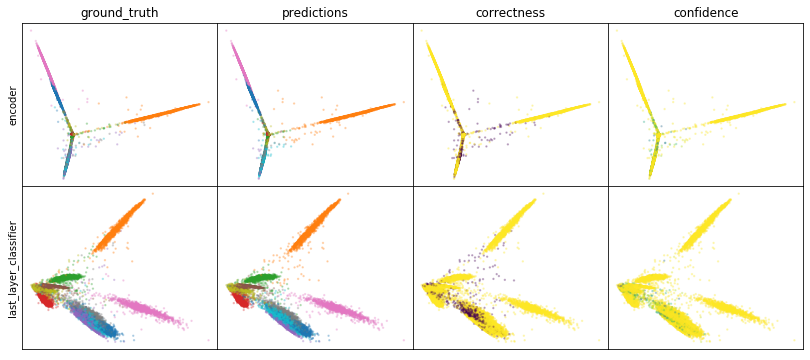

W0808 05:30:44.817350 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:30:45.095208 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:30:45.374836 140558110111488 legend.py:1282] No handles with labels found to put in legend.


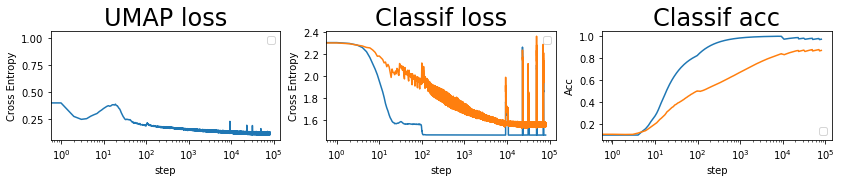

batch: 81000 | train acc: 0.9709 | val acc: 0.8691
leaving epoch because no improvement in 10000 batches


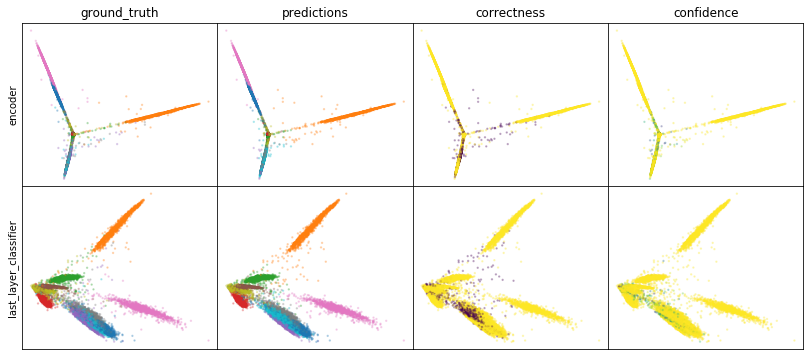

W0808 05:35:45.530984 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:35:45.816507 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:35:46.100109 140558110111488 legend.py:1282] No handles with labels found to put in legend.


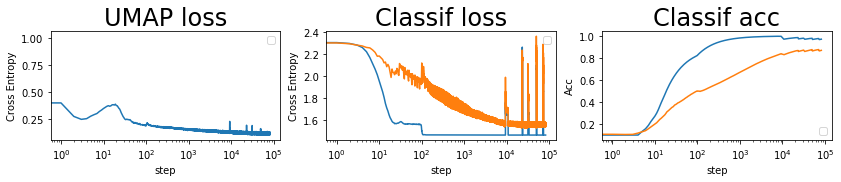

batch: 82000 | train acc: 0.9712 | val acc: 0.8697


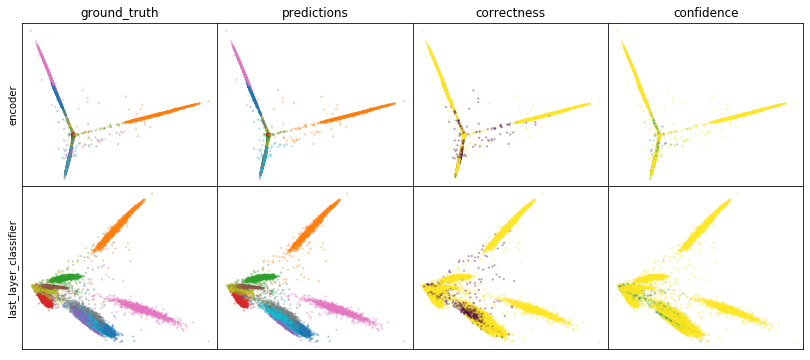

W0808 05:40:45.001796 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:40:45.313944 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:40:45.610070 140558110111488 legend.py:1282] No handles with labels found to put in legend.


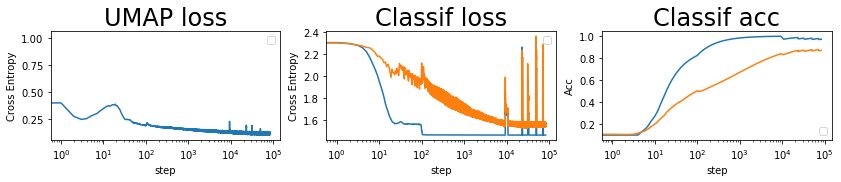

batch: 83000 | train acc: 0.9716 | val acc: 0.8702


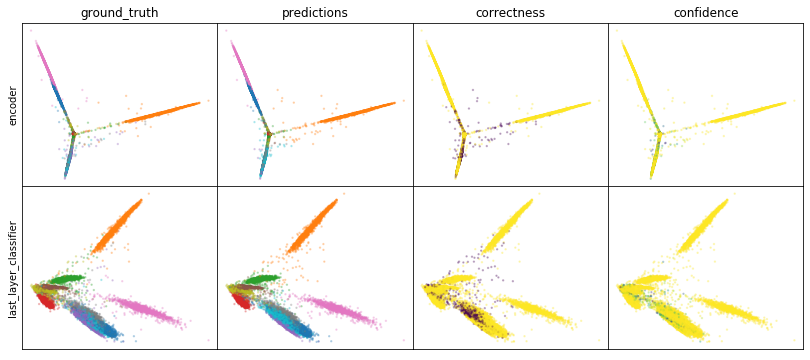

W0808 05:45:44.873641 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:45:45.150672 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:45:45.436542 140558110111488 legend.py:1282] No handles with labels found to put in legend.


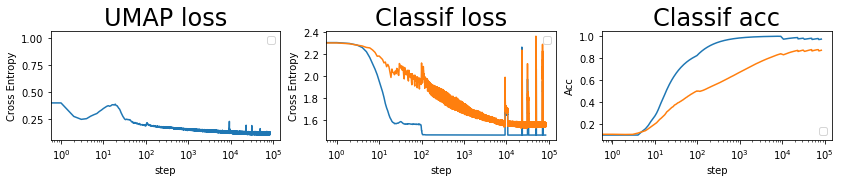

batch: 84000 | train acc: 0.9719 | val acc: 0.8707


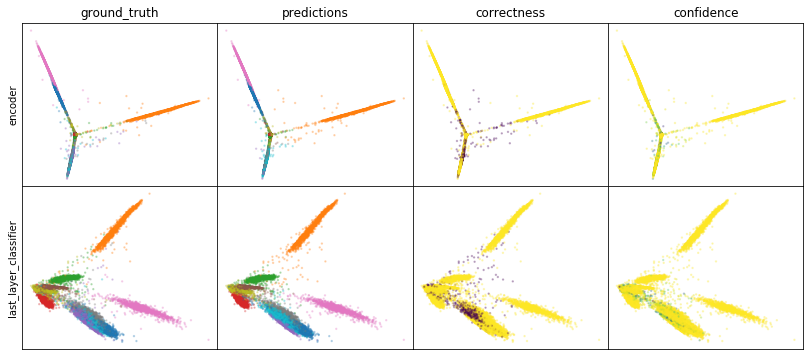

W0808 05:50:46.540669 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:50:46.829005 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:50:47.124464 140558110111488 legend.py:1282] No handles with labels found to put in legend.


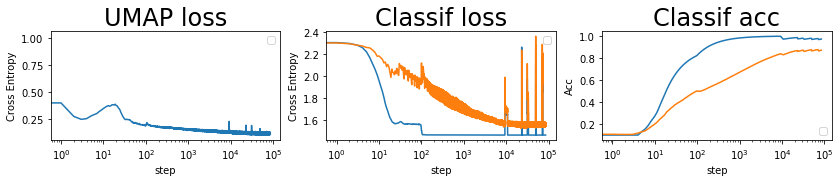

batch: 85000 | train acc: 0.9722 | val acc: 0.8711


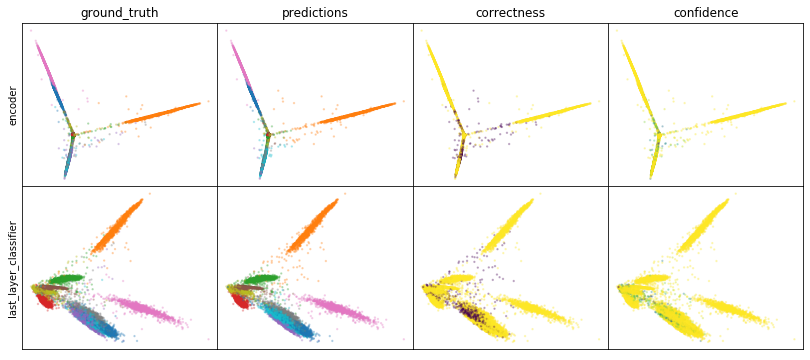

W0808 05:55:48.045960 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:55:48.347196 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 05:55:48.654867 140558110111488 legend.py:1282] No handles with labels found to put in legend.


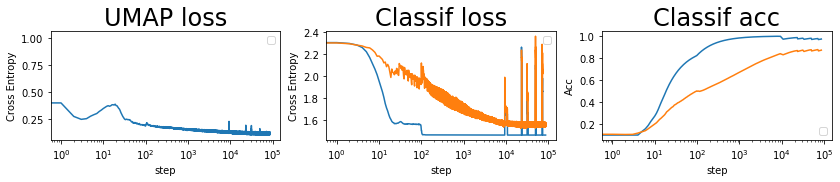

batch: 86000 | train acc: 0.9725 | val acc: 0.8716


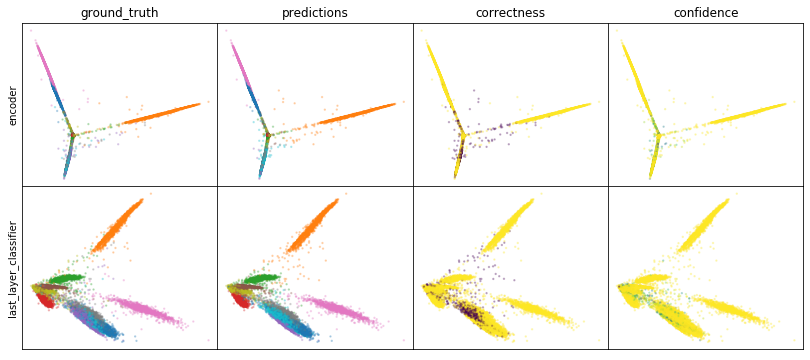

W0808 06:00:50.660856 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:00:50.959133 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:00:51.269667 140558110111488 legend.py:1282] No handles with labels found to put in legend.


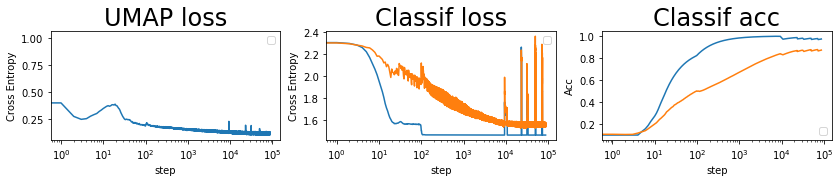

batch: 87000 | train acc: 0.9729 | val acc: 0.8721


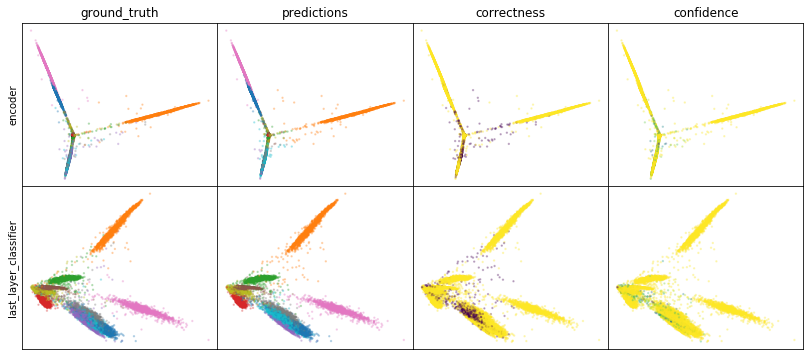

W0808 06:05:53.480944 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:05:53.786676 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:05:54.091997 140558110111488 legend.py:1282] No handles with labels found to put in legend.


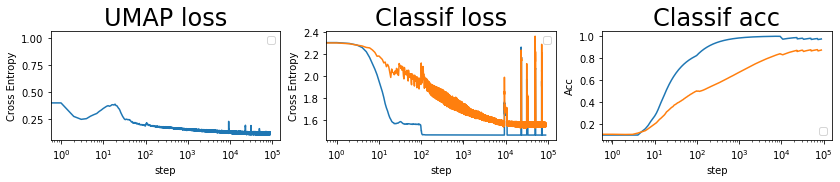

batch: 88000 | train acc: 0.9732 | val acc: 0.8725


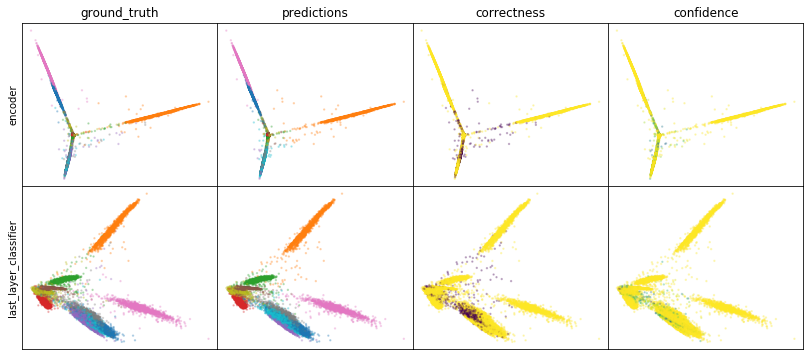

W0808 06:10:57.861006 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:10:58.166020 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:10:58.493884 140558110111488 legend.py:1282] No handles with labels found to put in legend.


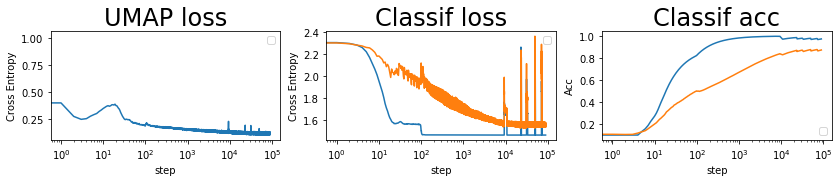

batch: 89000 | train acc: 0.9735 | val acc: 0.873


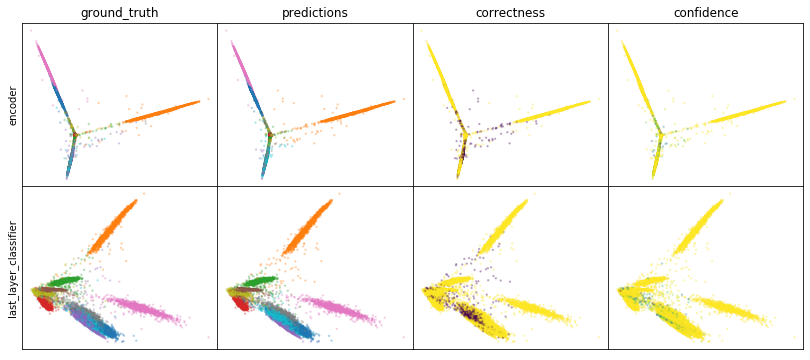

W0808 06:16:02.648483 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:16:02.961495 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:16:03.289705 140558110111488 legend.py:1282] No handles with labels found to put in legend.


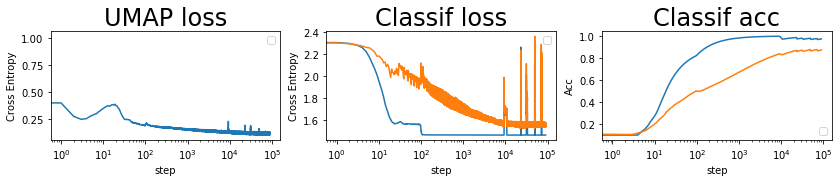

batch: 90000 | train acc: 0.9738 | val acc: 0.8734


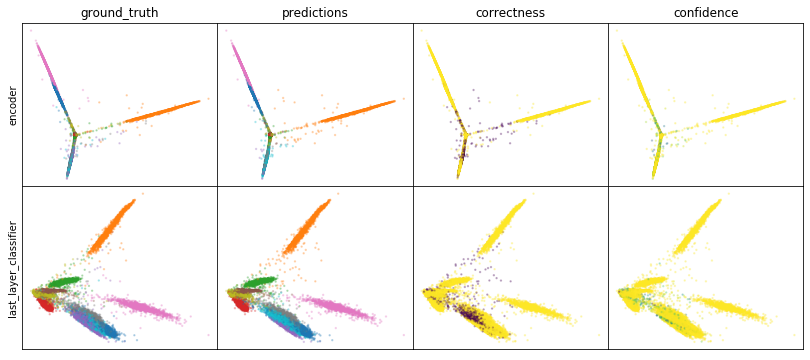

W0808 06:21:07.354112 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:21:07.653067 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:21:07.958289 140558110111488 legend.py:1282] No handles with labels found to put in legend.


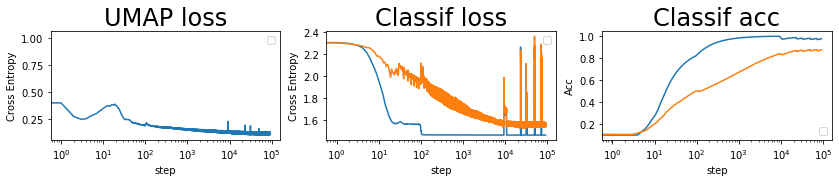

batch: 91000 | train acc: 0.9741 | val acc: 0.8739
leaving epoch because no improvement in 10000 batches


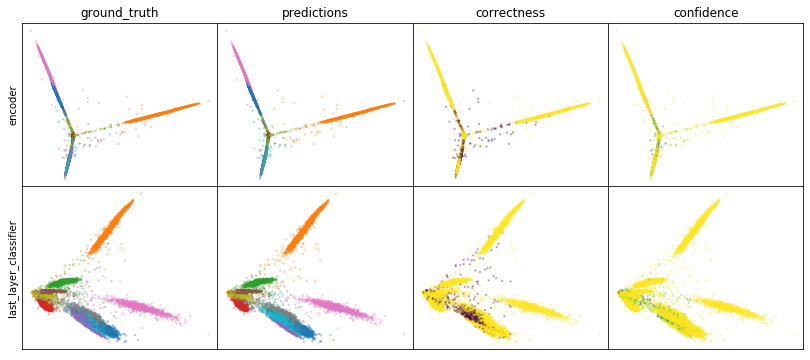

W0808 06:26:11.498475 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:26:11.811774 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:26:12.129493 140558110111488 legend.py:1282] No handles with labels found to put in legend.


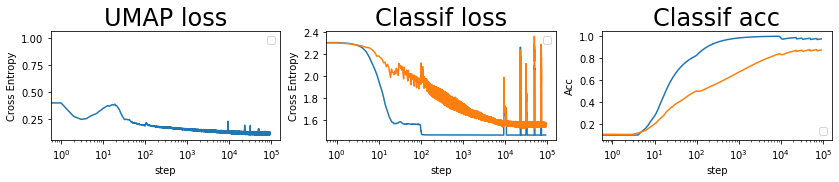

batch: 92000 | train acc: 0.9743 | val acc: 0.8743


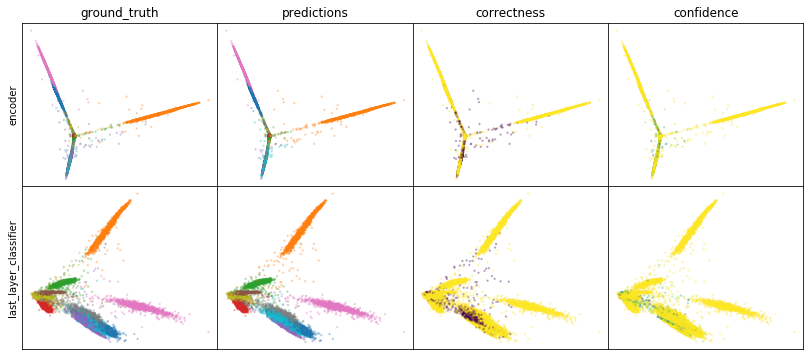

W0808 06:31:17.657012 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:31:17.980165 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:31:18.335582 140558110111488 legend.py:1282] No handles with labels found to put in legend.


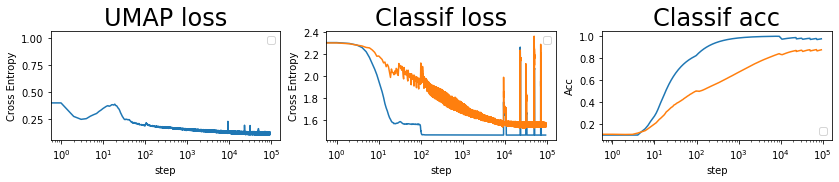

batch: 93000 | train acc: 0.9746 | val acc: 0.8747


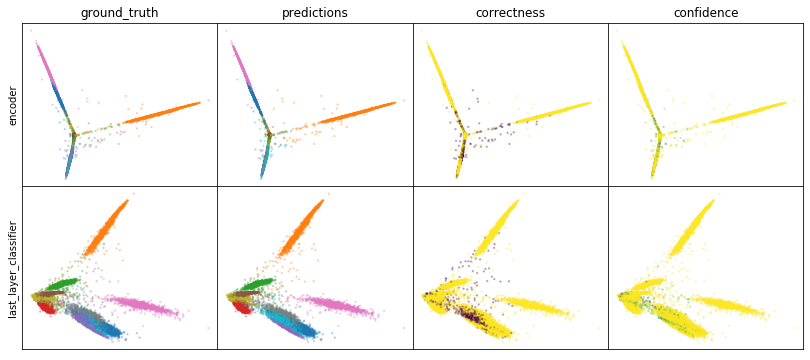

W0808 06:36:23.354429 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:36:23.663032 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:36:23.980108 140558110111488 legend.py:1282] No handles with labels found to put in legend.


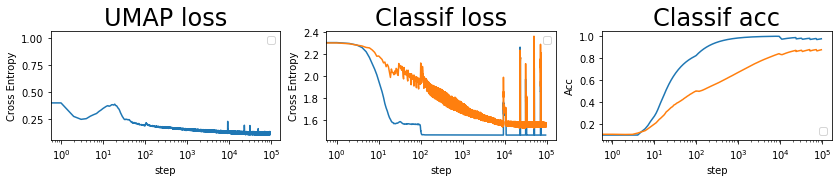

batch: 94000 | train acc: 0.9749 | val acc: 0.8752


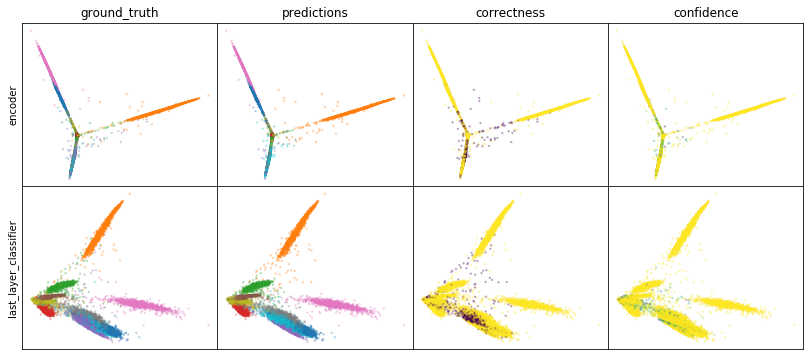

W0808 06:41:29.797277 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:41:30.115092 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:41:30.443335 140558110111488 legend.py:1282] No handles with labels found to put in legend.


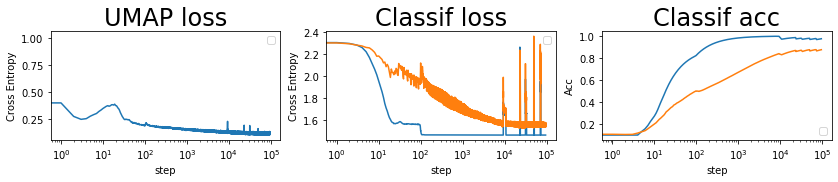

batch: 95000 | train acc: 0.9751 | val acc: 0.8756


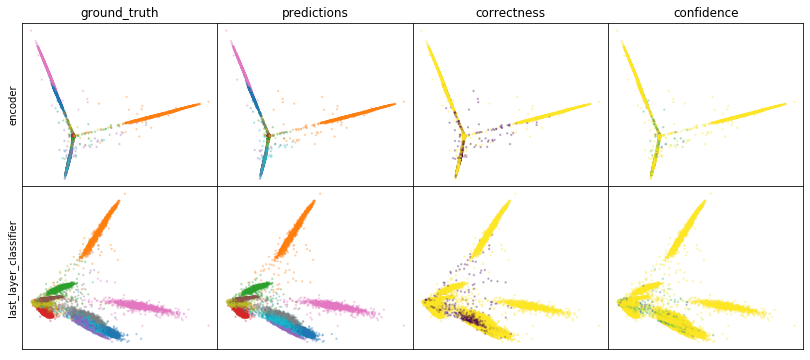

W0808 06:46:37.406973 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:46:37.729098 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:46:38.065482 140558110111488 legend.py:1282] No handles with labels found to put in legend.


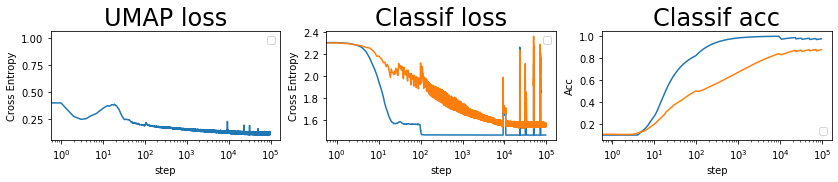

batch: 96000 | train acc: 0.9754 | val acc: 0.876


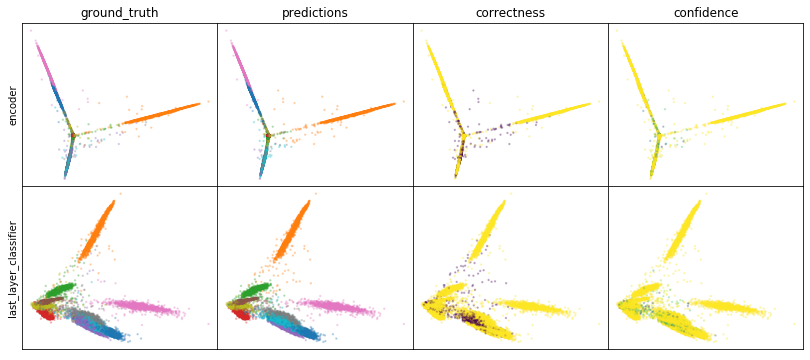

W0808 06:51:43.771265 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:51:44.087726 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:51:44.408677 140558110111488 legend.py:1282] No handles with labels found to put in legend.


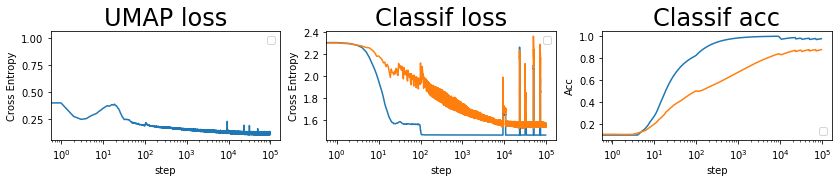

batch: 97000 | train acc: 0.9757 | val acc: 0.8764


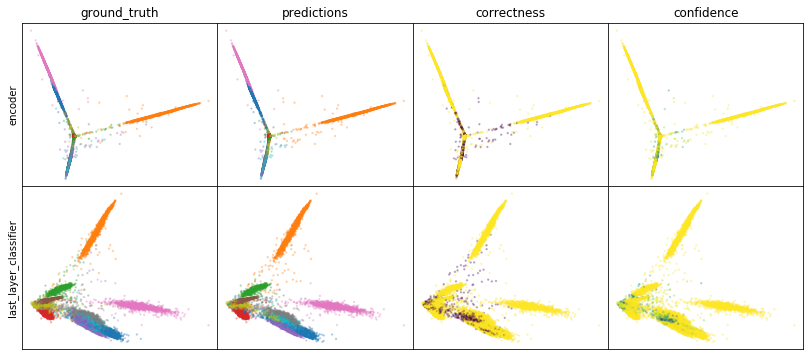

W0808 06:56:50.821659 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:56:51.146142 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 06:56:51.480594 140558110111488 legend.py:1282] No handles with labels found to put in legend.


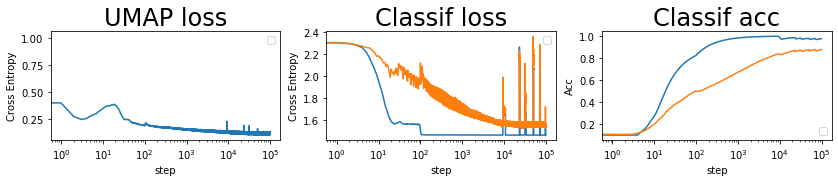

batch: 98000 | train acc: 0.9759 | val acc: 0.8766


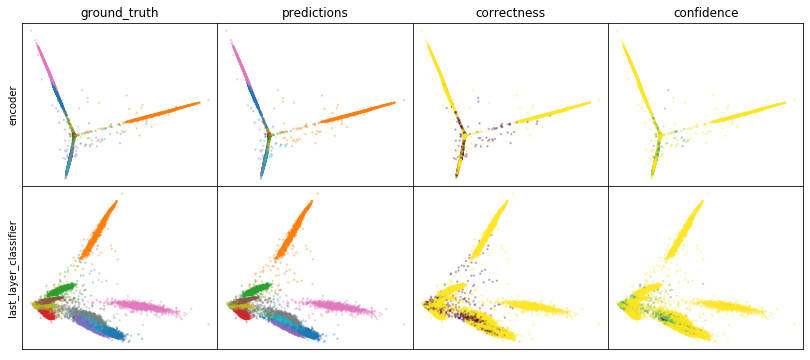

W0808 07:01:58.634319 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:01:58.979234 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:01:59.347389 140558110111488 legend.py:1282] No handles with labels found to put in legend.


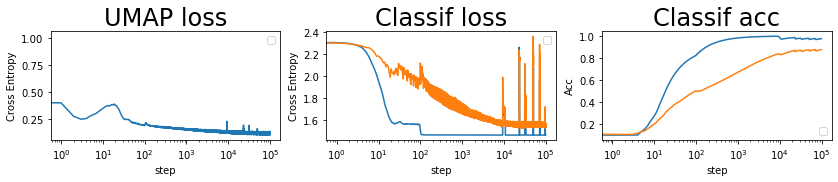

batch: 99000 | train acc: 0.9761 | val acc: 0.8769


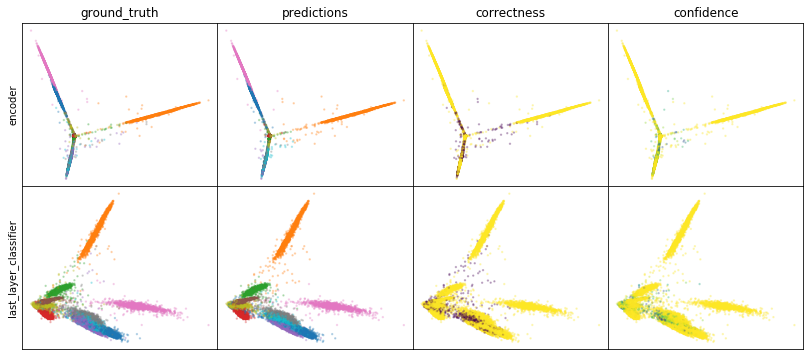

W0808 07:07:06.781054 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:07:07.103611 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:07:07.442343 140558110111488 legend.py:1282] No handles with labels found to put in legend.


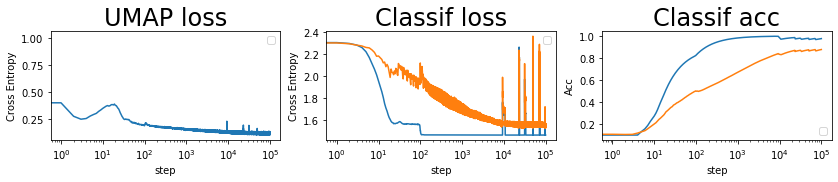

batch: 100000 | train acc: 0.9764 | val acc: 0.8772


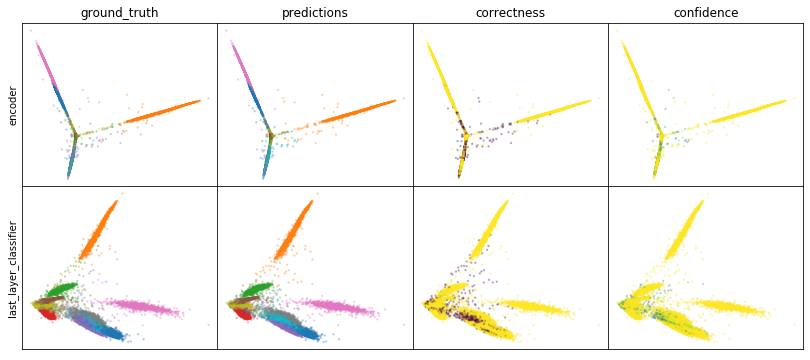

W0808 07:12:16.132679 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:12:16.484861 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:12:16.845375 140558110111488 legend.py:1282] No handles with labels found to put in legend.


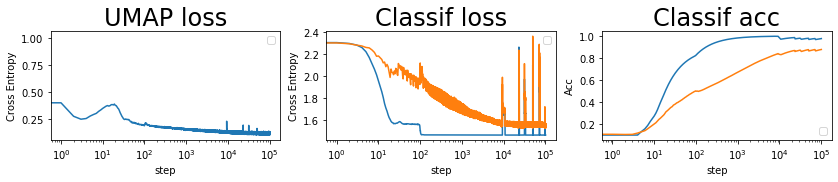

batch: 101000 | train acc: 0.9766 | val acc: 0.8775


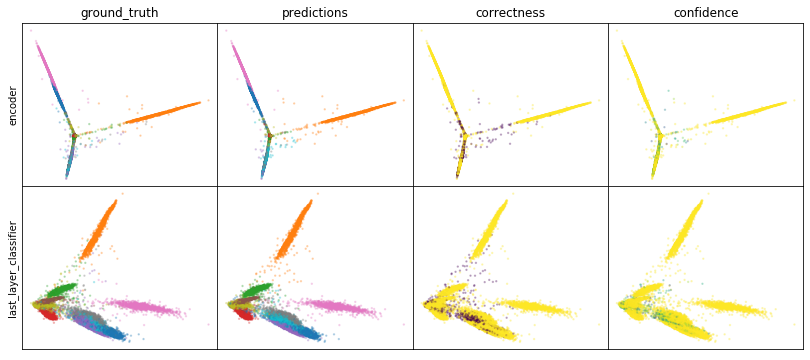

W0808 07:17:25.236302 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:17:25.575040 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:17:25.922803 140558110111488 legend.py:1282] No handles with labels found to put in legend.


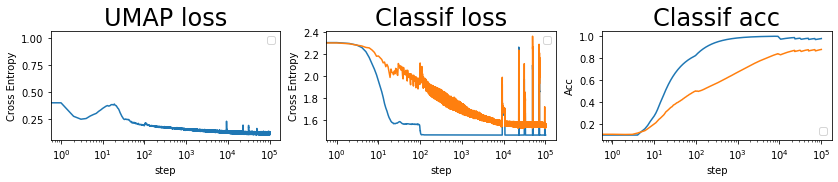

batch: 102000 | train acc: 0.9768 | val acc: 0.8778


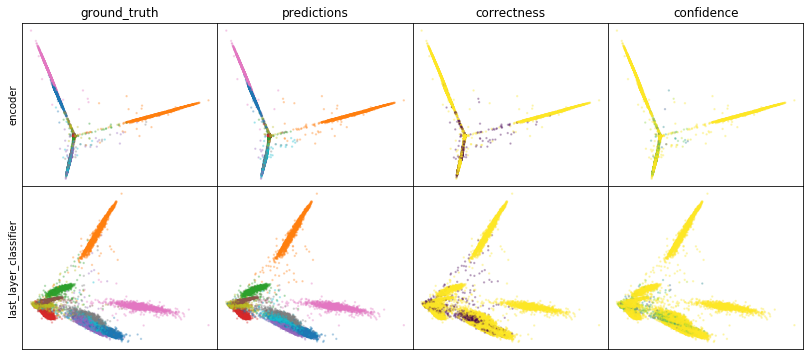

W0808 07:22:36.725300 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:22:37.078675 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:22:37.442807 140558110111488 legend.py:1282] No handles with labels found to put in legend.


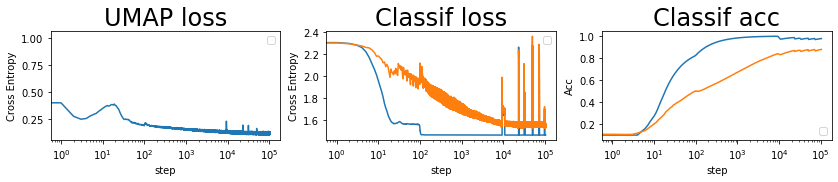

batch: 103000 | train acc: 0.9771 | val acc: 0.8782


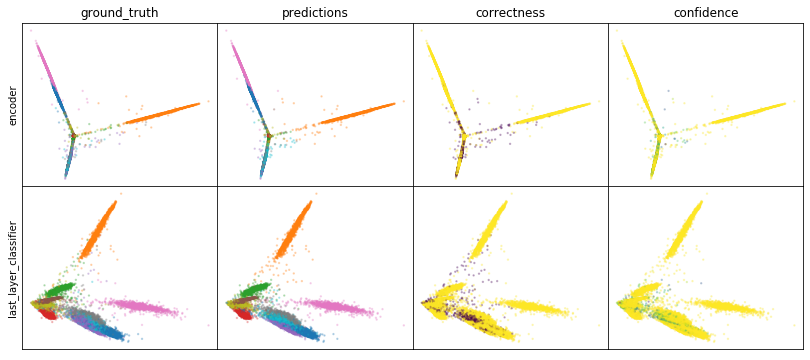

W0808 07:27:46.081030 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:27:46.439913 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:27:46.806229 140558110111488 legend.py:1282] No handles with labels found to put in legend.


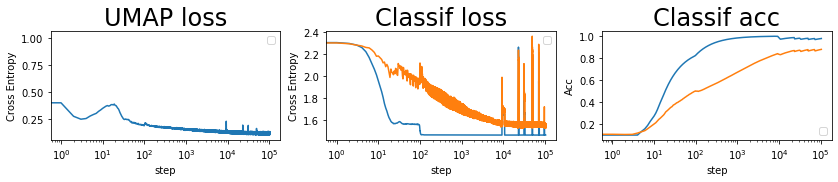

batch: 104000 | train acc: 0.9773 | val acc: 0.8785


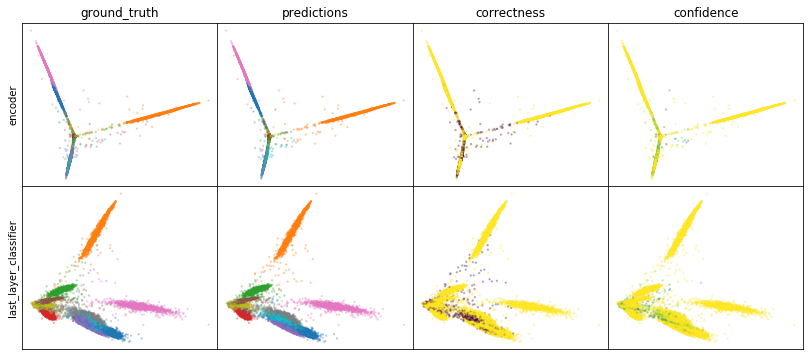

W0808 07:32:56.686264 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:32:57.028512 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:32:57.380749 140558110111488 legend.py:1282] No handles with labels found to put in legend.


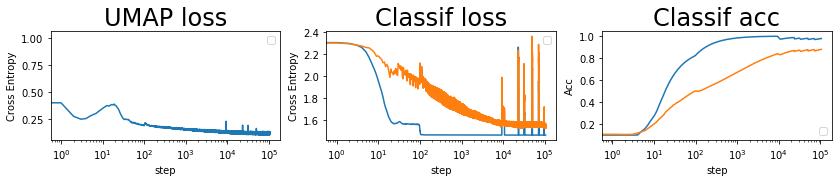

batch: 105000 | train acc: 0.9775 | val acc: 0.8789


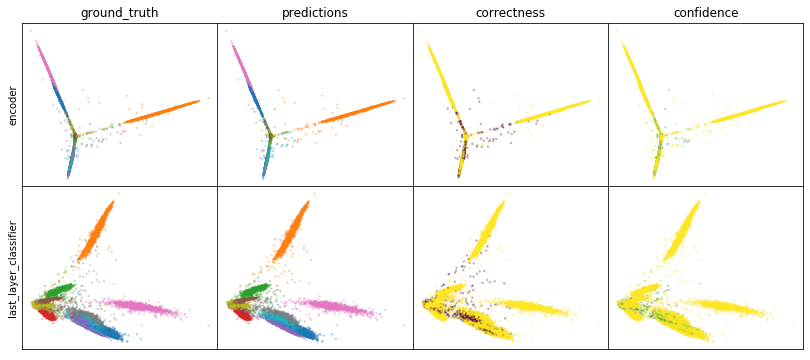

W0808 07:38:07.763473 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:38:08.154253 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:38:08.537955 140558110111488 legend.py:1282] No handles with labels found to put in legend.


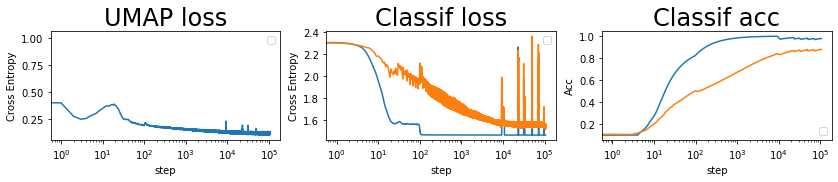

batch: 106000 | train acc: 0.9777 | val acc: 0.8792
saving weights | batch = 106318 | acc = 87.935


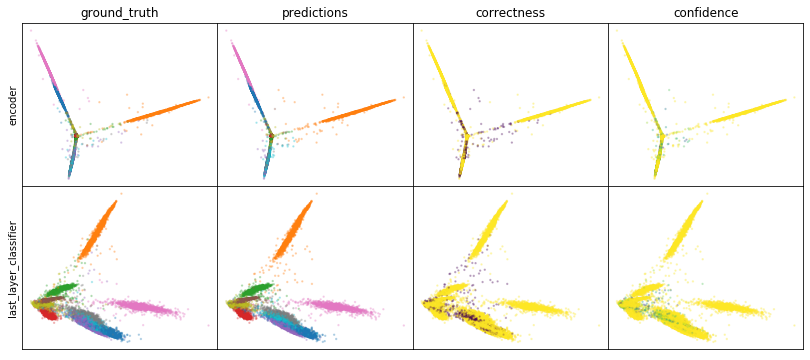

W0808 07:43:19.489007 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:43:19.843127 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:43:20.204766 140558110111488 legend.py:1282] No handles with labels found to put in legend.


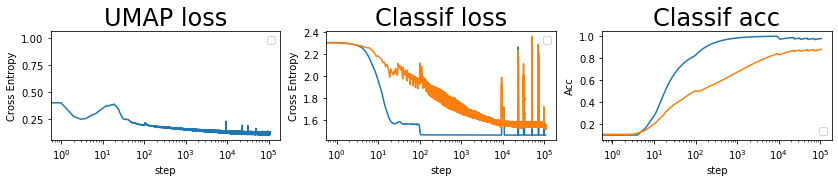

batch: 107000 | train acc: 0.9779 | val acc: 0.8796


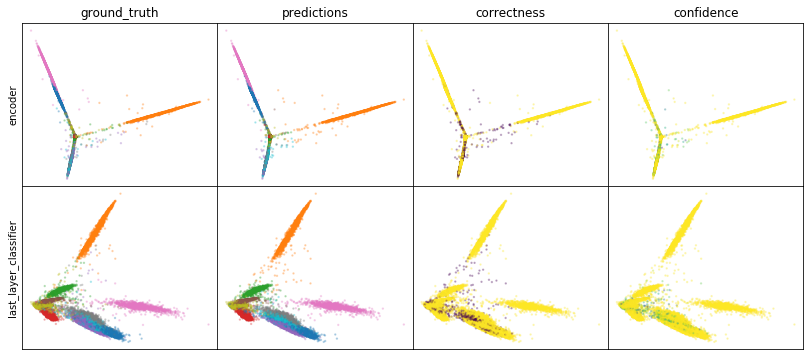

W0808 07:48:31.816717 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:48:32.172583 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:48:32.539313 140558110111488 legend.py:1282] No handles with labels found to put in legend.


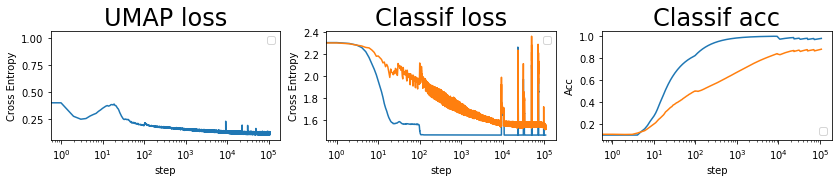

batch: 108000 | train acc: 0.9781 | val acc: 0.88


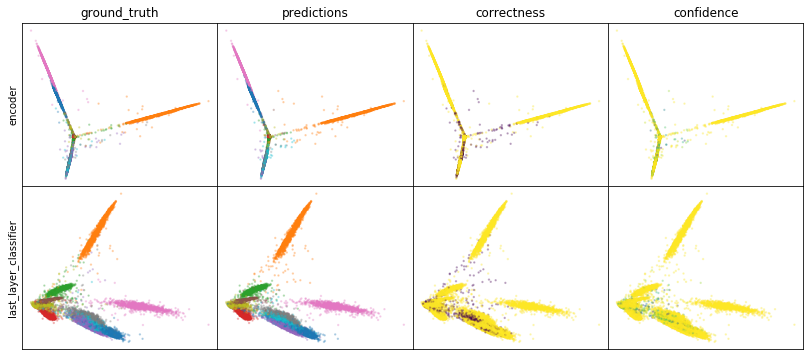

W0808 07:53:44.641326 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:53:45.014719 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:53:45.392573 140558110111488 legend.py:1282] No handles with labels found to put in legend.


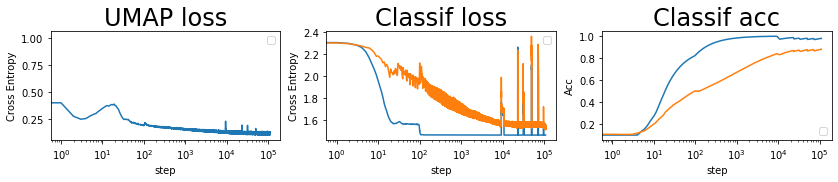

batch: 109000 | train acc: 0.9783 | val acc: 0.8804


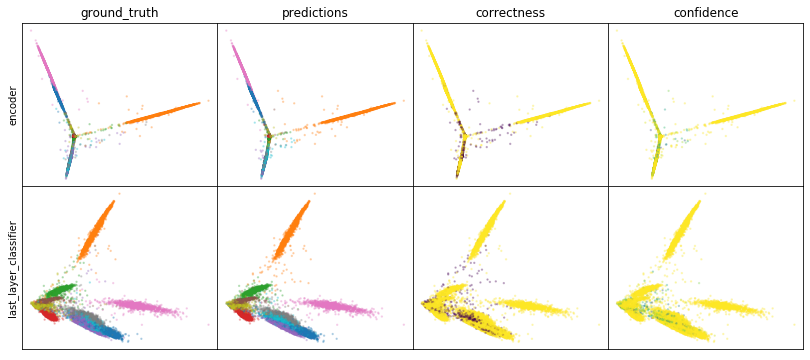

W0808 07:58:58.487178 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:58:58.849375 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 07:58:59.236155 140558110111488 legend.py:1282] No handles with labels found to put in legend.


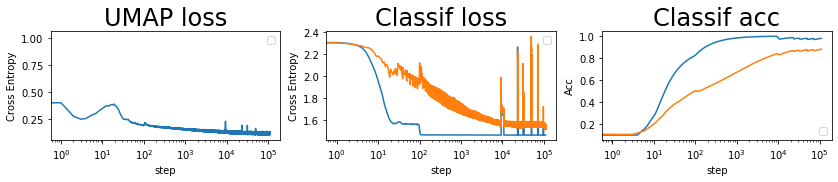

batch: 110000 | train acc: 0.9785 | val acc: 0.8808


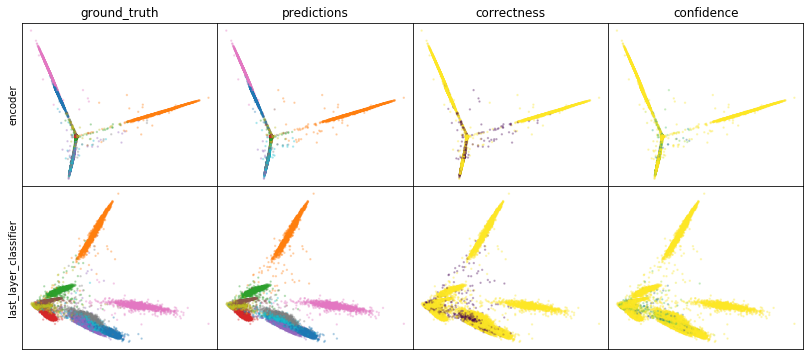

W0808 08:04:12.057810 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:04:12.444725 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:04:12.839055 140558110111488 legend.py:1282] No handles with labels found to put in legend.


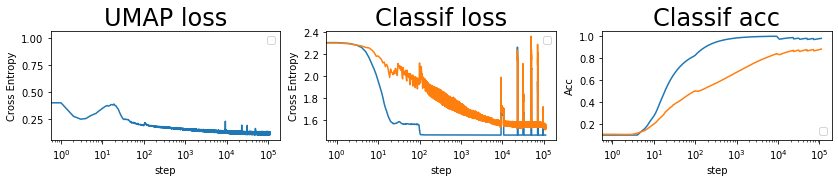

batch: 111000 | train acc: 0.9787 | val acc: 0.8812


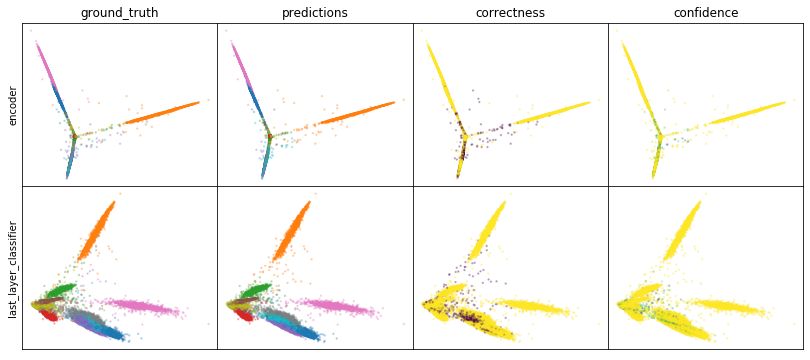

W0808 08:09:25.131099 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:09:25.541612 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:09:25.971610 140558110111488 legend.py:1282] No handles with labels found to put in legend.


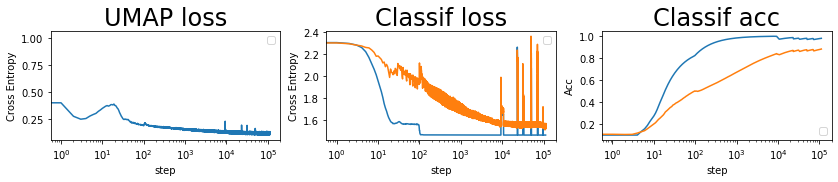

batch: 112000 | train acc: 0.9789 | val acc: 0.8816


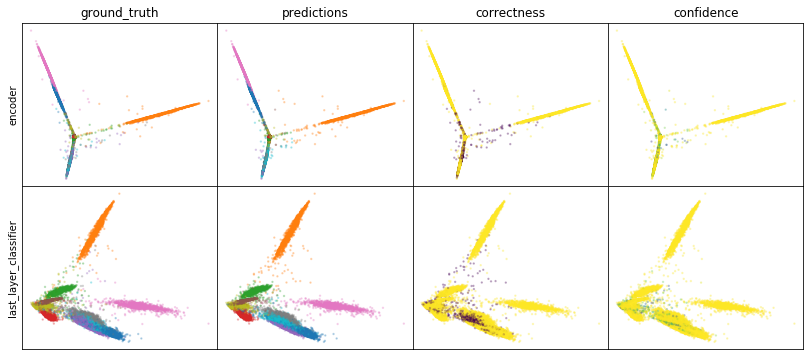

W0808 08:14:39.912873 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:14:40.289747 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:14:40.676559 140558110111488 legend.py:1282] No handles with labels found to put in legend.


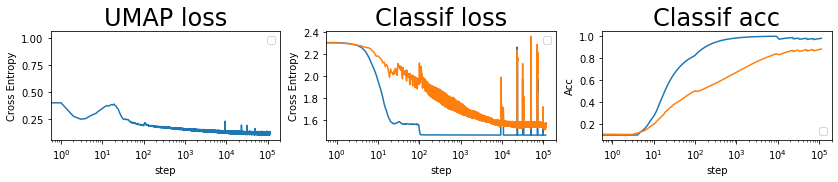

batch: 113000 | train acc: 0.9791 | val acc: 0.8819


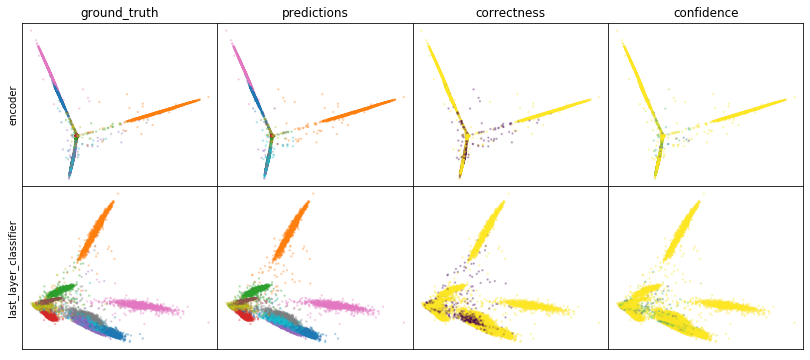

W0808 08:19:55.760538 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:19:56.138203 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:19:56.535872 140558110111488 legend.py:1282] No handles with labels found to put in legend.


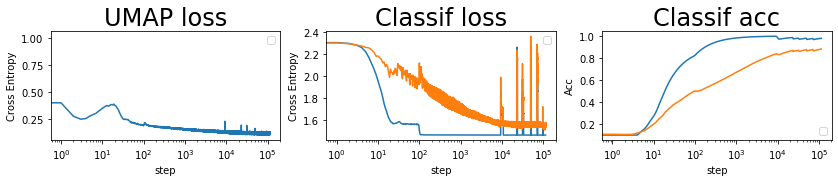

batch: 114000 | train acc: 0.9793 | val acc: 0.8822


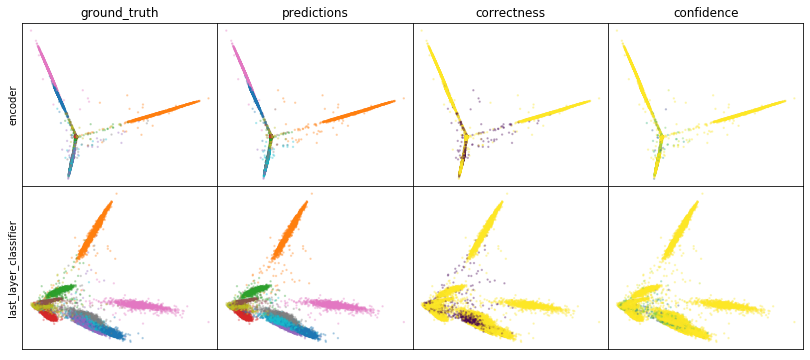

W0808 08:25:10.437924 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:25:10.812474 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:25:11.205799 140558110111488 legend.py:1282] No handles with labels found to put in legend.


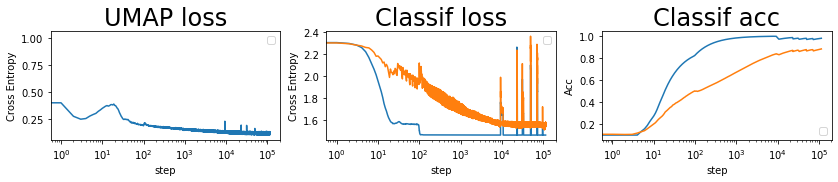

batch: 115000 | train acc: 0.9795 | val acc: 0.8825


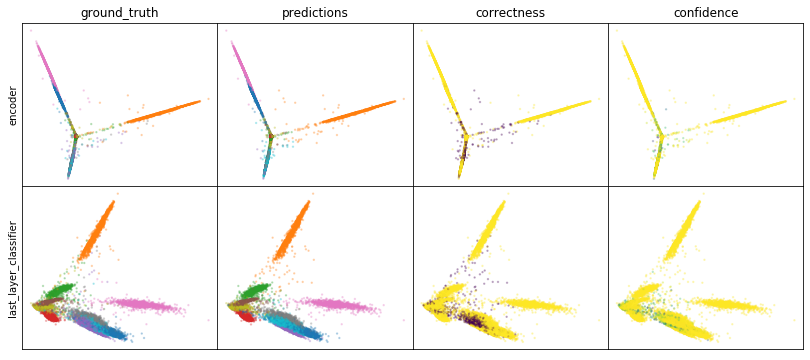

W0808 08:30:25.322531 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:30:25.715221 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:30:26.130065 140558110111488 legend.py:1282] No handles with labels found to put in legend.


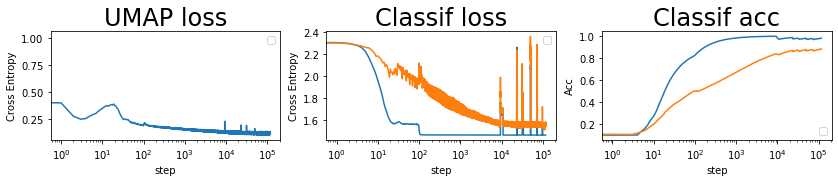

batch: 116000 | train acc: 0.9796 | val acc: 0.8827


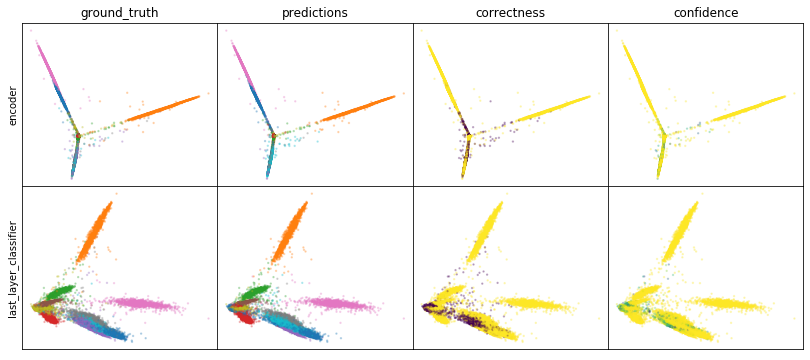

W0808 08:35:42.586766 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:35:43.003966 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:35:43.437248 140558110111488 legend.py:1282] No handles with labels found to put in legend.


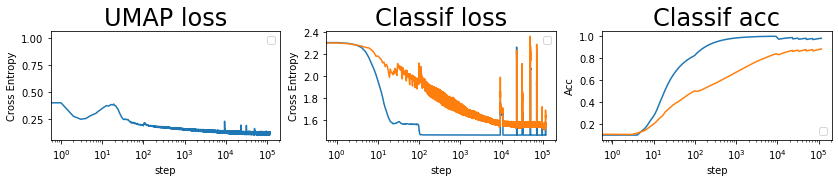

batch: 117000 | train acc: 0.9798 | val acc: 0.8827


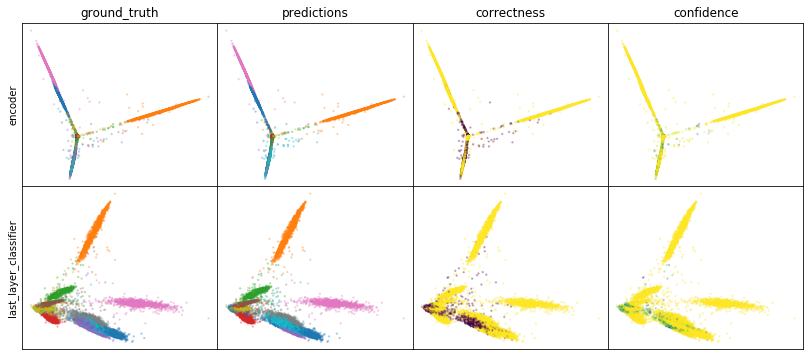

W0808 08:40:59.453130 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:40:59.858713 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:41:00.284013 140558110111488 legend.py:1282] No handles with labels found to put in legend.


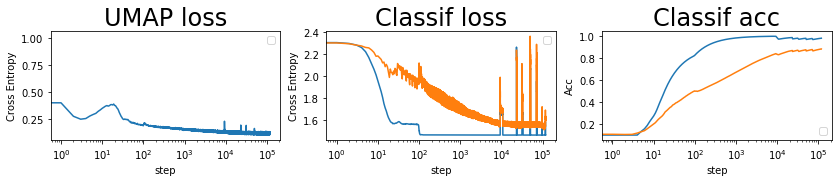

batch: 118000 | train acc: 0.98 | val acc: 0.8824


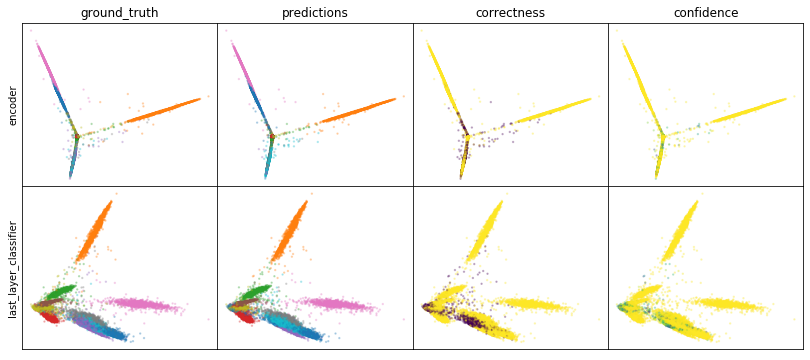

W0808 08:46:16.320299 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:46:16.742592 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:46:17.179818 140558110111488 legend.py:1282] No handles with labels found to put in legend.


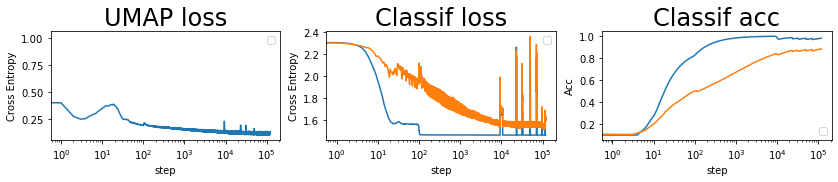

batch: 119000 | train acc: 0.9802 | val acc: 0.8821


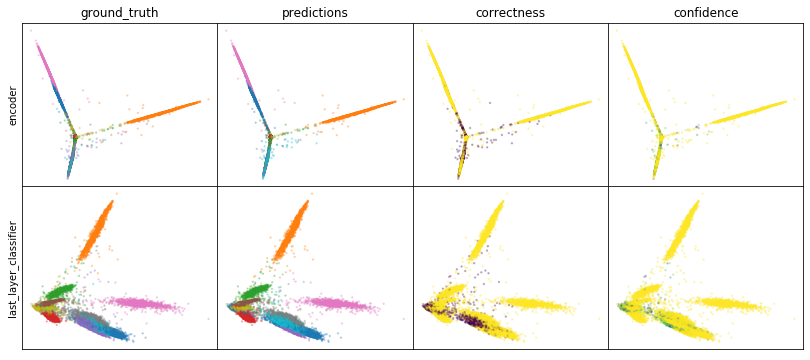

W0808 08:51:31.928718 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:51:32.323779 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:51:32.746230 140558110111488 legend.py:1282] No handles with labels found to put in legend.


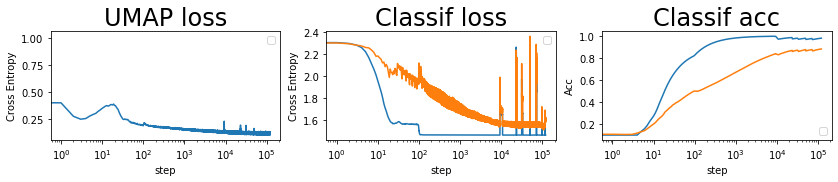

batch: 120000 | train acc: 0.9803 | val acc: 0.882


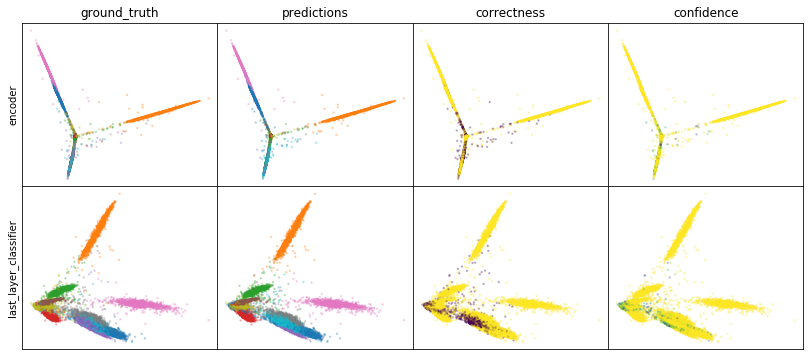

W0808 08:56:50.589696 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:56:51.010089 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 08:56:51.464796 140558110111488 legend.py:1282] No handles with labels found to put in legend.


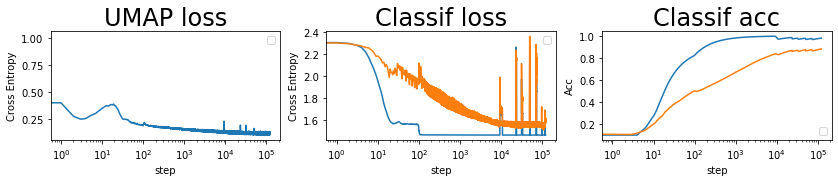

batch: 121000 | train acc: 0.9805 | val acc: 0.8818


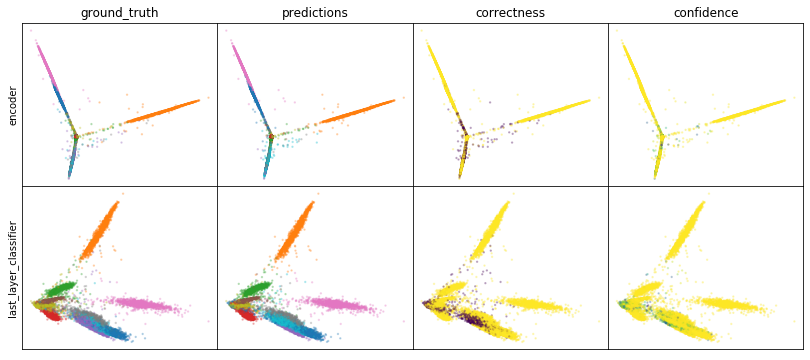

W0808 09:02:10.476792 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 09:02:10.890752 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 09:02:11.319918 140558110111488 legend.py:1282] No handles with labels found to put in legend.


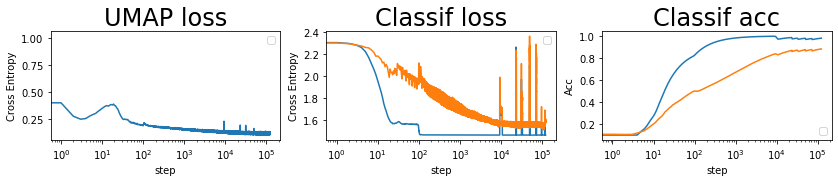

batch: 122000 | train acc: 0.9806 | val acc: 0.8818


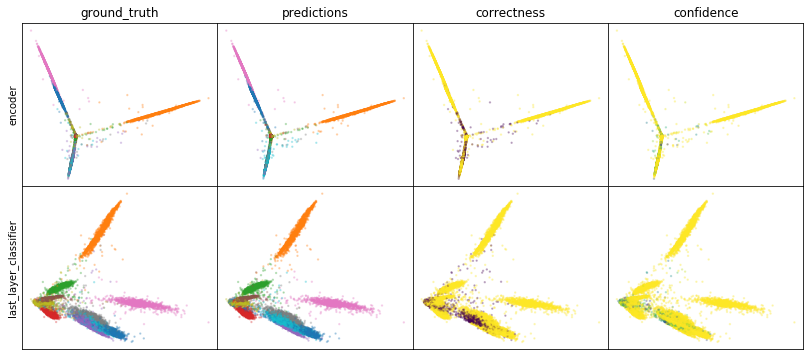

W0808 09:07:29.403789 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 09:07:29.818382 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 09:07:30.252202 140558110111488 legend.py:1282] No handles with labels found to put in legend.


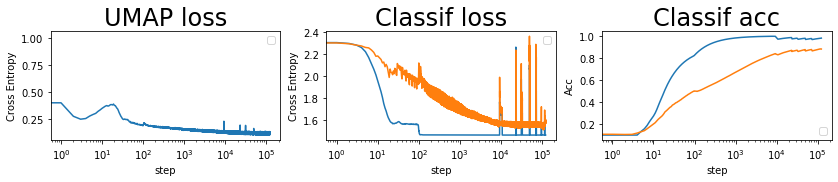

batch: 123000 | train acc: 0.9808 | val acc: 0.8817


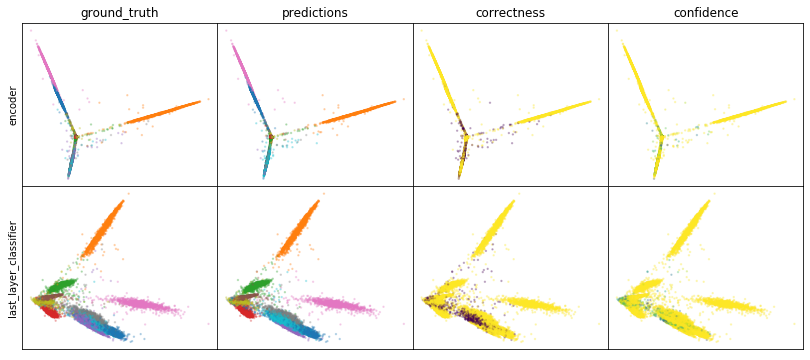

W0808 09:12:49.196929 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 09:12:49.618119 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 09:12:50.075339 140558110111488 legend.py:1282] No handles with labels found to put in legend.


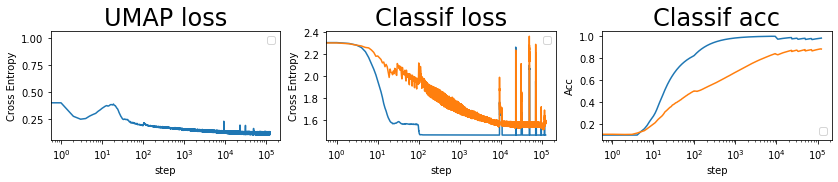

batch: 124000 | train acc: 0.981 | val acc: 0.8817


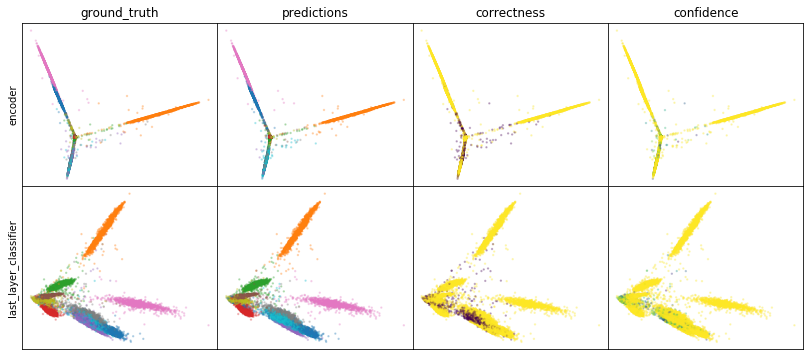

W0808 09:18:09.766171 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 09:18:10.184818 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 09:18:10.627429 140558110111488 legend.py:1282] No handles with labels found to put in legend.


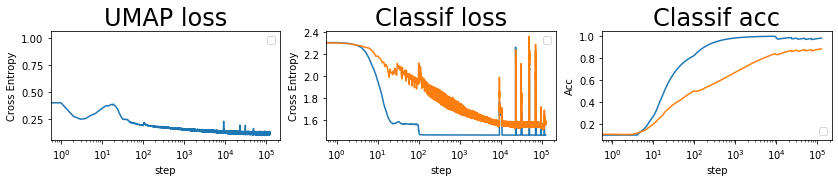

batch: 125000 | train acc: 0.9811 | val acc: 0.8818


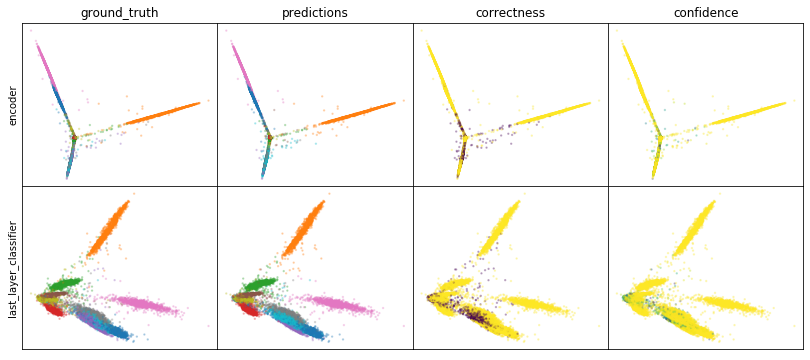

W0808 09:23:28.549305 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 09:23:28.965037 140558110111488 legend.py:1282] No handles with labels found to put in legend.
W0808 09:23:29.395830 140558110111488 legend.py:1282] No handles with labels found to put in legend.


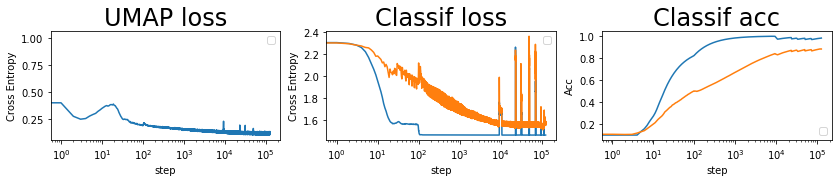

batch: 126000 | train acc: 0.9813 | val acc: 0.8819


KeyboardInterrupt: 

In [35]:
improved_this_epoch = True
for edge_epoch, epoch in tqdm(
    zip(edge_iter, np.arange(N_EPOCHS)), total=N_EPOCHS, desc="epoch"
):

    pbar = tqdm(total=BATCHES_PER_EPOCH, leave=False, desc="loss")

    for (batch_to, batch_from), (X, y), (X_val, y_val) in zip(
        edge_epoch, labeled_iter, data_valid
    ):

        # train
        (
            attraction_loss,
            repellant_loss,
            umap_loss,
            classifier_loss,
            classifier_acc,
        ) = model.train(
            batch_to=X_train[np.array(batch_to)],
            batch_from=X_train[np.array(batch_from)],
            X=X,
            y=y,
            umap_prop=umap_prop,
        )

        # compute validation loss
        val_loss, val_acc = compute_classifier_loss(
            X_val,
            y_val,
            model.encoder,
            model.classifier,
            model.sparse_ce,
            model.class_acc_val,
        )

        pbar.update()
        pbar.set_description("val acc: {}".format(str(round(val_acc.numpy(), 5))))

        # save losses
        model.write_losses(
            tf.convert_to_tensor(batch, dtype=tf.int64),
            classifier_acc,
            classifier_loss,
            umap_loss,
            val_loss,
            val_acc,
        )

        # plot results
        if batch % plot_frequency == 0:
            plot_umap_classif_results(
                model,
                X_valid,
                Y_valid,
                X_train,
                X_labeled,
                Y_labeled,
                batch_size,
                cmap="tab10",
                cmap2="tab10",
            )
            print(
                "batch: {} | train acc: {} | val acc: {}".format(
                    str(batch),
                    str(round(classifier_acc.numpy(), 4)),
                    str(round(val_acc.numpy(), 4)),
                )
            )

        # make any improvement isn't a fluke of small batch size
        if batches_since_last_reload >= reload_tolerance:

            # save if validation accuracy went up
            if val_acc > best_saved_acc + max_save_delta:
                # save weights
                print(
                    "saving weights | batch = {} | acc = {}".format(
                        batch, round(val_acc.numpy() * 100, 3)
                    )
                )
                model.encoder.save_weights((cpt_path / "encoder").as_posix())
                model.classifier.save_weights((cpt_path / "classifier").as_posix())
                best_saved_acc = val_acc.numpy()
                # save batch number
                best_saved_batch = copy.deepcopy(batch)

            # reinitialize if validation accuracy went down
            if val_acc < (best_saved_acc - max_reinitialize_delta):
                # if
                if batches_since_last_reload >= reload_tolerance:
                    batches_since_last_reload = 0
                    lr = model.optimizer.lr.numpy()
                    print(
                        "batch {} | acc = {} | learn rate = {} | reloading weights from batch {} at acc {} | n reloads = {}".format(
                            batch,
                            str(round(val_acc.numpy(), 3)),
                            lr,
                            best_saved_batch,
                            int(best_saved_acc * 100),
                            n_reloads,
                        )
                    )
                    # reload weights
                    model.encoder.load_weights((cpt_path / "encoder").as_posix())
                    model.classifier.load_weights((cpt_path / "classifier").as_posix())

                    # set new learning rate
                    model.optimizer.lr.assign(lr / 2)

                    batch += 1
                    n_reloads += 1

                    # stop if reloaded too many times
                    if n_reloads >= max_reloads:
                        break

            # if there is an imporovement, set new best score
            if val_acc > best_acc + min_delta:
                improved_this_epoch = True
                last_improvement = 0
                best_acc = val_acc
            # if the model has not improved in patience batches, end epoch
            elif last_improvement >= patience:
                last_improvement = 0
                print(
                    "leaving epoch because no improvement in {} batches".format(
                        patience
                    )
                )
                break
            else:
                last_improvement += 1

        # up the ticker
        batch += 1
        batches_since_last_reload += 1
    pbar.close()

In [36]:
test_enc = model_data(X_test, batch_size, model.encoder)
y_pred = model_data(test_enc, batch_size, model.classifier)
test_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_test, y_pred
).numpy()
print(np.mean(test_acc))

0.9003


In [37]:
np.save(cpt_path / 'test_acc.npy', test_acc)

In [39]:
pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

In [40]:
z_enc = model_data(X_train, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)
umap_class = UMAP(verbose=True).fit_transform(last_layer_class, Y_masked)
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_train
np.save(cpt_path / 'train_last_layer_class.npy', last_layer_class)
np.save(cpt_path / 'train_z_enc.npy', z_enc)
np.save(cpt_path / 'train_last_layer_class_umap.npy', umap_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Sat Aug  8 09:26:05 2020 Finding Nearest Neighbors
Sat Aug  8 09:26:05 2020 Building RP forest with 16 trees
Sat Aug  8 09:26:07 2020 parallel NN descent for 16 iterations
	 0  /  16
	 1  /  16
	 2  /  16
Sat Aug  8 09:26:33 2020 Finished Nearest Neighbor Search
Sat Aug  8 09:26:39 2020 Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Sat Aug  8 09:28:04 2020 Finished embedding


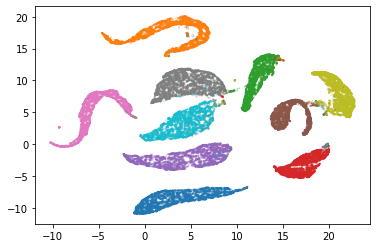

In [41]:
plt.scatter(umap_class[:,0], umap_class[:,1], c =Y_train,  cmap = plt.cm.tab10, s = 1, alpha = 0.25)

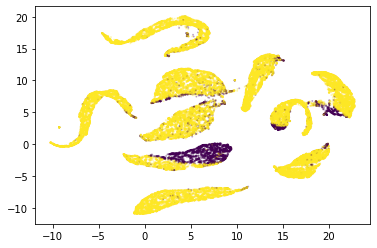

In [42]:
plt.scatter(umap_class[:,0], umap_class[:,1], c =correctness,  cmap = plt.cm.viridis, s = 1, alpha = 0.25)